# 3-Flaredown Capstone: Exploratory Data Analysis

**Author:** Sarah Gates

**Date:** September 2022

**Contact:** sarahgates2015@u.northwestern.edu

**Notebook:** 3 of 4

**Next Notebook:** 4-Gates_Flaredown Capstone_Modeling

# Table of Contents

* [1. Introduction](#intro-bullet)
    * [a. Data Dictionary]((#intro-bullet1)
    * [b. Libary and Data Loading](#intro-bullet2)
    
    <br>
* [2. Binary Classification Exploration](#first-bullet)
    * [a. Age by Target](#first-bullet1)
    * [b. Gender by Target](#first-bullet2)
    * [c. Total Logs by Target](#first-bullet3)
    * [d. Total Unique Date Days](#first-bullet4)
    * [e. Logging Rate by Target](#first-bullet5)
    * [f. Conditions Total](#first-bullet6)
    * [h. Fibromyalgia Comorbodities](#first-bullet7)
    * [i. Symptoms and Conditions](#first-bullet8)
        * [i. Condition and Symptoms Binaries](#first-bullet81)
        * [ii. Condition and Symptom Activity](#first-bullet8ii)
        * [iii. Total Logs](#first-bullet8iii)
        * [iv. Unique Date Days](#first-bullet8iv)
        * [v. Log Rate](#first-bullet8v)
        
        <br>
        
* [3. Multiclass Classification Exploration](#second-bullet)
    * [a. Age by Target](#second-bullet1)
    * [b. Gender by Target](#second-bullet2)
    * [c. Total Logs by Target](#second-bullet3)
    * [d. Total Unique Date Days](#second-bullet4)
    * [e. Logging Rate by Target](#second-bullet5)
    * [f. Conditions Total](#second-bullet6)
    * [h. Fibromyalgia Comorbodities](#seocnd-bullet7)
    * [i. Symptoms and Conditions](#second-bullet8)
        * [i. Condition and Symptoms Binaries](#second-bullet81)
        * [ii. Condition and Symptom Activity](#second-bullet8ii)
        * [iii. Total Logs](#second-bullet8iii)
        * [iv. Unique Date Days](#second-bullet8iv)
        * [v. Log Rate](#second-bullet8v)

<br>

* [4. Summaries and Conclustions](#third-bullet)
    


# 1. Introduction<a class="anchor" id="intro-bullet"></a>

In the previous notebook, I concluded the data aggregation and feature engineering. There, I created several features representing biographical, disease, and app usage rates for each user. In this notebook, I sysematically investigate each of the constructed features, separated along the target dimension (binary, multiclass) in order to gain insights into which variable subsets and features will be important predictors in the machine learning modeling, which takes place in the next, and final notebook.

In the first section of this notebook, I examine each feature for the binary classification dataset, split by fibromyalgia status (0 | 1). I then repeat this process for the multiclassification dataset. I conclude by highlighting the key insights.

## a. Data Dictionary<a class="anchor" id="intro-bullet1"></a>

| Feature Name                           | Feature Description                                                                                                                                                |
| -------------------------------------- | ------------------------------------------------------------------------------------------------------------------------------------------------------------------ |
| Age                                    | The age of the user, integer format                                                                                                                                |
| Country                                | The country of the user, string format                                                                                                                             |
| Gender                                 | The gender of the user (female, male, other), string format                                                                                                        |
| Total Logs                             | The total logs made by the user in the app (total number of rows for each user), integer format                                                                    |
| Total Unique Log Dates Days            | The total number of unique dates for each user, integer format                                                                                                     |
| Total Log Rate                         | The logging frequency for each user, calculated as the total number of logs divided by the number of unique dates , float format                                   |
| Conditions Total                       | The total number of unique conditions logged, integer format                                                                                                       |
| Symptoms Total                         | The total number of unique symptoms logged, integer format                                                                                                         |
| Target                                 | The dependent variable: Binary Classification (Other: 0, Fibromyalgia: 1), Multiclass Classification (POTS: 1, Lupus: 2, Autoimmune Arthritis: 3) |
| {Condition/Symptom}                    | Indicates if the user has that symptom or condition (No: 0, Yes: 1)                                                                                                |
| {Condition/Symptom} Total Logs         | The total logs for that particular symptom or condition, integer format                                                                                            |
| {Condition/Symptom} Activity           | The median trackable value for that symptom or condition, ranging from 0 (inactive) to 4 (highly active), integer format                                           |
| {Condition/Symptom} Unique Dates Days  | The total number of unique logging dates for that particular symptom or condition, integer format                                                                  |
| {Condition/Symptom} Log Rate           | The logging frequency for that particular symptom or condition,  calculated as the total number of logs divided by the number of unique dates , float format       |

## b. Library and Data Loading<a class="anchor" id="intro-bullet2"></a>

In [84]:
import warnings
warnings.filterwarnings('ignore')

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

Leading the binary classification dataset:

In [85]:
df_binary = pd.read_csv('data/chronic_agg_fibro_binary.csv', index_col='Unnamed: 0')

df_binary.head(5)

,ids,age,gender,country,target,total_logs,total_unique_dates_days,total_log_rate,conditions_total,fibro_comorbidities,...,nerve_pain,nerve_pain_total_logs,nerve_pain_activity,nerve_pain_unique_dates_days,nerve_pain_log_rate,menstrual_cramps,menstrual_cramps_total_logs,menstrual_cramps_activity,menstrual_cramps_unique_dates_days,menstrual_cramps_log_rate
0,14,24,female,US,1,7,1,7.000000,2,0,...,0,0,0,0,0.0,0,0,0,0,0.0
1,17,33,female,US,1,18,2,9.000000,3,0,...,0,0,0,0,0.0,0,0,0,0,0.0
2,78,29,female,US,1,16,3,5.333333,3,1,...,0,0,0,0,0.0,0,0,0,0,0.0
3,96,28,other,US,1,35,4,8.750000,3,2,...,0,0,0,0,0.0,0,0,0,0,0.0
4,126,45,female,US,1,160,8,20.000000,6,1,...,0,0,0,0,0.0,0,0,0,0,0.0


In [3]:
df_binary.target.value_counts()

0    13753
1     6960
Name: target, dtype: int64

In [4]:
df_binary.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 20713 entries, 0 to 20712
Columns: 341 entries, ids to menstrual_cramps_log_rate
dtypes: float64(67), int64(272), object(2)
memory usage: 54.0+ MB


In [5]:
df_binary.shape

(20713, 341)

Loading in multiclass:

In [86]:
df_multi = pd.read_csv('data/chronic_agg_multiclass.csv', index_col='Unnamed: 0')

df_multi.head(5)

,ids,age,gender,country,target,total_logs,total_unique_dates_days,total_log_rate,conditions_total,fibro_comorbidities,...,mouth_ulcers,mouth_ulcers_total_logs,mouth_ulcers_activity,mouth_ulcers_unique_dates_days,mouth_ulcers_log_rate,blood_pooling,blood_pooling_total_logs,blood_pooling_activity,blood_pooling_unique_dates_days,blood_pooling_log_rate
0,16,42,male,CL,3,5,1,5.0,2,0,...,0,0,0,0,0.0,0,0,0,0,0.0
1,37,46,female,US,3,13,5,2.6,1,1,...,0,0,0,0,0.0,0,0,0,0,0.0
2,137,25,female,SE,3,80,8,10.0,4,0,...,0,0,0,0,0.0,0,0,0,0,0.0
3,140,20,female,US,3,12,1,12.0,1,0,...,0,0,0,0,0.0,0,0,0,0,0.0
4,322,31,female,US,3,42,6,7.0,1,0,...,0,0,0,0,0.0,0,0,0,0,0.0


In [7]:
df_multi.target.value_counts()

1    2217
3    1615
2    1275
Name: target, dtype: int64

In [8]:
df_multi.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5107 entries, 0 to 5106
Columns: 456 entries, ids to blood_pooling_log_rate
dtypes: float64(90), int64(364), object(2)
memory usage: 17.8+ MB


In [9]:
df_multi.shape

(5107, 456)

# 2. Binary Classification Exploration<a class="anchor" id="first-bullet"></a>

In [10]:
df_binary.shape

(20713, 341)

## a. Age by Target<a class="anchor" id="first-bullet1"></a>

Want to examine age by fibromyalgia status: seems like fibro users are slight older than nonfibro

In [11]:
df_binary.groupby(by='target').age.mean()

target
0    32.237984
1    35.309052
Name: age, dtype: float64

Describe:

In [12]:
df_binary.groupby(by='target').age.describe()

,count,mean,std,min,25%,50%,75%,max
target,,,,,,,,
0,13753.0,32.237984,9.906816,18.0,25.0,31.0,37.0,80.0
1,6960.0,35.309052,10.563436,18.0,27.0,34.0,42.0,76.0


Visualize:

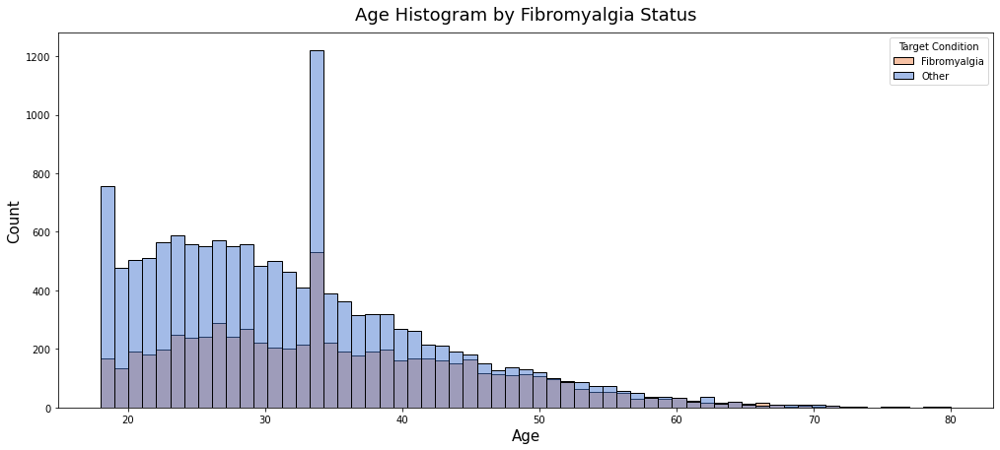

In [13]:
plt.figure(figsize=(17,7))
sns.histplot(x='age', hue='target', data=df_binary, palette="muted")
plt.legend(title='Target Condition', labels=['Fibromyalgia', 'Other'])
plt.title('Age Histogram by Fibromyalgia Status', size=18, pad=13)
plt.xlabel('Age', size=15)
plt.ylabel('Count', size=15)
plt.show()

You can really see where the median ages were added in (34). The fibro and nonfibro distributions get close together around 40-60 years of age. If the amounts were to remain constistent throughout, then the distances between the groups would be the same throughout. This suggests that fibro users are older, such that age may be a predictor of diagnosis.

## b. Gender by Target<a class="anchor" id="first-bullet2"></a>

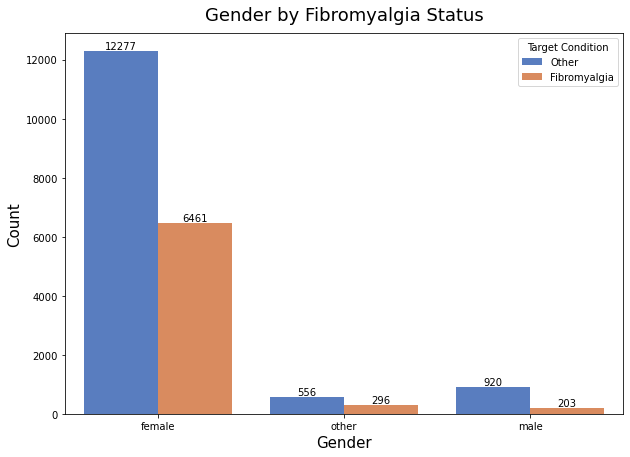

In [82]:
plt.figure(figsize=(10,7))
ax = sns.countplot(data=df_binary, x='gender', hue='target', palette="muted")
plt.title('Gender by Fibromyalgia Status', size=18, pad=13)
plt.xlabel('Gender', size=15)
plt.ylabel('Count', size=15)
plt.legend(title='Target Condition', labels=['Other', 'Fibromyalgia'])
for container in ax.containers:
        ax.bar_label(container)
plt.show()

I think nonbinary gender (other) may be predictive of fibromyalgia as the nonfibro and fibro groups are fairly even there. Female gender should also be predictive, but there are so many in the dataset, it may not be.

## c. Total Logs<a class="anchor" id="first-bullet3"></a>

Describe:

In [15]:
df_binary.groupby(by='target').total_logs.describe()

,count,mean,std,min,25%,50%,75%,max
target,,,,,,,,
0,13753.0,93.850651,415.995108,1.0,6.0,12.0,41.0,15630.0
1,6960.0,86.394109,378.236374,1.0,6.0,12.0,40.0,12002.0


Total Logs does not look like it will be predictive of fibromyalgia:

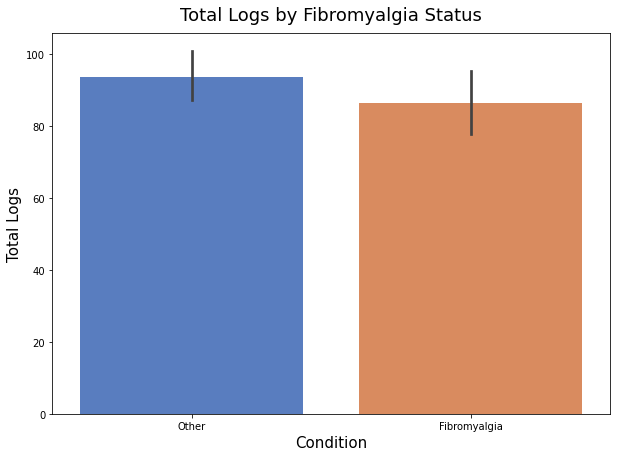

In [97]:
plt.figure(figsize=(10,7))
ax =sns.barplot(data=df_binary, x='target', y='total_logs', palette='muted')
plt.xticks((0,1), labels=['Other', 'Fibromyalgia'])
plt.xlabel('Condition', size=15)
plt.ylabel('Total Logs', size=15)
plt.title('Total Logs by Fibromyalgia Status', size=18, pad=13)

plt.show()

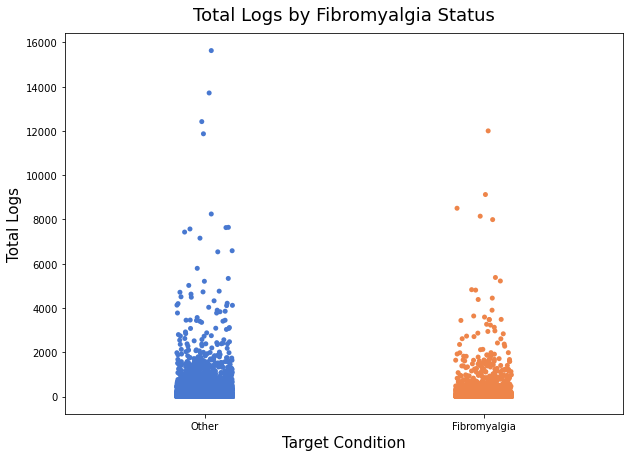

In [17]:
plt.figure(figsize=(10,7))
sns.stripplot(data=df_binary, x='target', y='total_logs', palette='muted')
plt.xticks((0,1), labels=['Other', 'Fibromyalgia'])
plt.xlabel('Target Condition', size=15)
plt.ylabel('Total Logs', size=15)
plt.title('Total Logs by Fibromyalgia Status', size=18, pad=13)
plt.show()

## d. Total Unique Dates Days<a class="anchor" id="first-bullet4"></a>

Describe:

In [18]:
df_binary.groupby(by='target').total_unique_dates_days.describe()

,count,mean,std,min,25%,50%,75%,max
target,,,,,,,,
0,13753.0,11.199302,41.679637,1.0,1.0,2.0,6.0,1612.0
1,6960.0,9.141379,33.889339,1.0,1.0,2.0,5.0,1136.0


Total Unique dates is not predictive of fibromyalgia, fibro users haven't logged for more time than nonfibro:

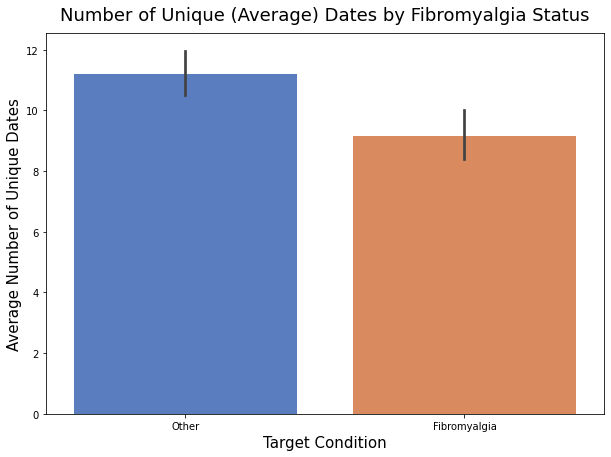

In [19]:
plt.figure(figsize=(10,7))
sns.barplot(data=df_binary, x='target', y= 'total_unique_dates_days', palette='muted')
plt.xticks((0,1), labels=['Other', 'Fibromyalgia'])
plt.xlabel('Target Condition', size=15)
plt.ylabel('Average Number of Unique Dates', size=15)
plt.title('Number of Unique (Average) Dates by Fibromyalgia Status', size=18, pad=13)
plt.show()

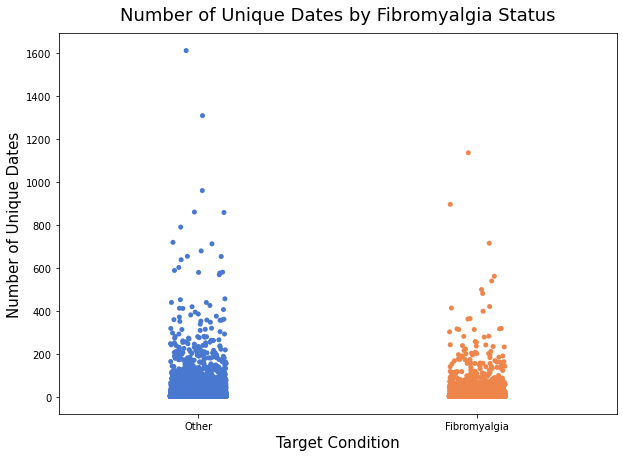

In [20]:
plt.figure(figsize=(10,7))
sns.stripplot(data=df_binary, x='target', y= 'total_unique_dates_days', palette='muted')
plt.xticks((0,1), labels=['Other', 'Fibromyalgia'])
plt.xlabel('Target Condition', size=15)
plt.ylabel('Number of Unique Dates', size=15)
plt.title('Number of Unique Dates by Fibromyalgia Status', size=18, pad=13)
plt.show()

## e. Logging Rate<a class="anchor" id="first-bullet5"></a>

In [92]:
df_binary.groupby(by='target').total_log_rate.describe()

,count,mean,std,min,25%,50%,75%,max
target,,,,,,,,
0,13753.0,6.780880,4.296967,1.0,4.0,6.0,8.666667,53.5
1,6960.0,7.306488,4.865230,1.0,4.0,6.0,9.666667,53.0


Logging rate does seem to be predictive! Fibro users have a higher M = 7.3 and sd = 4.85!

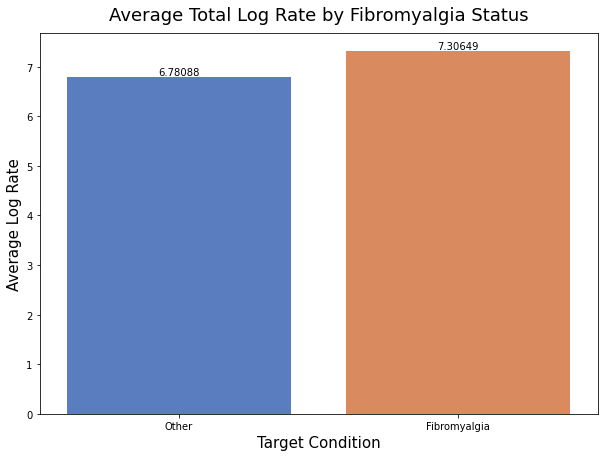

In [99]:
plt.figure(figsize=(10,7))
ax = sns.barplot(data=df_binary, x='target', y= 'total_log_rate', palette='muted', ci=None)
plt.xticks((0,1), labels=['Other', 'Fibromyalgia'])
plt.xlabel('Target Condition', size=15)
plt.ylabel('Average Log Rate', size=15)
plt.title('Average Total Log Rate by Fibromyalgia Status', size=18, pad=13)
for container in ax.containers:
        ax.bar_label(container)
plt.show()

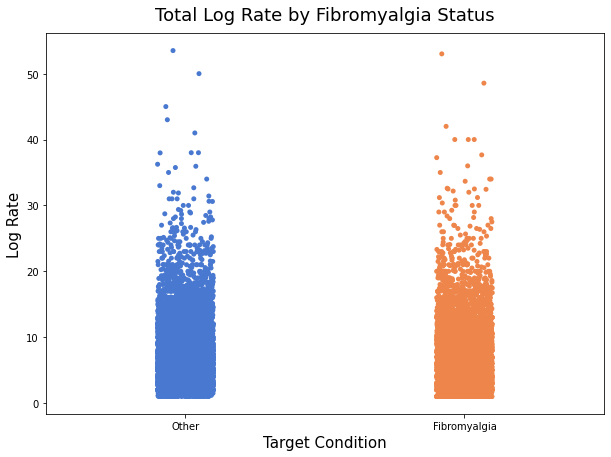

In [101]:
plt.figure(figsize=(10,7))
sns.stripplot(data=df_binary, x='target', y= 'total_log_rate', palette='muted')
plt.xticks((0,1), labels=['Other', 'Fibromyalgia'])
plt.xlabel('Target Condition', size=15)
plt.ylabel('Log Rate', size=15)
plt.title('Total Log Rate by Fibromyalgia Status', size=18, pad=13)
plt.show()

These perhaps seem more similar on the stripplot

## f. Conditions Total<a class="anchor" id="first-bullet6"></a>

In [24]:
df_binary.groupby(by='target').conditions_total.describe()

,count,mean,std,min,25%,50%,75%,max
target,,,,,,,,
0,13753.0,1.961536,1.159058,1.0,1.0,2.0,3.0,10.0
1,6960.0,1.836494,1.598333,0.0,1.0,2.0,3.0,11.0


Conditions total is not related to fibro status:

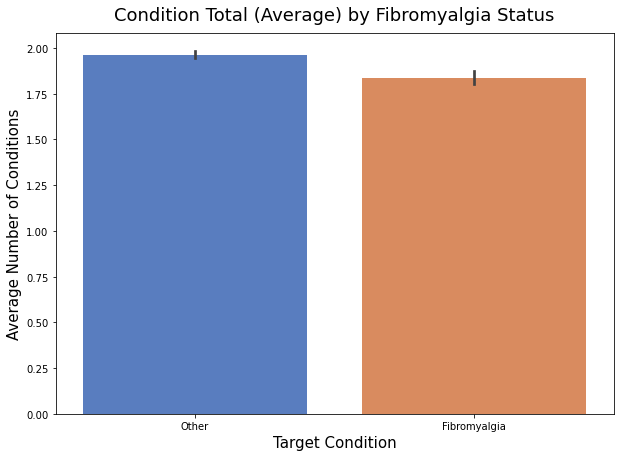

In [25]:
plt.figure(figsize=(10,7))
sns.barplot(data=df_binary, x='target', y= 'conditions_total', palette='muted')
plt.xticks((0,1), labels=['Other', 'Fibromyalgia'])
plt.xlabel('Target Condition', size=15)
plt.ylabel('Average Number of Conditions', size=15)
plt.title('Condition Total (Average) by Fibromyalgia Status', size=18, pad=13)
plt.show()

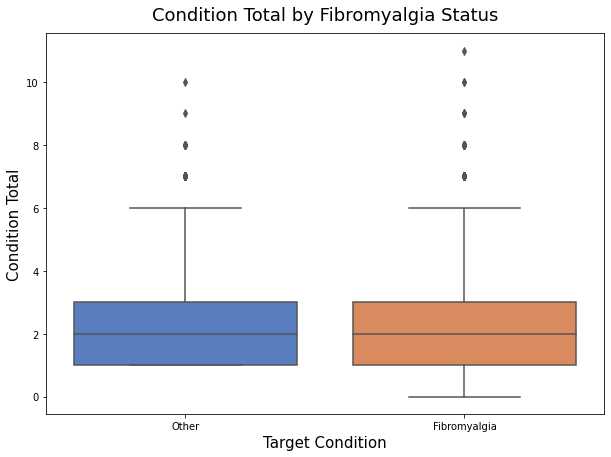

In [26]:
plt.figure(figsize=(10,7))
sns.boxplot(data=df_binary, x='target', y= 'conditions_total', palette='muted')
plt.xticks((0,1), labels=['Other', 'Fibromyalgia'])
plt.xlabel('Target Condition', size=15)
plt.ylabel('Condition Total', size=15)
plt.title('Condition Total by Fibromyalgia Status', size=18, pad=13)
plt.show()

## g. Symptoms Total<a class="anchor" id="first-bullet7"></a>

In [27]:
df_binary.groupby(by='target').symptoms_total.describe()

,count,mean,std,min,25%,50%,75%,max
target,,,,,,,,
0,13753.0,5.128626,3.674665,0.0,2.0,4.0,7.0,36.0
1,6960.0,5.735057,4.020880,0.0,3.0,5.0,8.0,35.0


Symptoms total may be predictive of fibro:

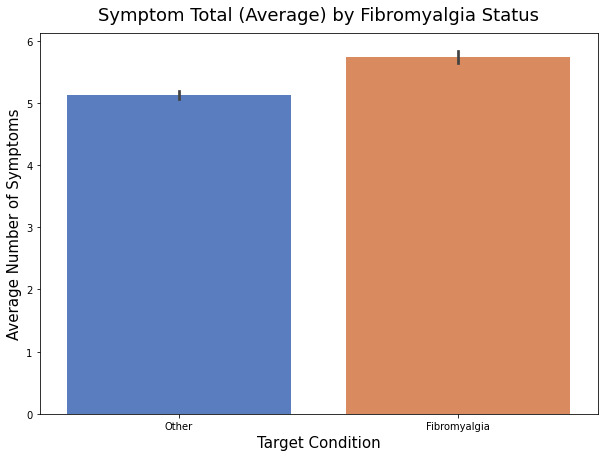

In [28]:
plt.figure(figsize=(10,7))
sns.barplot(data=df_binary, x='target', y= 'symptoms_total', palette='muted')
plt.xticks((0,1), labels=['Other', 'Fibromyalgia'])
plt.xlabel('Target Condition', size=15)
plt.ylabel('Average Number of Symptoms', size=15)
plt.title('Symptom Total (Average) by Fibromyalgia Status', size=18, pad=13)
plt.show()

Box plot supports this as well:

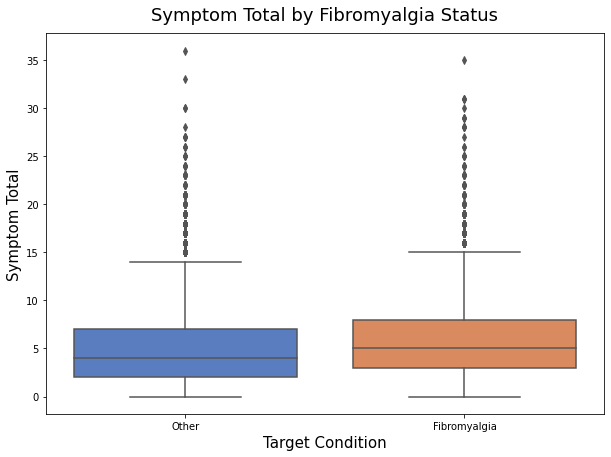

In [29]:
plt.figure(figsize=(10,7))
sns.boxplot(data=df_binary, x='target', y= 'symptoms_total', palette='muted')
plt.xticks((0,1), labels=['Other', 'Fibromyalgia'])
plt.xlabel('Target Condition', size=15)
plt.ylabel('Symptom Total', size=15)
plt.title('Symptom Total by Fibromyalgia Status', size=18, pad=13)
plt.show()

## h. Fibromyalgia Comorbitities Total<a class="anchor" id="first-bullet8"></a>

In [30]:
df_binary.groupby(by='target').fibro_comorbidities.describe()

,count,mean,std,min,25%,50%,75%,max
target,,,,,,,,
0,13753.0,0.907802,0.851593,0.0,0.0,1.0,2.0,3.0
1,6960.0,0.859770,0.935569,0.0,0.0,1.0,2.0,3.0


Looks like nonfibro users have more fibro comorbidities! This is because these are fairly common? 

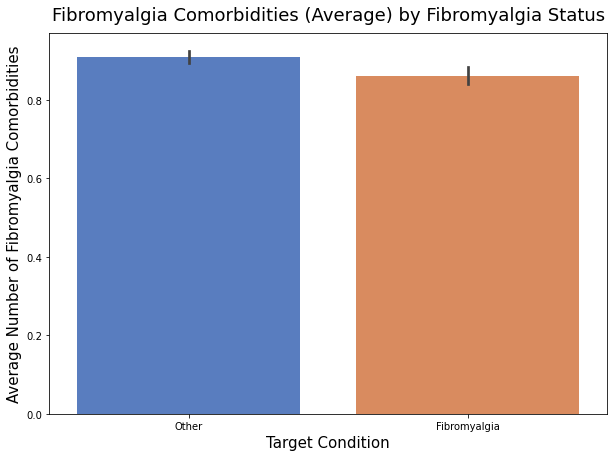

In [31]:
plt.figure(figsize=(10,7))
sns.barplot(data=df_binary, x='target', y= 'fibro_comorbidities', palette='muted')
plt.xticks((0,1), labels=['Other', 'Fibromyalgia'])
plt.xlabel('Target Condition', size=15)
plt.ylabel('Average Number of Fibromyalgia Comorbidities', size=15)
plt.title('Fibromyalgia Comorbidities (Average) by Fibromyalgia Status', size=18, pad=13)
plt.show()

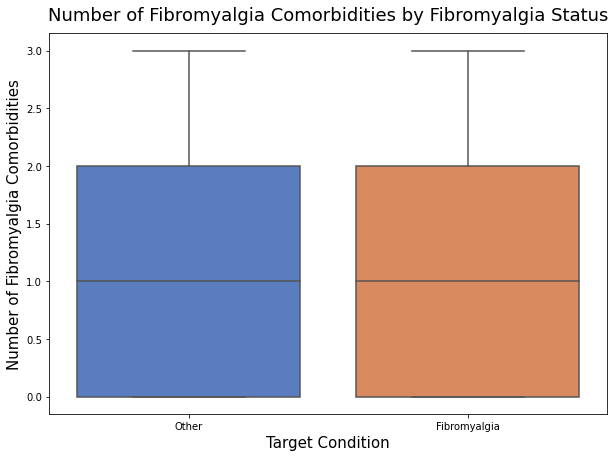

In [32]:
plt.figure(figsize=(10,7))
sns.boxplot(data=df_binary, x='target', y= 'fibro_comorbidities', palette='muted')
plt.xticks((0,1), labels=['Other', 'Fibromyalgia'])
plt.xlabel('Target Condition', size=15)
plt.ylabel('Number of Fibromyalgia Comorbidities', size=15)
plt.title('Number of Fibromyalgia Comorbidities by Fibromyalgia Status', size=18, pad=13)
plt.show()

## i. Symptoms and Conditions<a class="anchor" id="first-bullet9"></a>

Here, I am going to visualize each condition / symptom variable separately (binary, total logs, unique days, logging rate), using a for loop. First, I will remove the basic variables:

In [33]:
df_binary_other = df_binary.copy()

df_binary_other.drop(columns=['ids',
 'age',
 'gender',
 'country',
 'total_logs',
 'total_unique_dates_days',
 'total_log_rate',
 'conditions_total',
 'symptoms_total',
 'fibro_comorbidities'], inplace=True)

df_binary_other.columns

Index(['target', 'postural_orthostatic_tachycardia_syndrome',
       'postural_orthostatic_tachycardia_syndrome_total_logs',
       'postural_orthostatic_tachycardia_syndrome_activity',
       'postural_orthostatic_tachycardia_syndrome_unique_dates_days',
       'postural_orthostatic_tachycardia_syndrome_log_rate',
       'ehlers-danlos_syndrome', 'ehlers-danlos_syndrome_total_logs',
       'ehlers-danlos_syndrome_activity',
       'ehlers-danlos_syndrome_unique_dates_days',
       ...
       'nerve_pain', 'nerve_pain_total_logs', 'nerve_pain_activity',
       'nerve_pain_unique_dates_days', 'nerve_pain_log_rate',
       'menstrual_cramps', 'menstrual_cramps_total_logs',
       'menstrual_cramps_activity', 'menstrual_cramps_unique_dates_days',
       'menstrual_cramps_log_rate'],
      dtype='object', length=331)

Now I am going to make separate lists in order to iterate over them for each category of feature:

In [34]:
# target lists
total_logs_list = list()
activity_list = list()
days_list = list()
log_rate_list = list()
binaries = list()

# all the columns to choose from
all_cols = list(df_binary_other.columns)

# choosing the right features, putting them into lists
for col in all_cols:
    if 'total_logs' in col:
        total_logs_list.append(col)
    elif 'activity' in col:
        activity_list.append(col)
    elif 'unique' in col:
        days_list.append(col)
    elif 'log_rate' in col:
        log_rate_list.append(col)

print(len(total_logs_list))
print(len(activity_list))
print(len(days_list))
print(len(log_rate_list))

# selecting the binary columns and appending them
no_these = total_logs_list + activity_list + days_list + log_rate_list

for col in all_cols:
    if col not in no_these:
        binaries.append(col)

# checking the lengths
print(len(binaries))

66
66
66
66
67


### i. Condition and Symptom Binaries<a class="anchor" id="first-bullet9i"></a>

Writing the for loop, iterating through to graph each one:

In [35]:
binaries

['target',
 'postural_orthostatic_tachycardia_syndrome',
 'ehlers-danlos_syndrome',
 'irritable_bowel_syndrome',
 'osteoarthritis',
 'depression',
 'asthma',
 'anxiety',
 'arthritis',
 'insomnia',
 'endometriosis',
 'gerd',
 'lupus',
 'generalized_anxiety_disorder',
 'post-traumatic_stress_disorder',
 'chronic_fatigue_syndrome',
 'rheumatoid_arthritis',
 'polycystic_ovary_syndrome_(pcos)',
 'stomach_pain',
 'migraine',
 'stomach_cramps',
 'subluxation_or_dislocation',
 'back_pain',
 'headache',
 'muscle_pain',
 'shoulder_pain',
 'fatigue',
 'bloating',
 'abdominal_pain',
 'knee_pain',
 'brain_fog',
 'chronic_pain',
 'gas',
 'weakness',
 'constipation',
 'neck_pain',
 'diarrhea',
 'jaw_pain',
 'joint_pain',
 'dizziness_or_vertigo',
 'light_sensitivity',
 'palpitations',
 'stiffness',
 'sore_throat',
 'shortness_of_breath',
 'irritability',
 'nausea',
 'difficulty_concentrating',
 'chest_pain',
 'numbness_and_tingling',
 'acid_reflux',
 'swelling',
 'lightheadedness',
 'hand_pain',
 'mus

Plotting this !

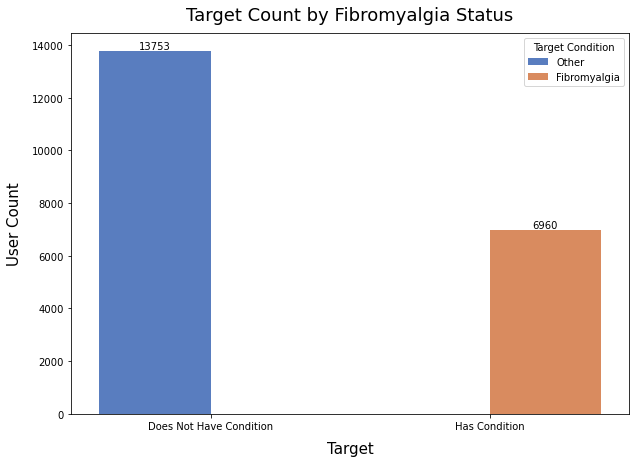

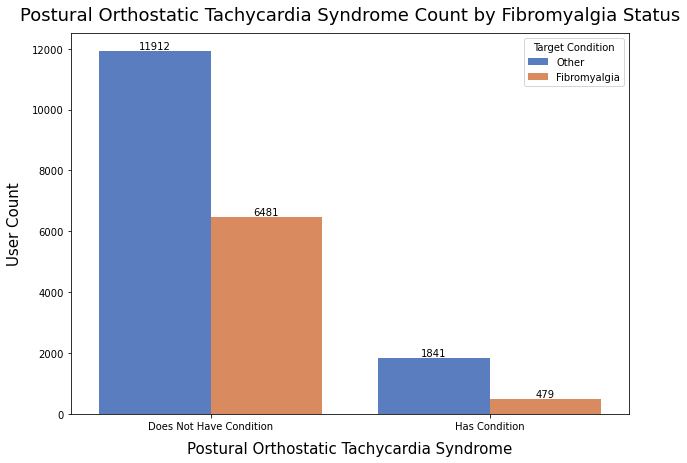

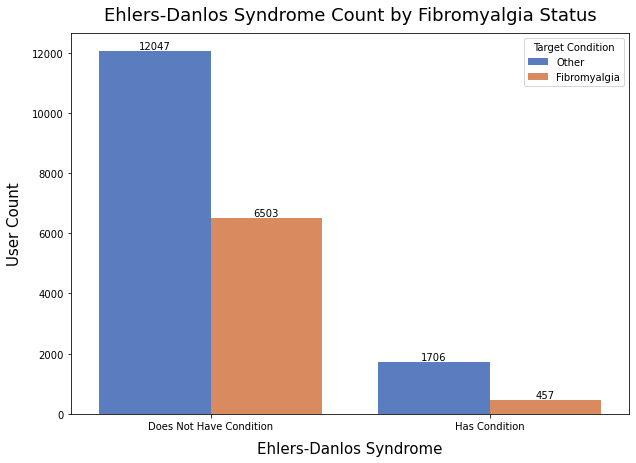

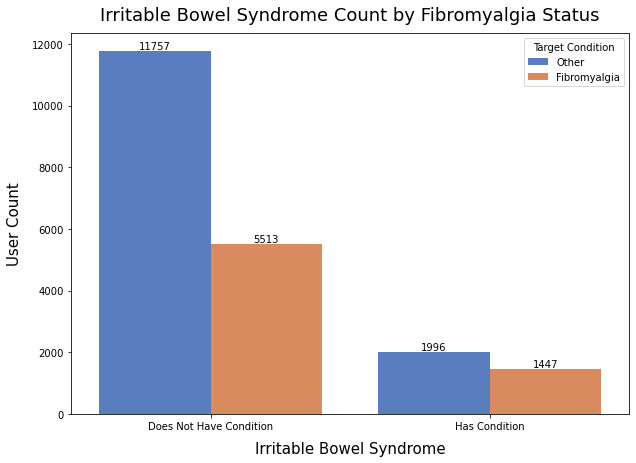

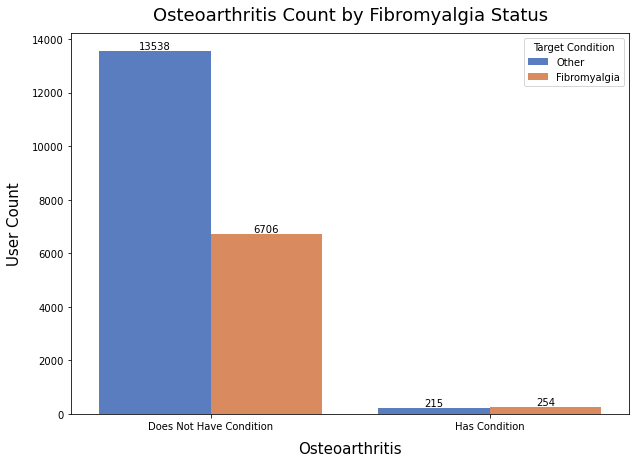

...

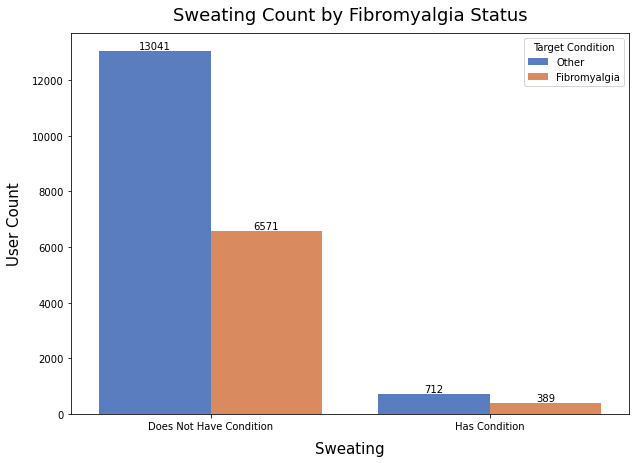

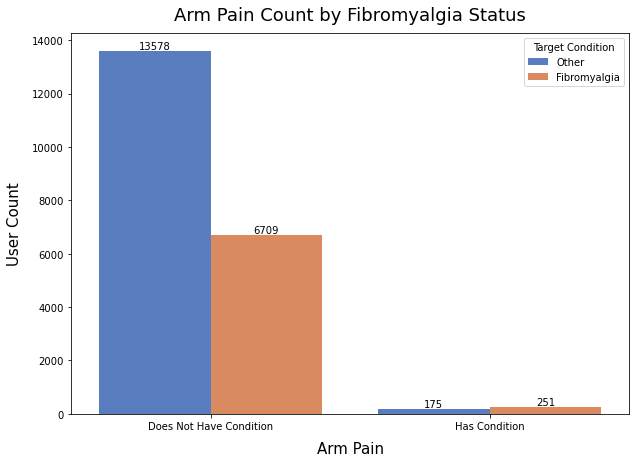

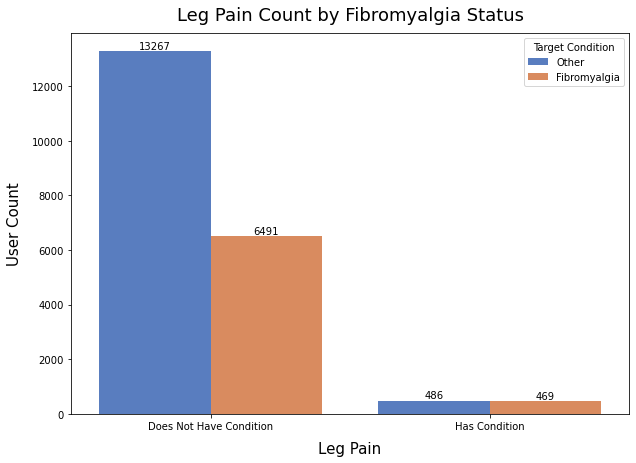

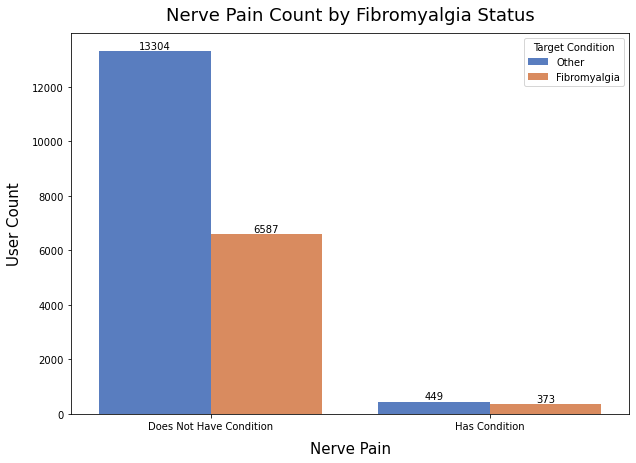

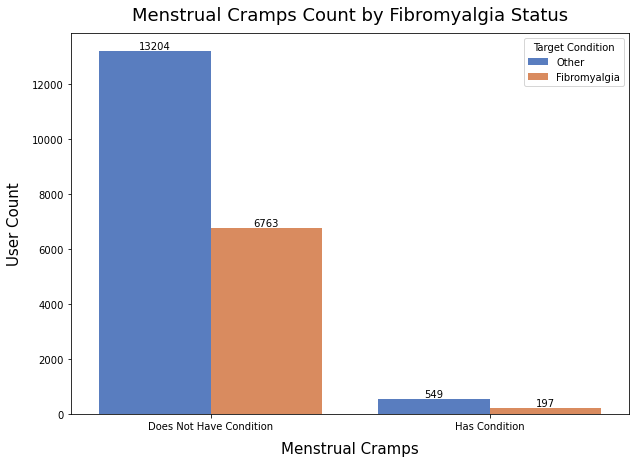

In [114]:
for col in binaries:

    title = col.replace("_", " ").title()

    plt.figure(figsize=(10,7))
    ax = sns.countplot(data=df_binary_other, x=col, hue='target', palette='muted')
    plt.ylabel("User Count", size=15, labelpad=10)
    plt.xlabel(title, size=15, labelpad=10)
    plt.xticks((0,1), labels=["Does Not Have Condition", 'Has Condition'])
    plt.title(f"{title} Count by Fibromyalgia Status", size=18, pad=13)
    plt.legend(title='Target Condition', labels=['Other','Fibromyalgia'])
    for container in ax.containers:
        ax.bar_label(container)
    plt.show()

List of some of the features that appear to be predictive of Fibromyalgia:
    
* IBS
* Oseoarthritis
* GAD
* PTDS
* CFS
* Nerve Pain
* migraine
* Back Pain
* muscle ache
* fatigue
* brain fog
* stiffness

For example, the following examples show that the ratio of Fibro to non-fibro users changes (more fibro users for those who have the given condition)

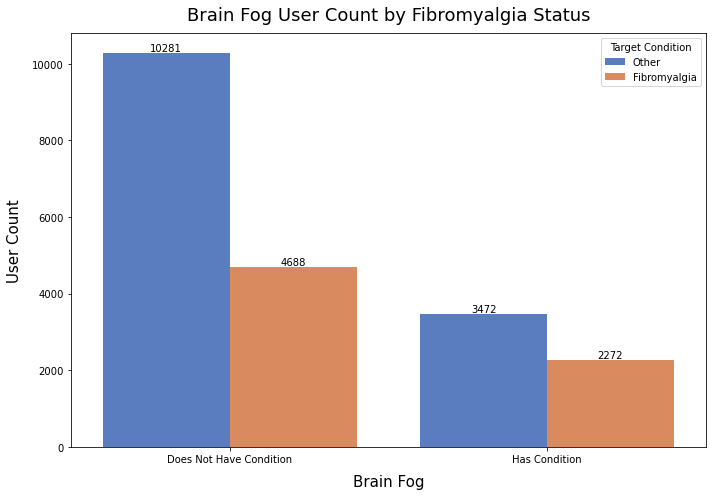

In [112]:
plt.figure(figsize=(10,7))
ax = sns.countplot(data=df_binary_other, x='brain_fog', hue='target', palette='muted')
plt.ylabel("User Count", size=15, labelpad=10)
plt.xlabel('Brain Fog', size=15, labelpad=10)
plt.xticks((0,1), labels=["Does Not Have Condition", 'Has Condition'])
plt.title(f"Brain Fog User Count by Fibromyalgia Status", size=18, pad=13)
plt.legend(title='Target Condition', labels=['Other','Fibromyalgia'])
plt.tight_layout()
for container in ax.containers:
    ax.bar_label(container)
plt.savefig('3-EDA Images and Figures/BrainFogBinaryFibro.png')
plt.show()

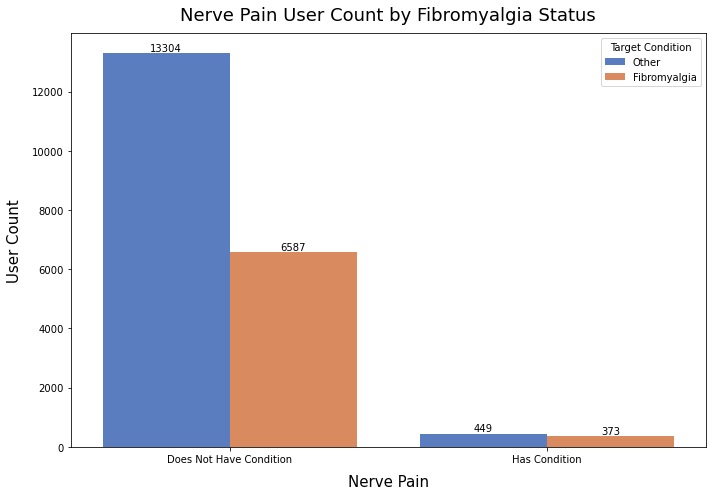

In [113]:
plt.figure(figsize=(10,7))
ax = sns.countplot(data=df_binary_other, x='nerve_pain', hue='target', palette='muted')
plt.ylabel("User Count", size=15, labelpad=10)
plt.xlabel('Nerve Pain', size=15, labelpad=10)
plt.xticks((0,1), labels=["Does Not Have Condition", 'Has Condition'])
plt.title(f"Nerve Pain User Count by Fibromyalgia Status", size=18, pad=13)
plt.legend(title='Target Condition', labels=['Other','Fibromyalgia'])
plt.tight_layout()
for container in ax.containers:
    ax.bar_label(container)
plt.savefig('3-EDA Images and Figures/NervePainBinaryFibro.png')
plt.show()

### ii. Condition and Symptom Activity (Median Trackable Value)<a class="anchor" id="first-bullet9ii"></a>

In [37]:
activity_list

['postural_orthostatic_tachycardia_syndrome_activity',
 'ehlers-danlos_syndrome_activity',
 'irritable_bowel_syndrome_activity',
 'osteoarthritis_activity',
 'depression_activity',
 'asthma_activity',
 'anxiety_activity',
 'arthritis_activity',
 'insomnia_activity',
 'endometriosis_activity',
 'gerd_activity',
 'lupus_activity',
 'generalized_anxiety_disorder_activity',
 'post-traumatic_stress_disorder_activity',
 'chronic_fatigue_syndrome_activity',
 'rheumatoid_arthritis_activity',
 'polycystic_ovary_syndrome_(pcos)_activity',
 'stomach_pain_activity',
 'migraine_activity',
 'stomach_cramps_activity',
 'subluxation_or_dislocation_activity',
 'back_pain_activity',
 'headache_activity',
 'muscle_pain_activity',
 'shoulder_pain_activity',
 'fatigue_activity',
 'bloating_activity',
 'abdominal_pain_activity',
 'knee_pain_activity',
 'brain_fog_activity',
 'chronic_pain_activity',
 'gas_activity',
 'weakness_activity',
 'constipation_activity',
 'neck_pain_activity',
 'diarrhea_activity',

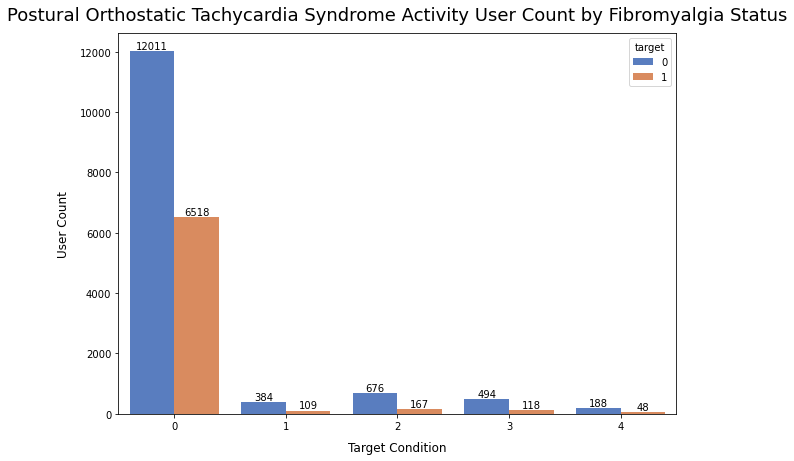

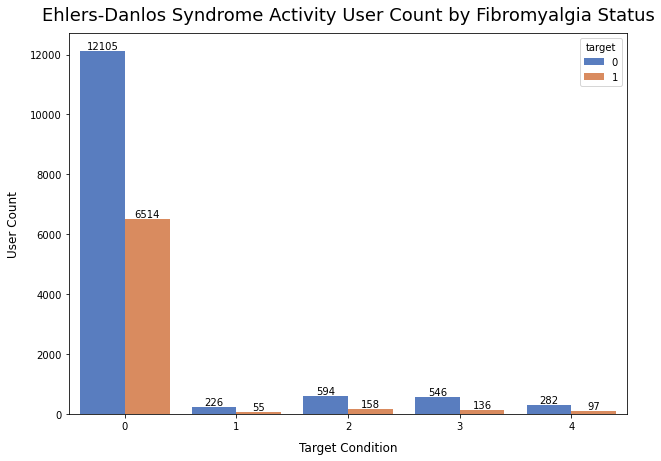

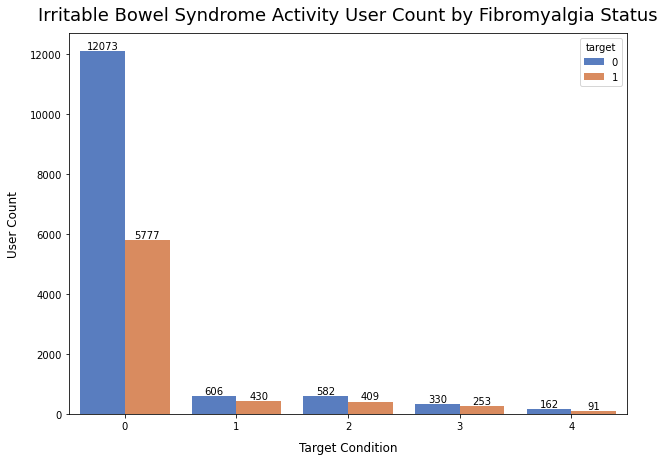

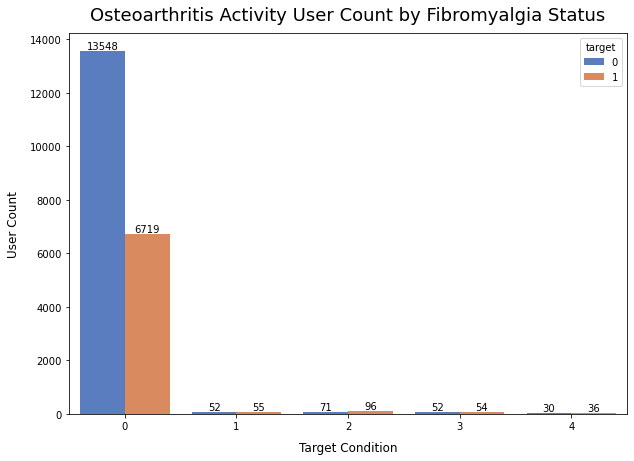

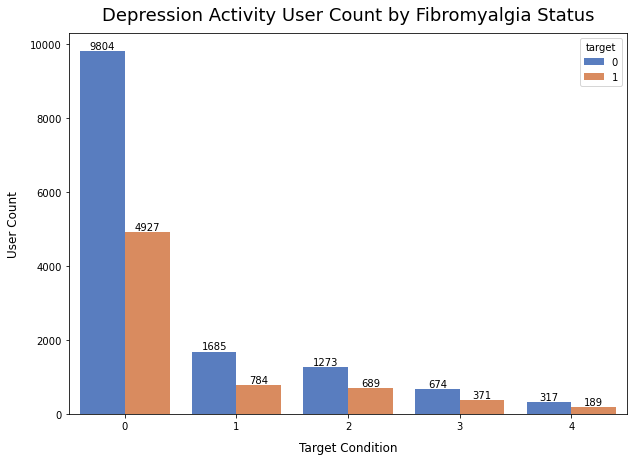

...

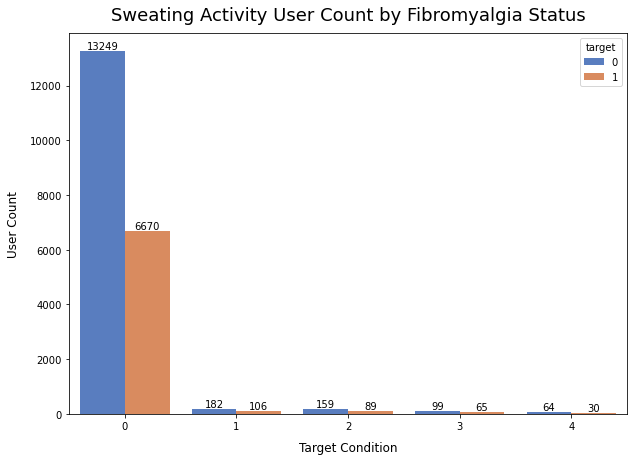

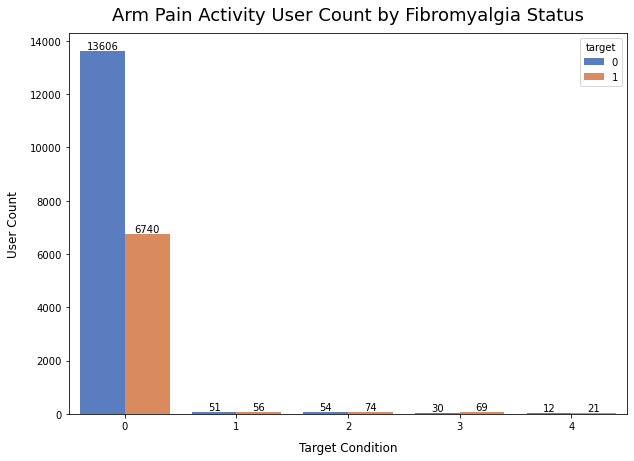

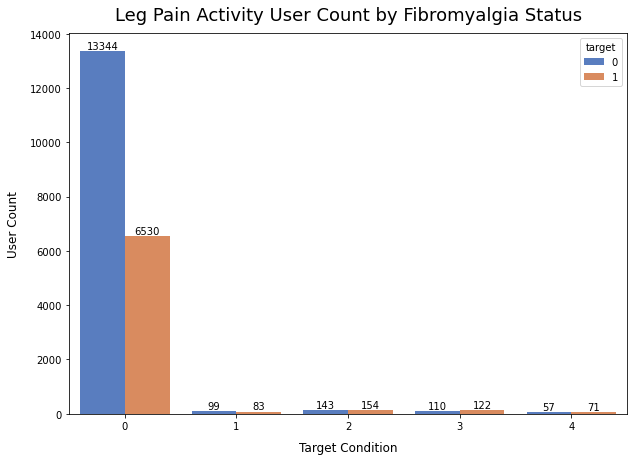

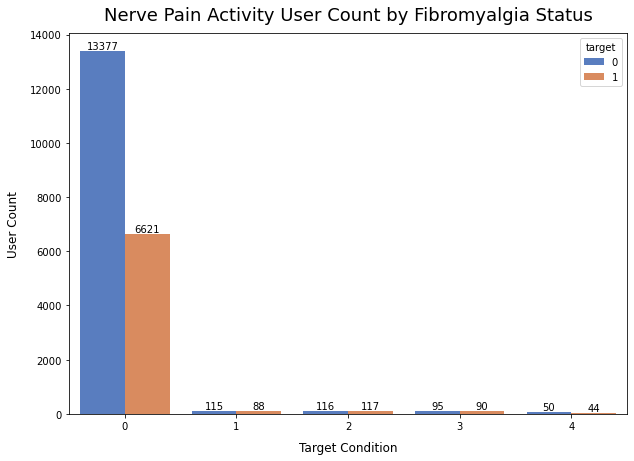

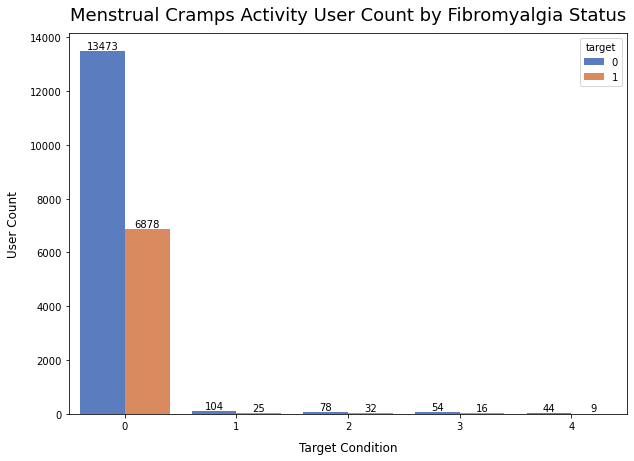

In [115]:
for col in activity_list:

    title = col.replace("_", " ").title()

    plt.figure(figsize=(10,7))
    ax = sns.countplot(data=df_binary_other, x=col, hue='target', palette='muted')
    plt.ylabel(f"User Count", size=12, labelpad=10)
    plt.xlabel("Target Condition", size=12, labelpad=10)
    # plt.xticks((0,1,3,4), labels=["Other", 'Fibromyalgia'])
    plt.title(f"{title} User Count by Fibromyalgia Status", size=18, pad=13)
    for container in ax.containers:
        ax.bar_label(container)
    plt.show()

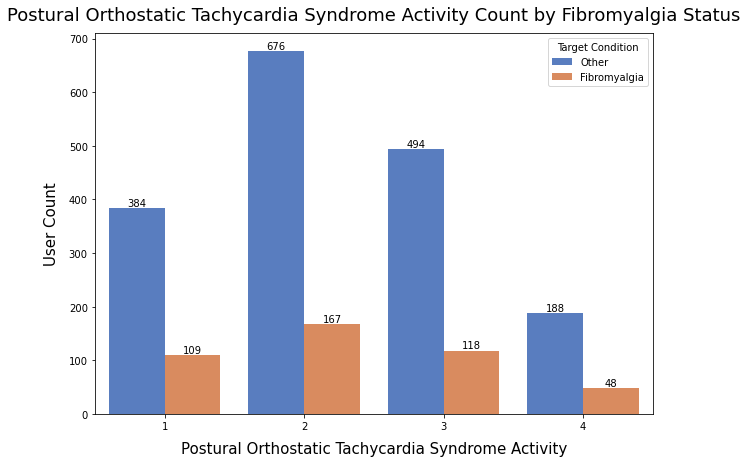

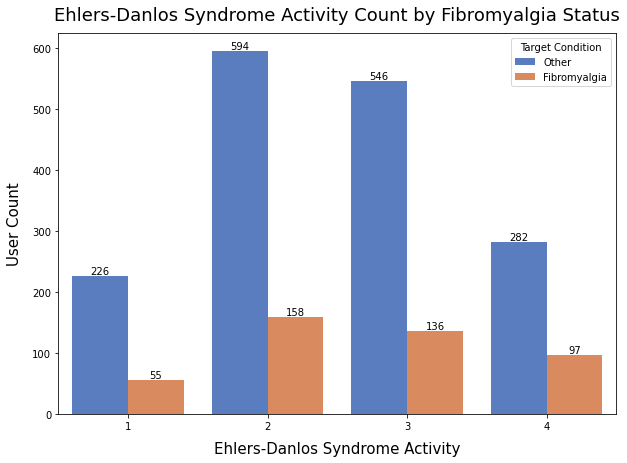

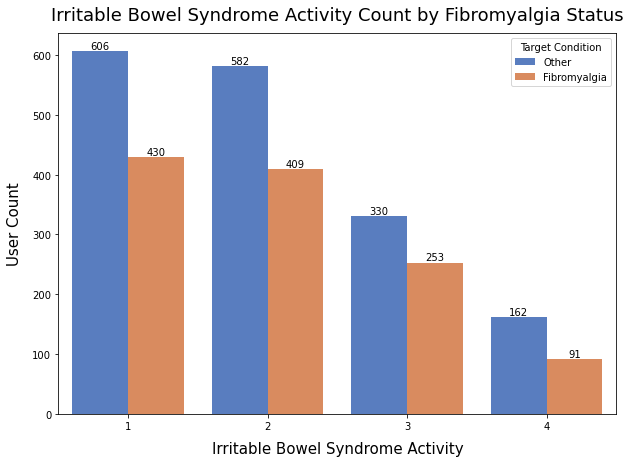

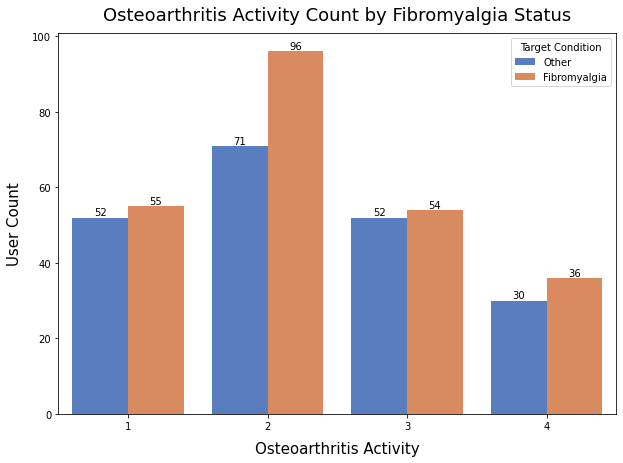

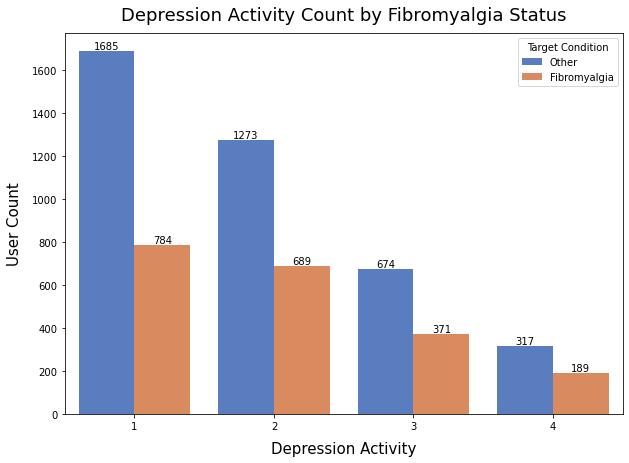

...

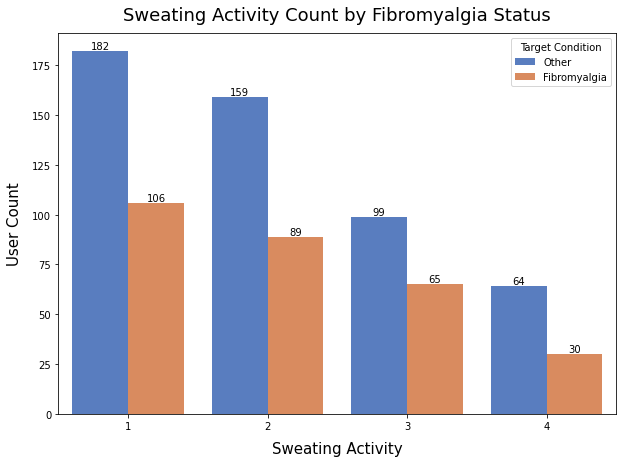

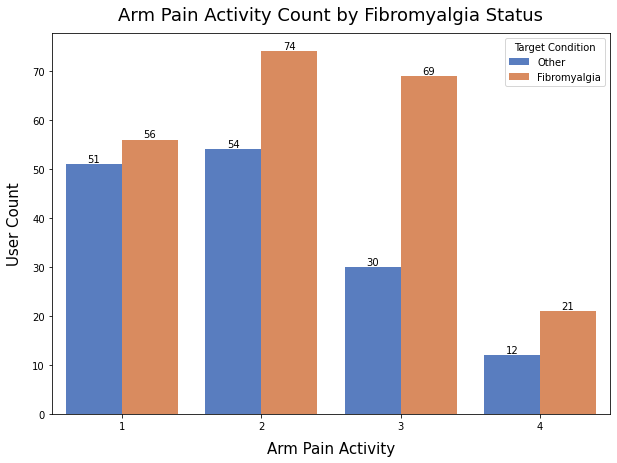

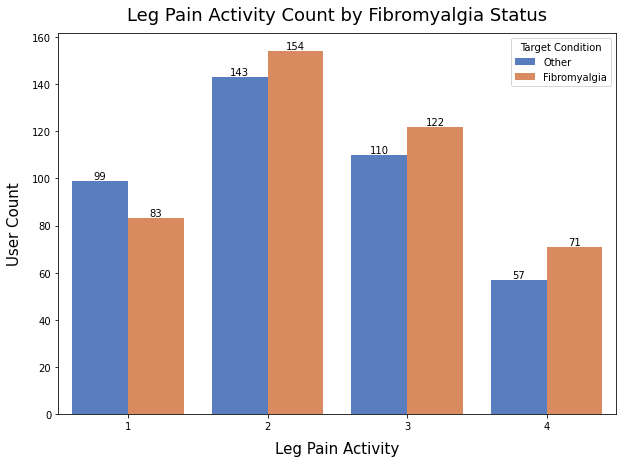

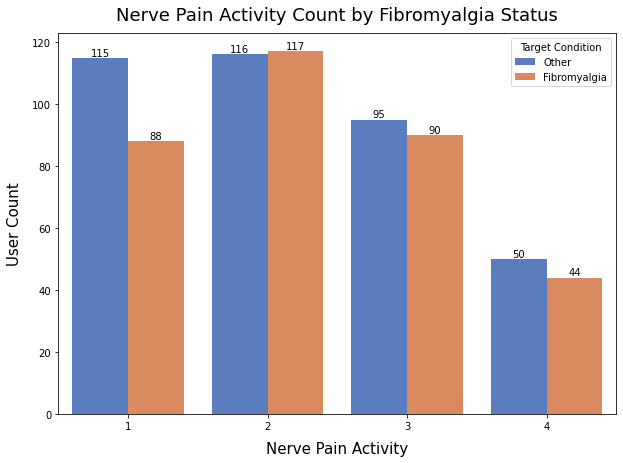

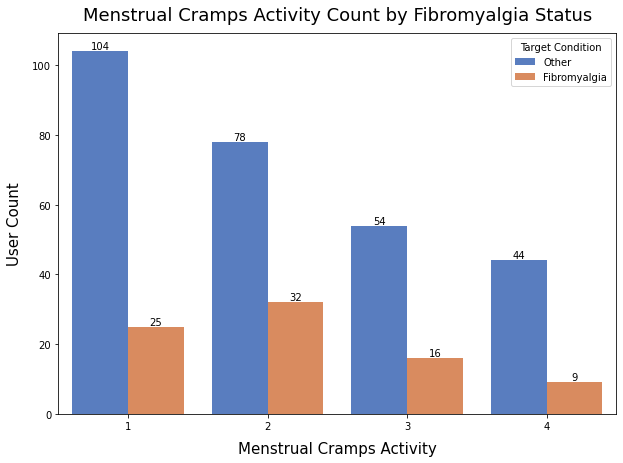

In [39]:
for col in activity_list:

    #try to drop the zeros
    df_act = df_binary_other[df_binary_other[col] != 0]

    title = col.replace("_", " ").title()

    plt.figure(figsize=(10,7))
    ax = sns.countplot(data=df_act, x=col, hue='target', palette='muted')
    plt.ylabel("User Count", size=15, labelpad=10)
    plt.xlabel(f"{title}", size=15, labelpad=10)
    plt.title(f"{title} Count by Fibromyalgia Status", size=18, pad=13)
    plt.legend(title='Target Condition', labels=["Other", 'Fibromyalgia'])
    for container in ax.containers:
        ax.bar_label(container)
    plt.show()

Show the average Activity Without Zeros Included:

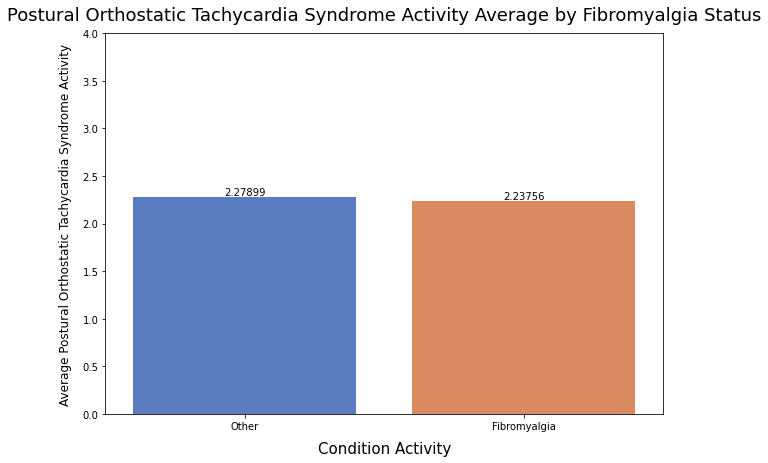

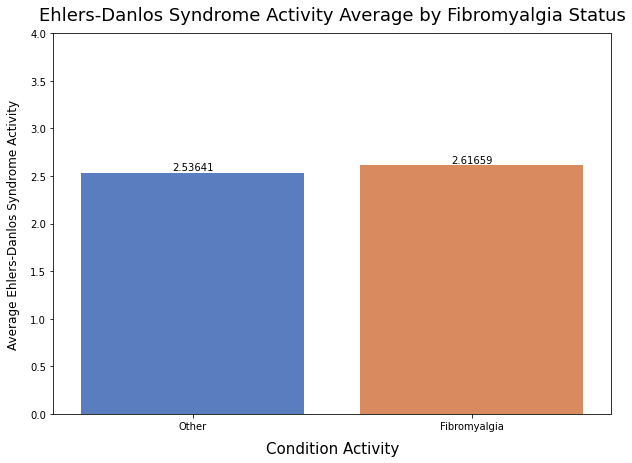

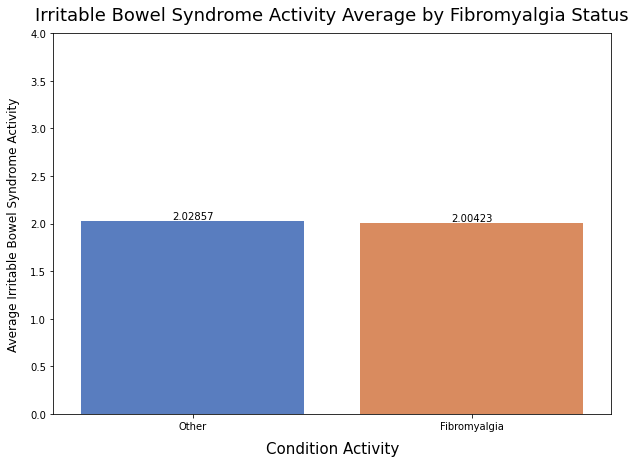

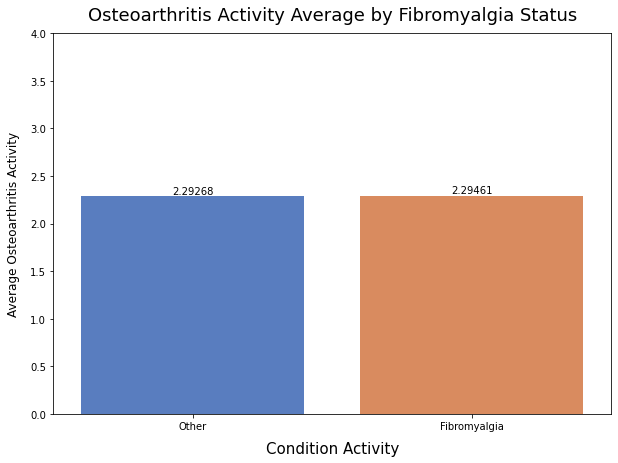

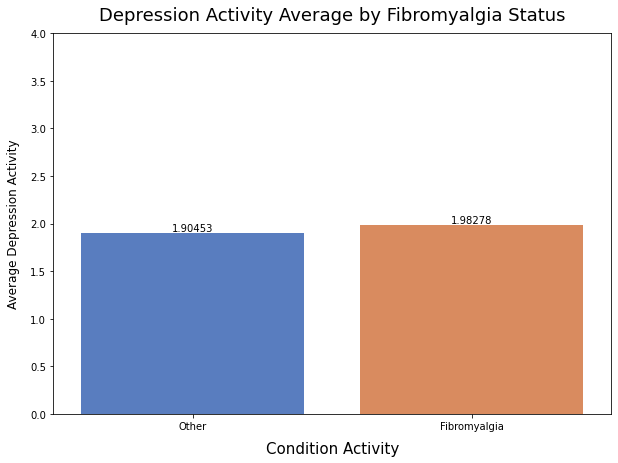

...

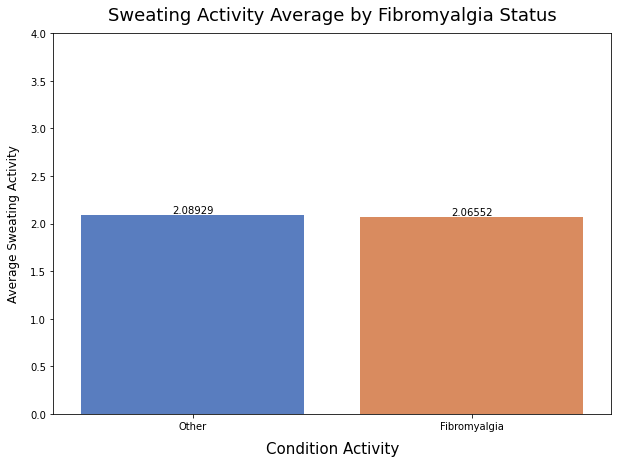

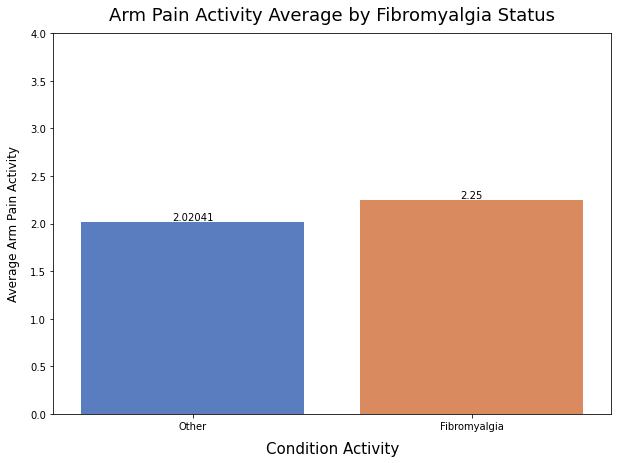

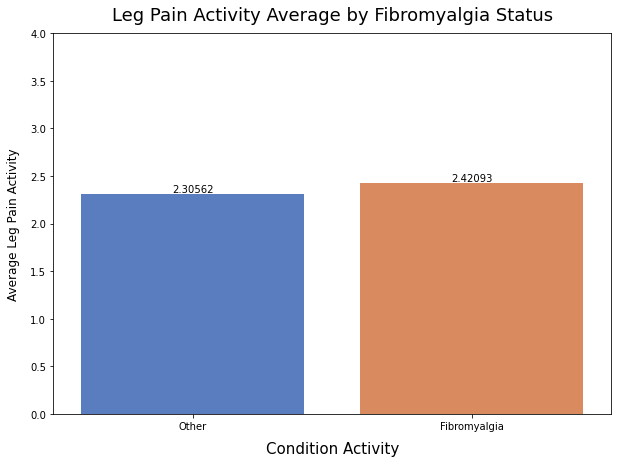

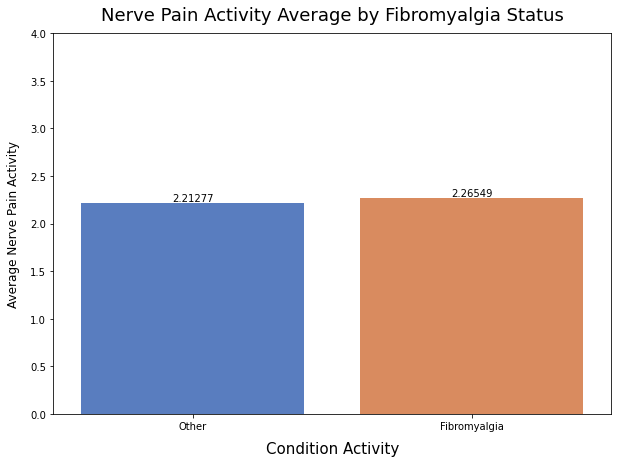

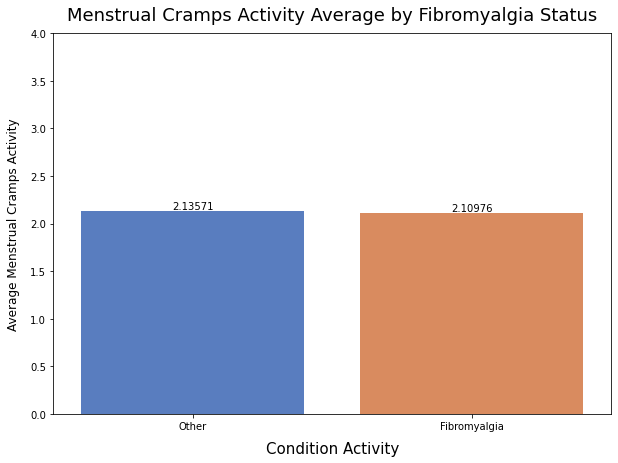

In [119]:
for col in activity_list:

    #try to drop the zeros
    df_act = df_binary_other[df_binary_other[col] != 0]

    title = col.replace("_", " ").title()

    plt.figure(figsize=(10,7))
    ax = sns.barplot(data=df_act, x='target', y=col, palette='muted', ci=None)
    plt.ylabel(f"Average {title}", size=12, labelpad=10)
    plt.xlabel(f"Condition Activity", size=15, labelpad=10)
    plt.ylim(0,4)
    plt.xticks((0,1), labels=["Other", "Fibromyalgia"])
    plt.title(f"{title} Average by Fibromyalgia Status", size=18, pad=13)
    for container in ax.containers:
        ax.bar_label(container)
    plt.show()

List of some conditions that seem predictive of fibromyalgia:

* depression
* IBS
* Arthritis
* CFS
* Migraine
* Back Pain
* Muscle Pain
* Shoulder Pain
* Fatgiue
* Brain fog
* Chronic Pain
* Nerve Pain
* Stiffness

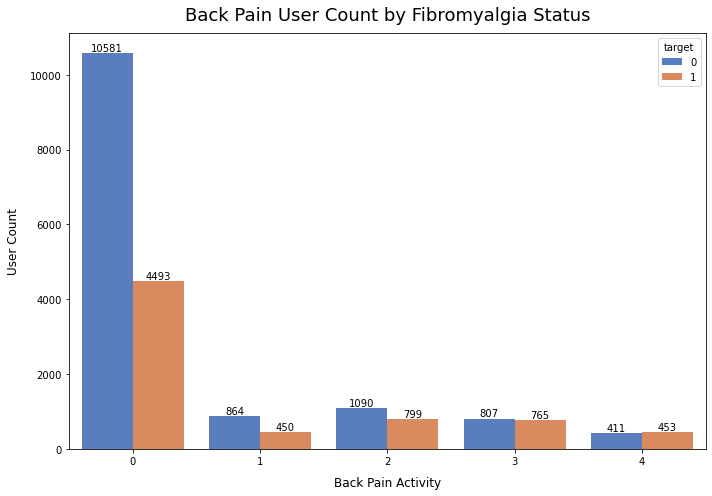

In [121]:
plt.figure(figsize=(10,7))
ax = sns.countplot(data=df_binary_other, x='back_pain_activity', hue='target', palette='muted')
plt.ylabel(f"User Count", size=12, labelpad=10)
plt.xlabel("Back Pain Activity", size=12, labelpad=10)
    # plt.xticks((0,1,3,4), labels=["Other", 'Fibromyalgia'])
plt.title(f"Back Pain User Count by Fibromyalgia Status", size=18, pad=13)
plt.tight_layout()
for container in ax.containers:
    ax.bar_label(container)
plt.savefig('3-EDA Images and Figures/BackPainActivityFibro.png')
plt.show()

The ratio of fibro to nonfibro users fluctuates such that higher back pain activity has equal groups, effectively an effect for fibro!

### iii. Unique Logging Days<a class="anchor" id="first-bullet9iii"></a> 

**Stripplot**

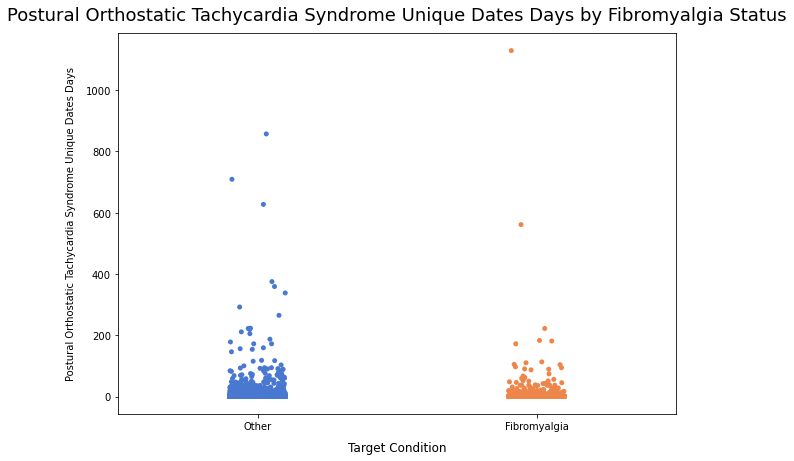

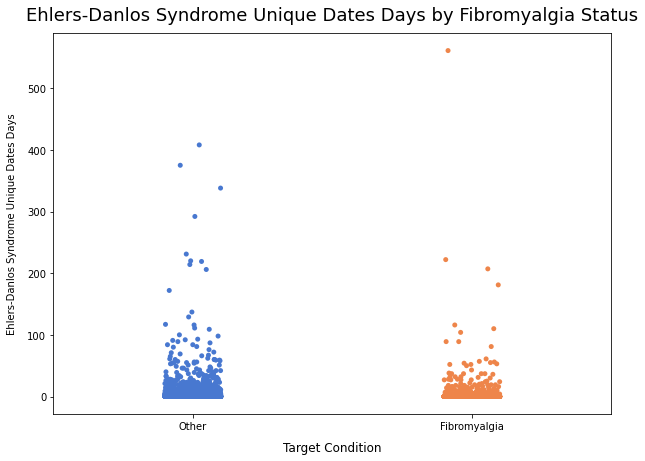

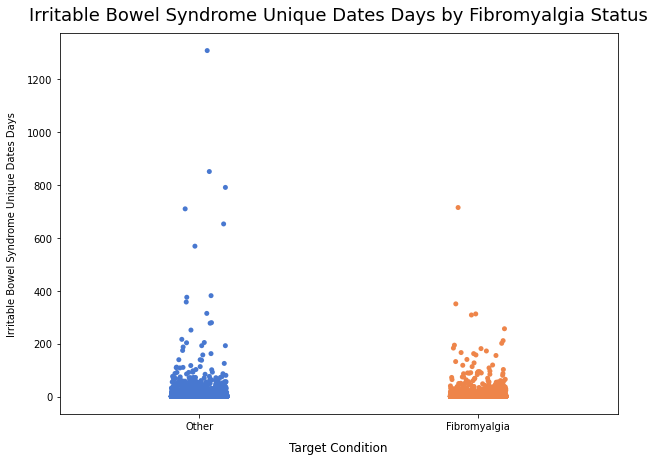

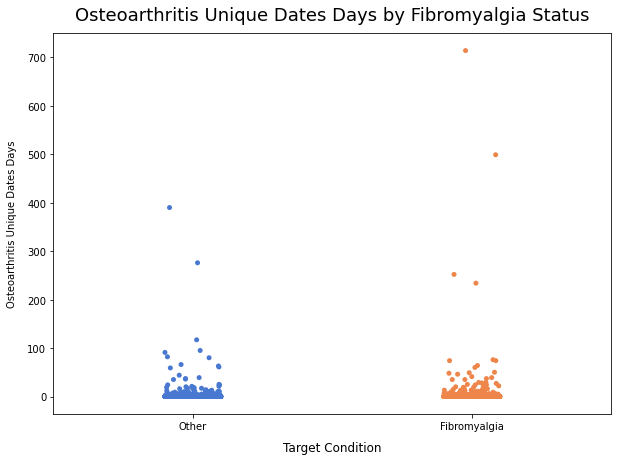

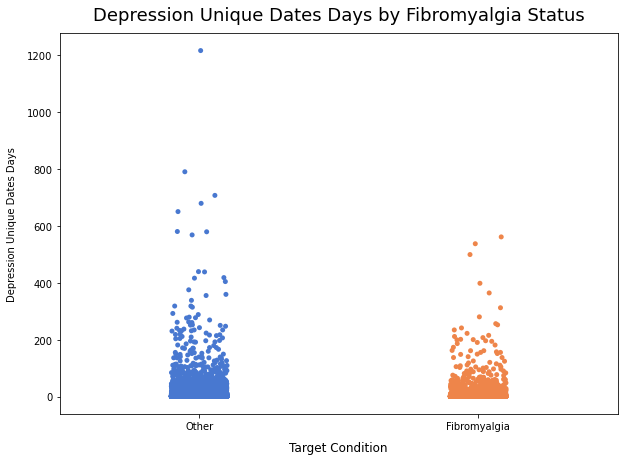

...

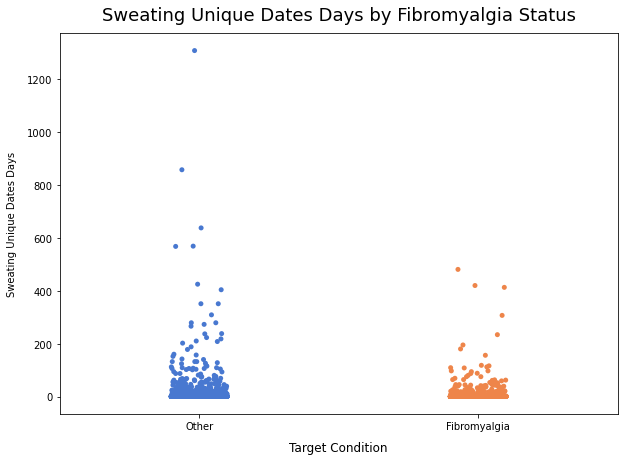

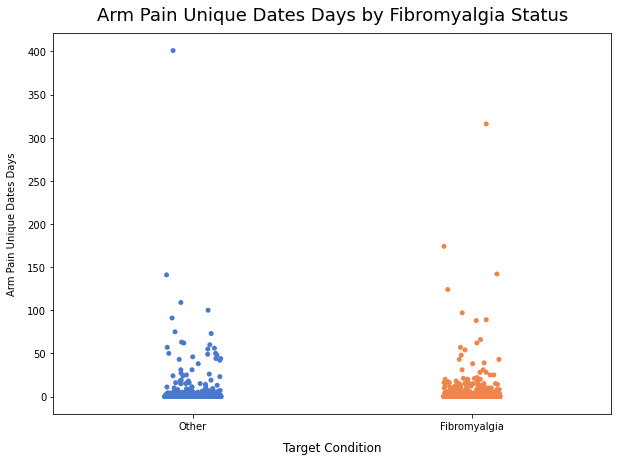

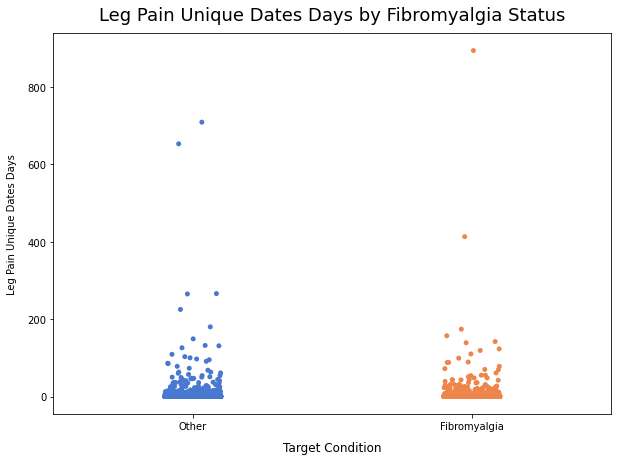

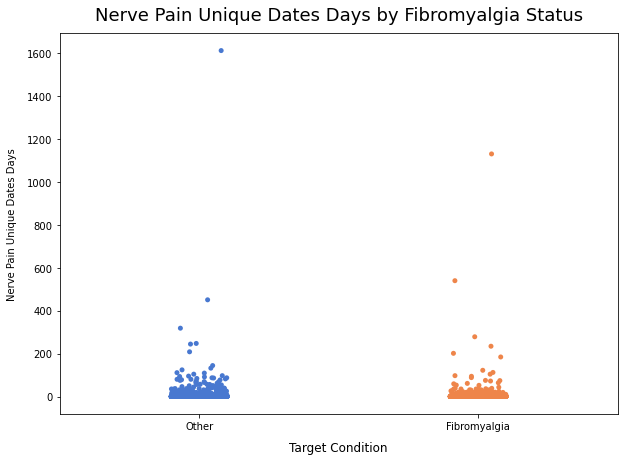

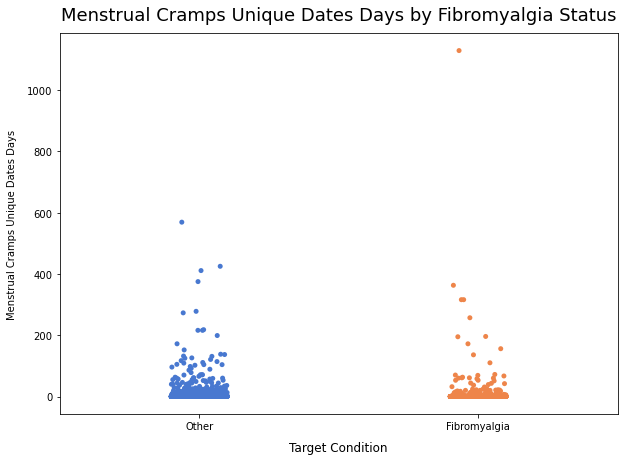

In [41]:
for col in days_list:

    title = col.replace("_", " ").title()

    plt.figure(figsize=(10,7))
    sns.stripplot(data=df_binary_other, x='target', y=col, palette='muted')
    plt.ylabel(f"{title}", size=10, labelpad=10)
    plt.xlabel(f"Target Condition", size=12, labelpad=10)
    plt.xticks((0,1), labels=["Other", "Fibromyalgia"])
    plt.title(f"{title} by Fibromyalgia Status", size=18, pad=13)
    plt.show()

Doesn't look like there are many unique date days features that are predictive of fibro. Perhaps it's not a great feature.

**Average**

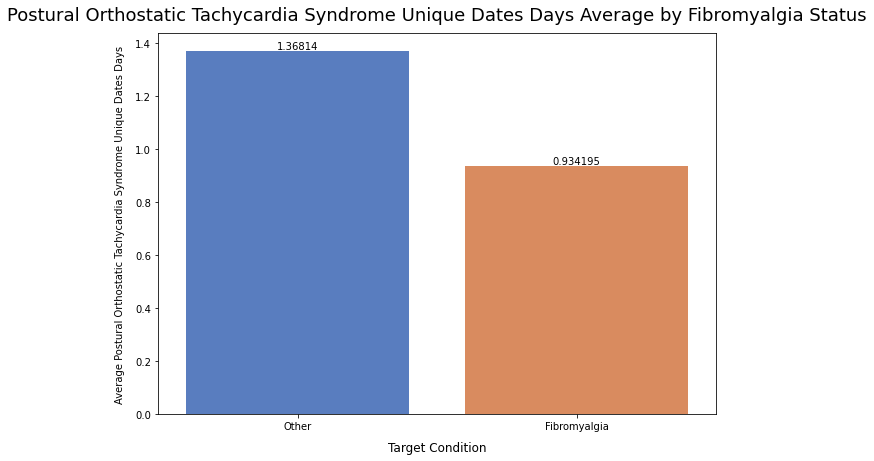

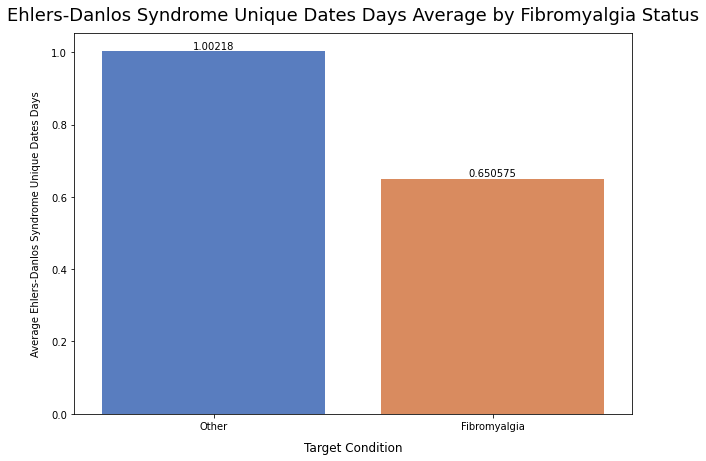

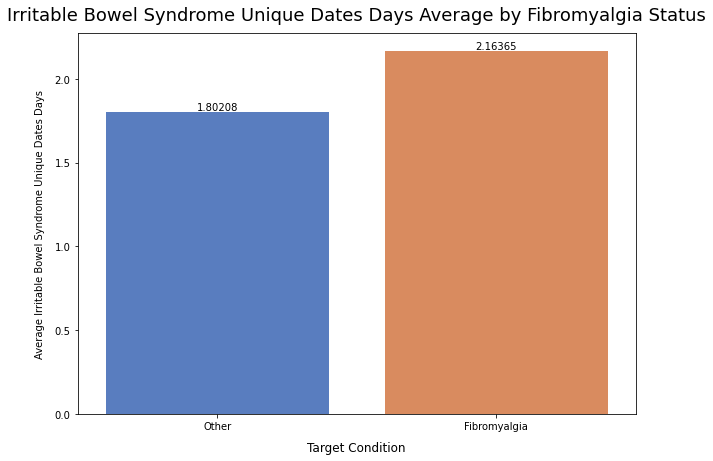

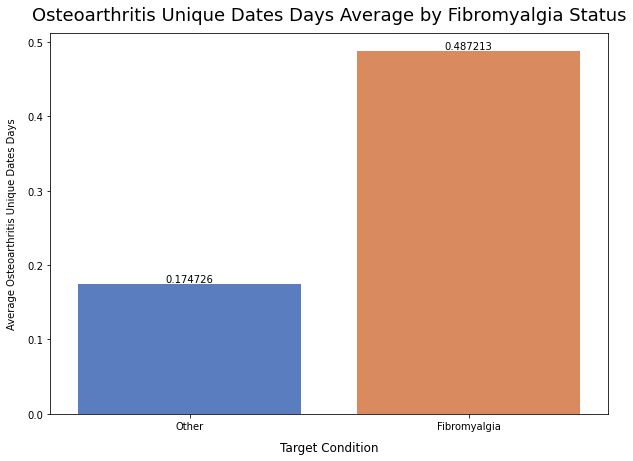

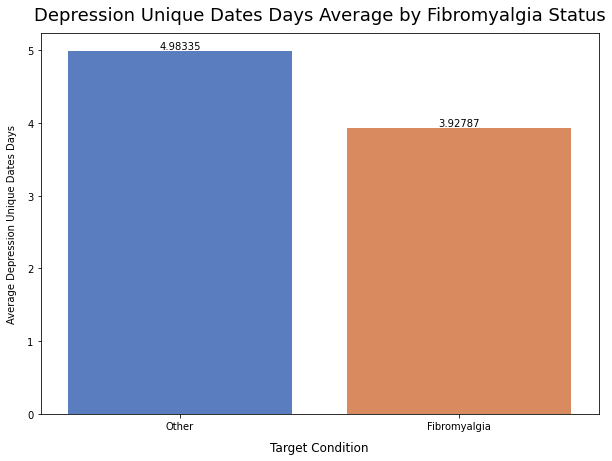

...

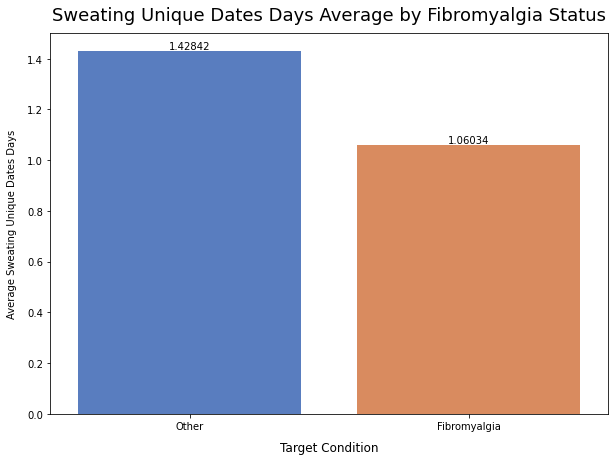

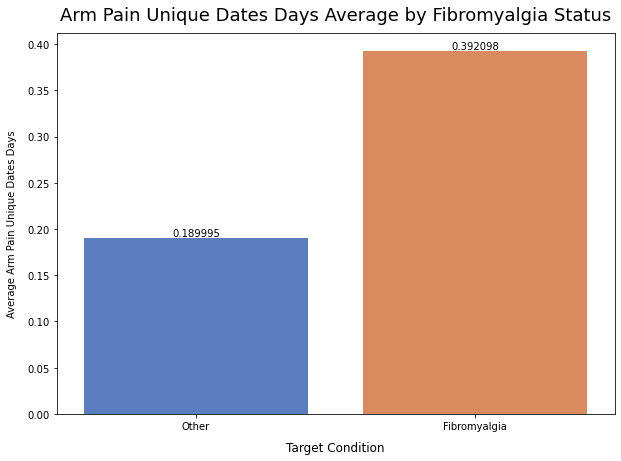

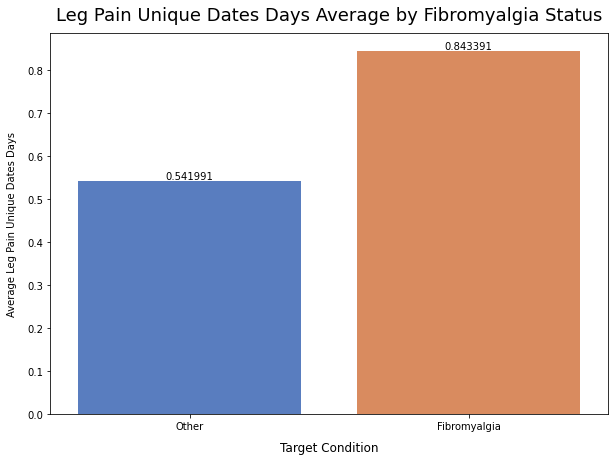

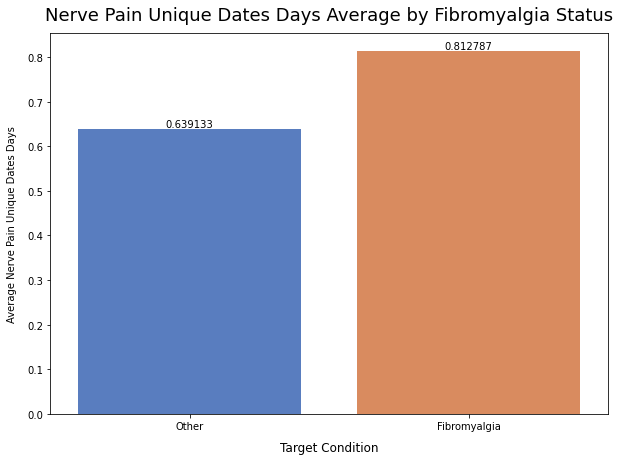

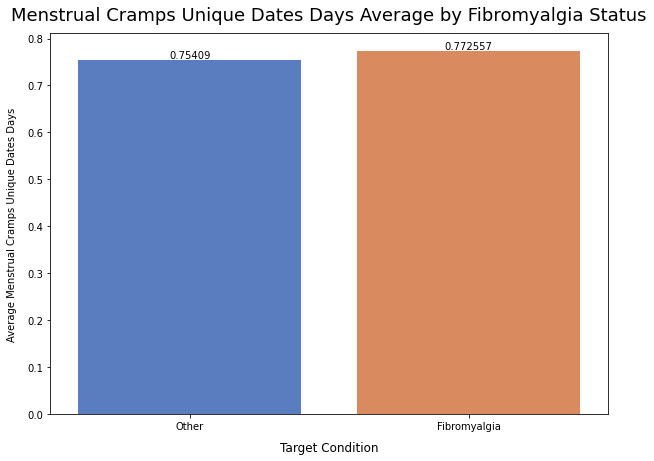

In [42]:
for col in days_list:

    title = col.replace("_", " ").title()

    plt.figure(figsize=(10,7))
    ax = sns.barplot(data=df_binary_other, x='target', y=col, palette='muted', ci=None)
    plt.ylabel(f"Average {title}", size=10, labelpad=10)
    plt.xlabel(f"Target Condition", size=12, labelpad=10)
    plt.xticks((0,1), labels=["Other", "Fibromyalgia"])
    plt.title(f"{title} Average by Fibromyalgia Status", size=18, pad=13)
    for container in ax.containers:
        ax.bar_label(container)
    plt.show()

Perhaps some of the following: 
    
* migraine
* IBS
* CFS
* GAD
* PTSD
* back pain
* muscle pain

### iv. Logging Rate<a class="anchor" id="first-bullet9iv"></a>

**Stripplot**

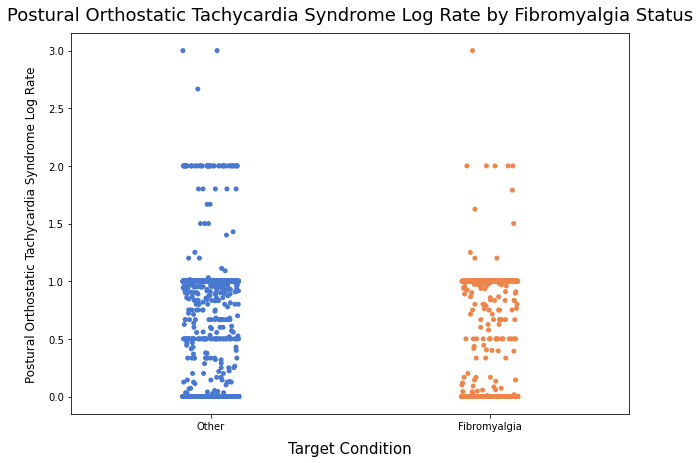

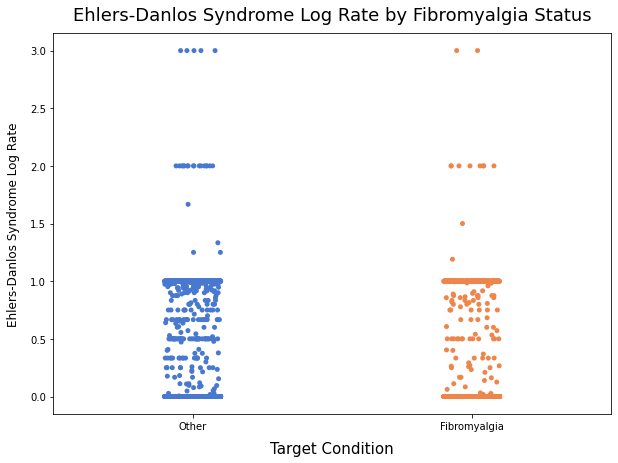

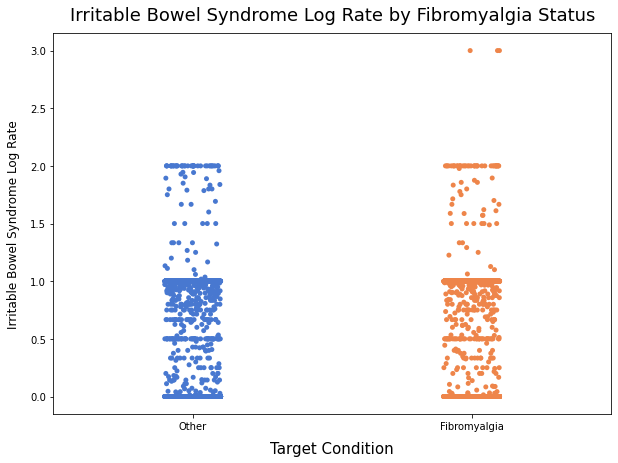

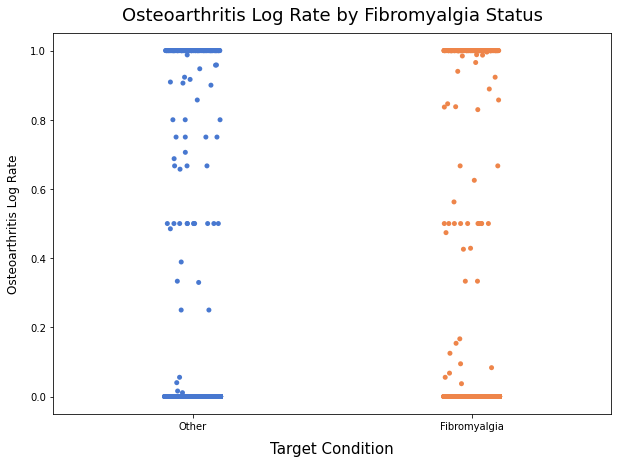

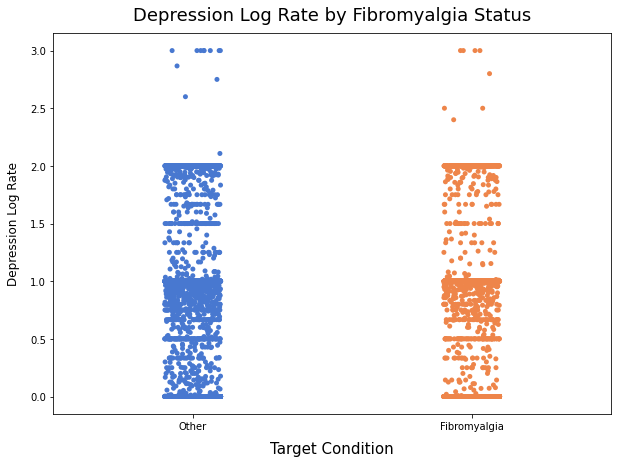

...

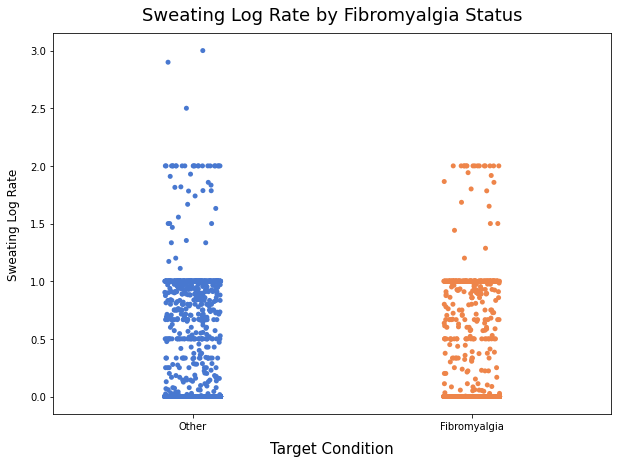

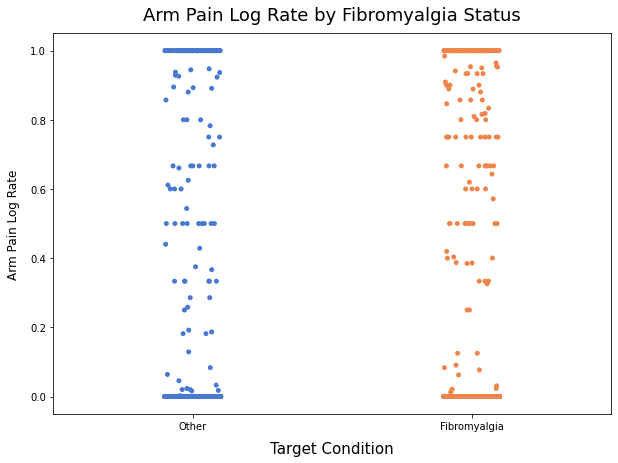

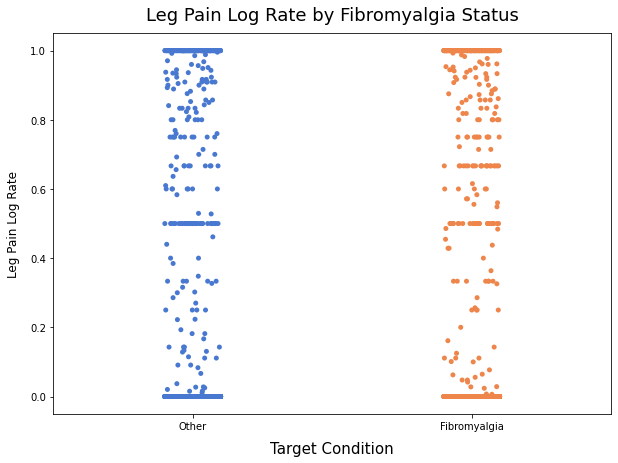

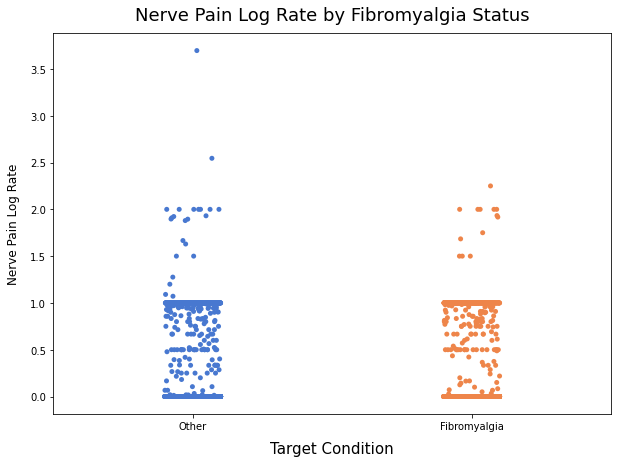

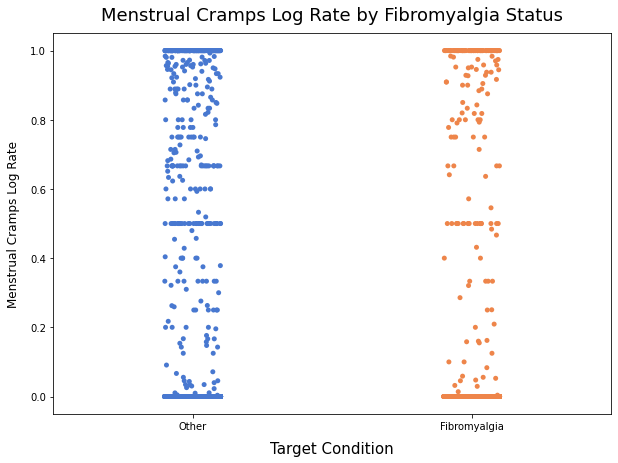

In [43]:
for col in log_rate_list:

    title = col.replace("_", " ").title()

    plt.figure(figsize=(10,7))
    sns.stripplot(data=df_binary_other, x='target', y=col, palette='muted')
    plt.ylabel(f"{title}", size=12, labelpad=10)
    plt.xlabel(f"Target Condition", size=15, labelpad=10)
    plt.xticks((0,1), labels=["Other", "Fibromyalgia"])
    plt.title(f"{title} by Fibromyalgia Status", size=18, pad=13)
    plt.show()

**Average**

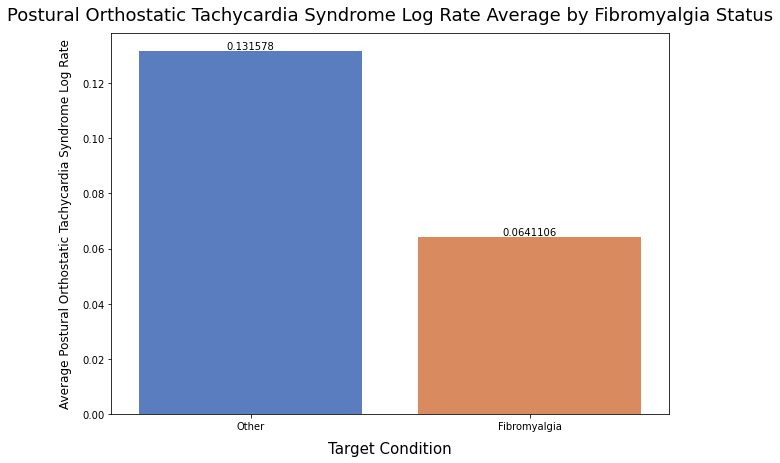

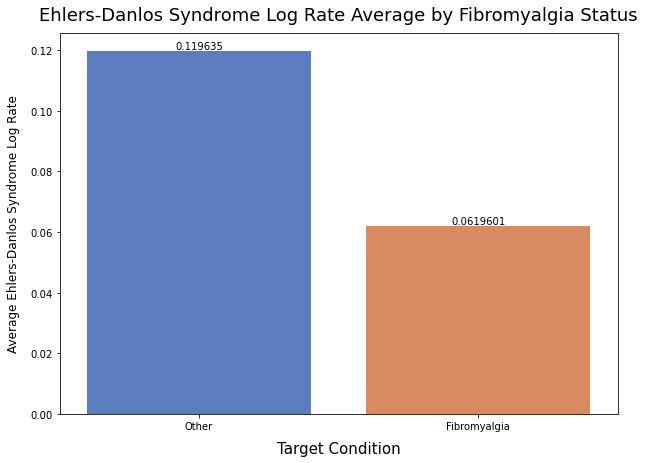

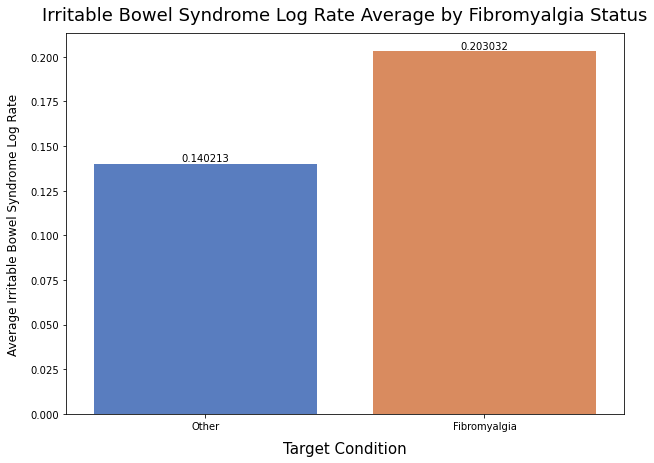

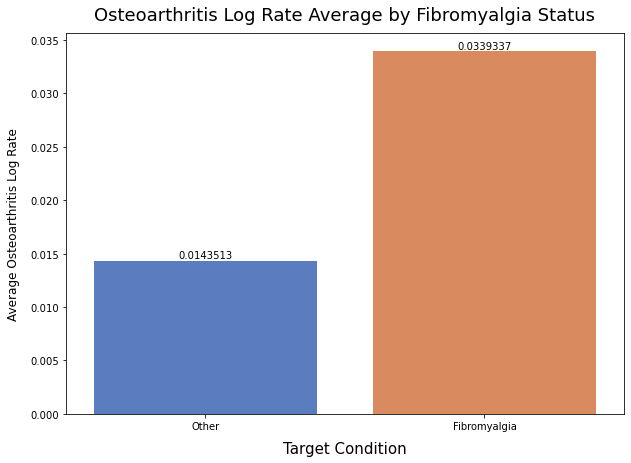

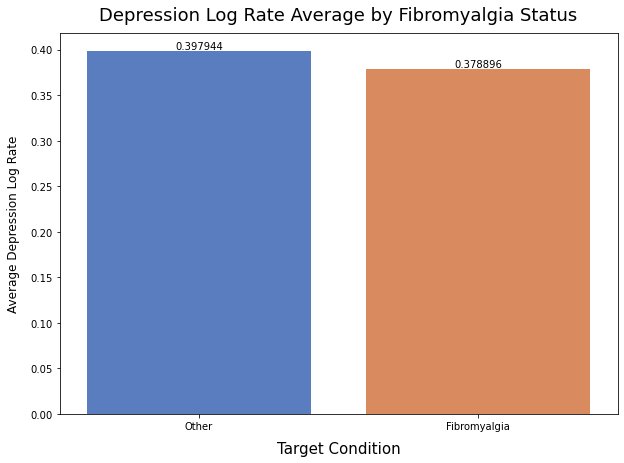

...

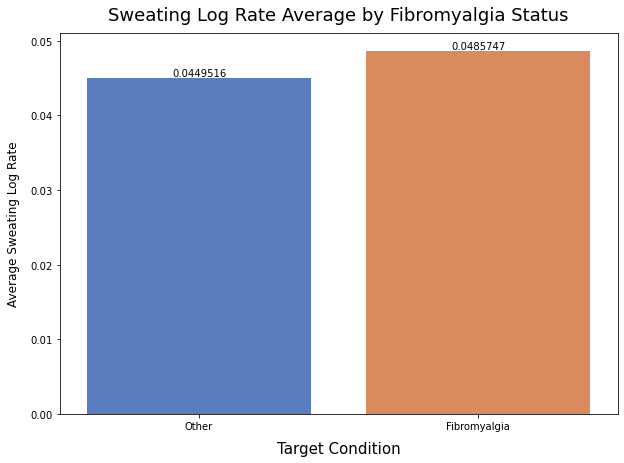

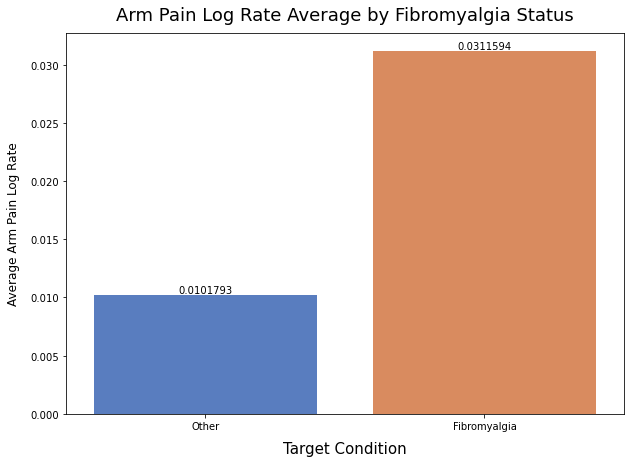

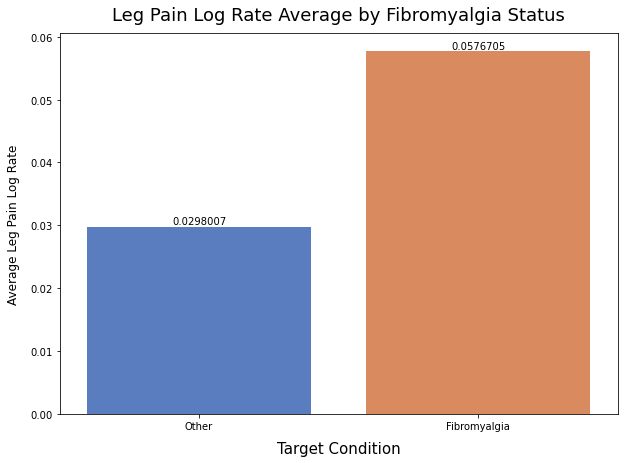

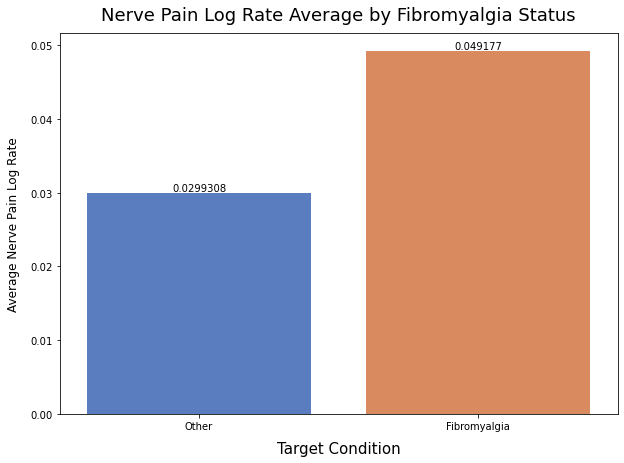

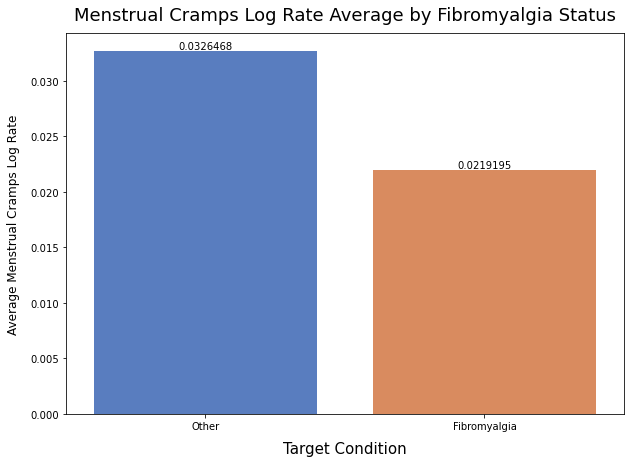

In [44]:
for col in log_rate_list:

    title = col.replace("_", " ").title()

    plt.figure(figsize=(10,7))
    ax = sns.barplot(data=df_binary_other, x='target', y=col, palette='muted', ci=None)
    plt.ylabel(f"Average {title}", size=12, labelpad=10)
    plt.xlabel(f"Target Condition", size=15, labelpad=10)
    plt.xticks((0,1), labels=["Other", "Fibromyalgia"])
    plt.title(f"{title} Average by Fibromyalgia Status", size=18, pad=13)
    for container in ax.containers:
        ax.bar_label(container)
    plt.show()

Some that may be predictive of fibro (some repeated now):

* IBS
* CFS
* PTSD
* Osteoarthritis
* back pain
* muscle pain
* brain fog

# 3. Multiclass Classification Exploration<a class="anchor" id="second-bullet"></a>

In [45]:
df_multi.head(5)

,ids,age,gender,country,target,total_logs,total_unique_dates_days,total_log_rate,conditions_total,fibro_comorbidities,...,mouth_ulcers,mouth_ulcers_total_logs,mouth_ulcers_activity,mouth_ulcers_unique_dates_days,mouth_ulcers_log_rate,blood_pooling,blood_pooling_total_logs,blood_pooling_activity,blood_pooling_unique_dates_days,blood_pooling_log_rate
0,16,42,male,CL,3,5,1,5.0,2,0,...,0,0,0,0,0.0,0,0,0,0,0.0
1,37,46,female,US,3,13,5,2.6,1,1,...,0,0,0,0,0.0,0,0,0,0,0.0
2,137,25,female,SE,3,80,8,10.0,4,0,...,0,0,0,0,0.0,0,0,0,0,0.0
3,140,20,female,US,3,12,1,12.0,1,0,...,0,0,0,0,0.0,0,0,0,0,0.0
4,322,31,female,US,3,42,6,7.0,1,0,...,0,0,0,0,0.0,0,0,0,0,0.0


Adding the categorical target for plotting:

In [46]:
# adding target names for plotting

df_multi_plot = df_multi.copy()

df_multi_plot['Target Condition'] = df_multi_plot['target'].replace({1: 'POTS',
                                                              2: 'Lupus',
                                                              3: 'Autoimmune Arthritis'
                                                              })

df_multi_plot.head(5)

,ids,age,gender,country,target,total_logs,total_unique_dates_days,total_log_rate,conditions_total,fibro_comorbidities,...,mouth_ulcers_total_logs,mouth_ulcers_activity,mouth_ulcers_unique_dates_days,mouth_ulcers_log_rate,blood_pooling,blood_pooling_total_logs,blood_pooling_activity,blood_pooling_unique_dates_days,blood_pooling_log_rate,Target Condition
0,16,42,male,CL,3,5,1,5.0,2,0,...,0,0,0,0.0,0,0,0,0,0.0,Autoimmune Arthritis
1,37,46,female,US,3,13,5,2.6,1,1,...,0,0,0,0.0,0,0,0,0,0.0,Autoimmune Arthritis
2,137,25,female,SE,3,80,8,10.0,4,0,...,0,0,0,0.0,0,0,0,0,0.0,Autoimmune Arthritis
3,140,20,female,US,3,12,1,12.0,1,0,...,0,0,0,0.0,0,0,0,0,0.0,Autoimmune Arthritis
4,322,31,female,US,3,42,6,7.0,1,0,...,0,0,0,0.0,0,0,0,0,0.0,Autoimmune Arthritis


## a. Age by Target<a class="anchor" id="second-bullet1"></a>

In [47]:
df_multi_plot.groupby(by='Target Condition').age.mean()

Target Condition
Autoimmune Arthritis    37.691641
Lupus                   35.969412
POTS                    28.612539
Name: age, dtype: float64

Ae is import for autoimmune arthritis:

In [48]:
df_multi_plot.groupby(by='Target Condition').age.describe()

,count,mean,std,min,25%,50%,75%,max
Target Condition,,,,,,,,
Autoimmune Arthritis,1615.0,37.691641,10.797805,18.0,30.0,36.0,45.0,76.0
Lupus,1275.0,35.969412,10.081372,18.0,28.0,34.0,43.0,75.0
POTS,2217.0,28.612539,8.704022,18.0,21.0,27.0,34.0,71.0


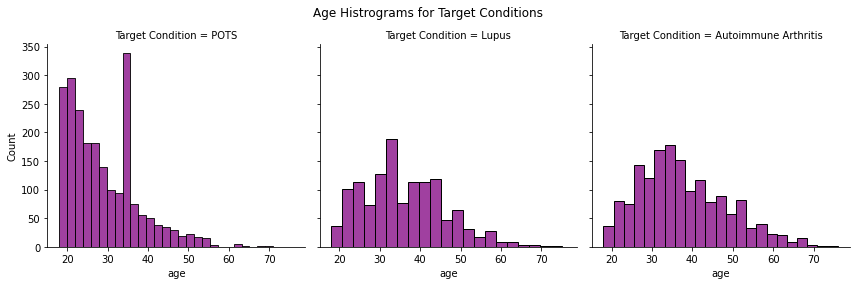

In [49]:

g = sns.FacetGrid(df_multi_plot, col="Target Condition", col_order=['POTS', 'Lupus', 'Autoimmune Arthritis'], size=4, height=10, aspect=1)
g.map_dataframe(sns.histplot, x="age", color="purple")
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Age Histrograms for Target Conditions')

plt.show()

## b. Gender by Target<a class="anchor" id="second-bullet2"></a>

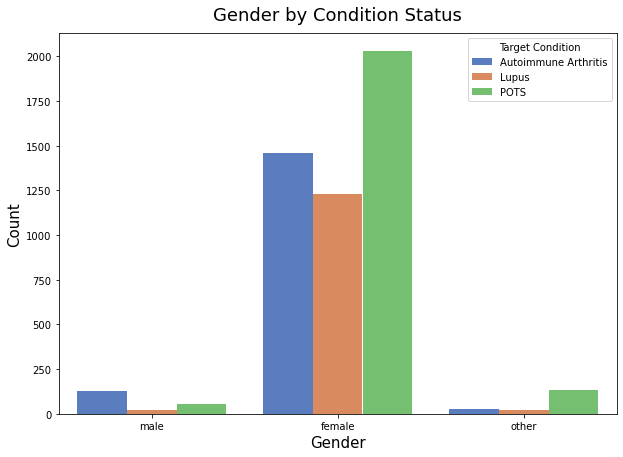

In [122]:
plt.figure(figsize=(10,7))
sns.countplot(data=df_multi_plot, x='gender', hue='Target Condition', palette="muted")
plt.title('Gender by Condition Status', size=18, pad=13)
plt.xlabel('Gender', size=15)
plt.ylabel('Count', size=15)
plt.show()

Seems like other might be important for lupus and arthritis

## c. Total Logs<a class="anchor" id="second-bullet3"></a>

In [51]:
df_multi_plot.groupby(by='Target Condition').total_logs.describe()

,count,mean,std,min,25%,50%,75%,max
Target Condition,,,,,,,,
Autoimmune Arthritis,1615.0,80.234675,307.330330,1.0,5.0,11.0,36.0,6354.0
Lupus,1275.0,74.138824,280.901311,1.0,4.0,10.0,30.0,4910.0
POTS,2217.0,138.184484,665.984833,1.0,8.0,20.0,66.0,16874.0


Many more logs for POTS users:

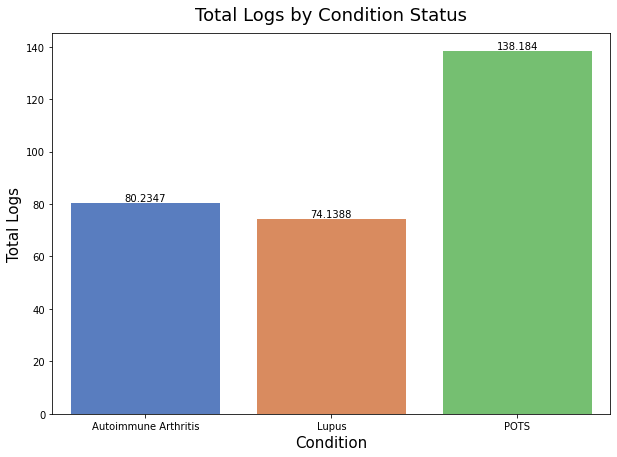

In [52]:
plt.figure(figsize=(10,7))
ax = sns.barplot(data=df_multi_plot, x='Target Condition', y='total_logs', palette='muted', ci=None)
plt.xlabel('Condition', size=15)
plt.ylabel('Total Logs', size=15)
plt.title('Total Logs by Condition Status', size=18, pad=13)
for container in ax.containers:
        ax.bar_label(container)
plt.show()

Seems like this is due to outliers!

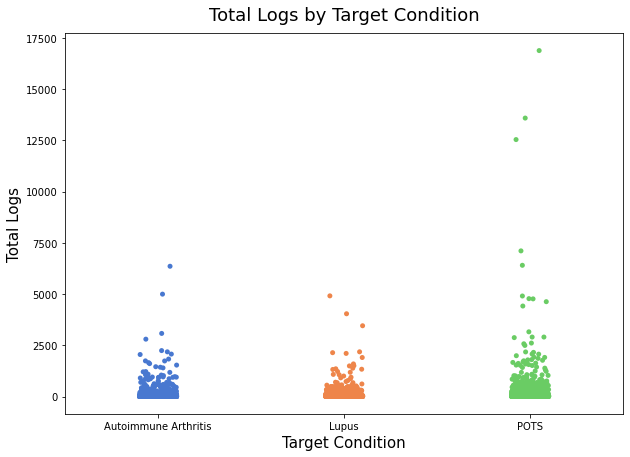

In [53]:
plt.figure(figsize=(10,7))
sns.stripplot(data=df_multi_plot, x='Target Condition', y='total_logs', palette='muted')
plt.xlabel('Target Condition', size=15)
plt.ylabel('Total Logs', size=15)
plt.title('Total Logs by Target Condition', size=18, pad=13)
plt.show()

## d. Total Unique Dates Days<a class="anchor" id="second-bullet4"></a>

Adding a date category

In [54]:
df_multi_plot['Total Logging Time'] = df_multi_plot['total_unique_dates_days'].replace({1: 'Single Time Users',
                                                              range(2,8): 'Up to One Week',
                                                              range(8, 15): 'Up to Two Weeks',
                                                              range(15,900): 'More Than Two Weeks'})

In [55]:
df_multi_plot.head(5)

,ids,age,gender,country,target,total_logs,total_unique_dates_days,total_log_rate,conditions_total,fibro_comorbidities,...,mouth_ulcers_activity,mouth_ulcers_unique_dates_days,mouth_ulcers_log_rate,blood_pooling,blood_pooling_total_logs,blood_pooling_activity,blood_pooling_unique_dates_days,blood_pooling_log_rate,Target Condition,Total Logging Time
0,16,42,male,CL,3,5,1,5.0,2,0,...,0,0,0.0,0,0,0,0,0.0,Autoimmune Arthritis,Single Time Users
1,37,46,female,US,3,13,5,2.6,1,1,...,0,0,0.0,0,0,0,0,0.0,Autoimmune Arthritis,Up to One Week
2,137,25,female,SE,3,80,8,10.0,4,0,...,0,0,0.0,0,0,0,0,0.0,Autoimmune Arthritis,Up to Two Weeks
3,140,20,female,US,3,12,1,12.0,1,0,...,0,0,0.0,0,0,0,0,0.0,Autoimmune Arthritis,Single Time Users
4,322,31,female,US,3,42,6,7.0,1,0,...,0,0,0.0,0,0,0,0,0.0,Autoimmune Arthritis,Up to One Week


Checking unique dates, POTS log for more dates, lupus least:

In [56]:
df_multi_plot.groupby(by='Target Condition').total_unique_dates_days.describe()

,count,mean,std,min,25%,50%,75%,max
Target Condition,,,,,,,,
Autoimmune Arthritis,1615.0,9.206811,30.359953,1.0,1.0,2.0,5.0,654.0
Lupus,1275.0,7.935686,24.125209,1.0,1.0,2.0,4.0,439.0
POTS,2217.0,11.710871,47.188106,1.0,1.0,2.0,7.0,1136.0


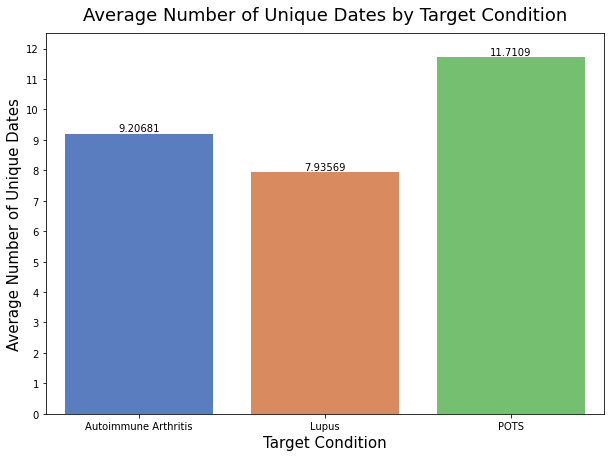

In [123]:
plt.figure(figsize=(10,7))
ax = sns.barplot(data=df_multi_plot, x='Target Condition', y= 'total_unique_dates_days', palette='muted', ci=None)
plt.xlabel('Target Condition', size=15)
plt.ylabel('Average Number of Unique Dates', size=15)
plt.title('Average Number of Unique Dates by Target Condition', size=18, pad=13)
plt.ylim(0,12.5)
plt.yticks((np.arange(0,13)))
for container in ax.containers:
        ax.bar_label(container)
plt.show()

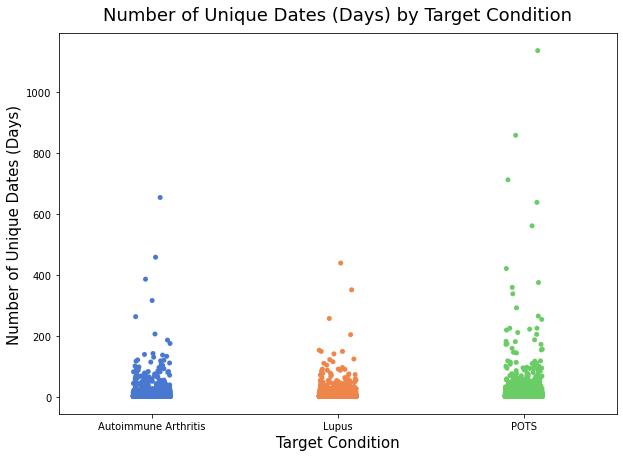

In [58]:
plt.figure(figsize=(10,7))
sns.stripplot(data=df_multi_plot, x='Target Condition', y= 'total_unique_dates_days', palette='muted')
plt.xlabel('Target Condition', size=15)
plt.ylabel('Number of Unique Dates (Days)', size=15)
plt.title('Number of Unique Dates (Days) by Target Condition', size=18, pad=13)
plt.show()

Yeah, seemed like logging time has to due with outliers:

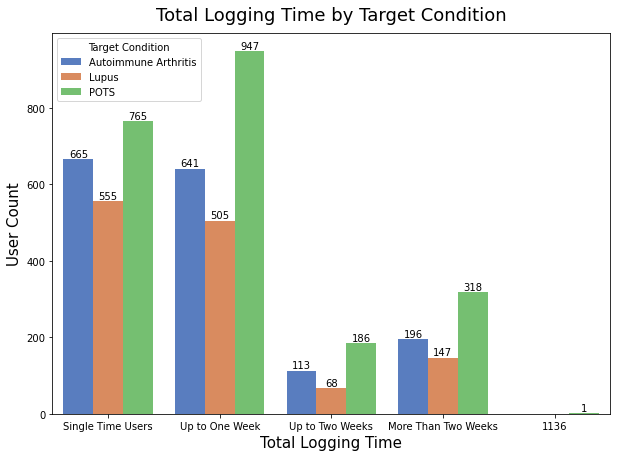

In [59]:
plt.figure(figsize=(10,7))
ax = sns.countplot(data=df_multi_plot, x='Total Logging Time', hue='Target Condition',  palette='muted')
plt.xlabel('Total Logging Time', size=15)
plt.ylabel('User Count', size=15)
plt.title('Total Logging Time by Target Condition', size=18, pad=13)
for container in ax.containers:
        ax.bar_label(container)
plt.show()

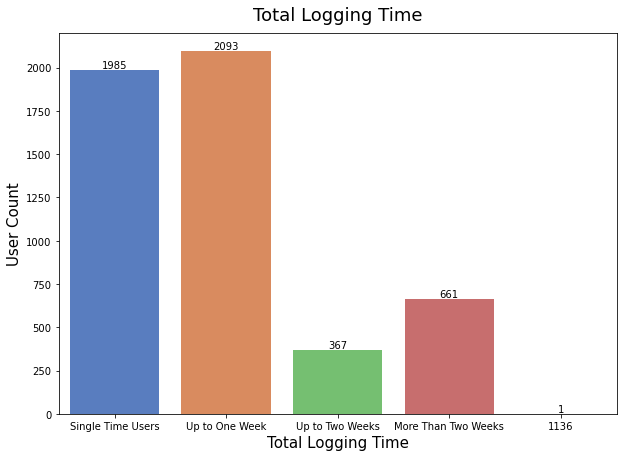

In [60]:
plt.figure(figsize=(10,7))
ax = sns.countplot(data=df_multi_plot, x='Total Logging Time', palette='muted')
plt.xlabel('Total Logging Time', size=15)
plt.ylabel('User Count', size=15)
plt.title('Total Logging Time', size=18, pad=13)
for container in ax.containers:
        ax.bar_label(container)
plt.show()

## e. Logging Rate<a class="anchor" id="second-bullet5"></a>

In [61]:
df_multi_plot.groupby(by='Target Condition').total_log_rate.describe()

,count,mean,std,min,25%,50%,75%,max
Target Condition,,,,,,,,
Autoimmune Arthritis,1615.0,6.561461,4.739406,1.0,3.000000,5.647668,8.594118,42.000000
Lupus,1275.0,6.499500,4.739874,1.0,3.000000,5.000000,8.477273,47.571429
POTS,2217.0,9.430093,5.916391,1.0,5.333333,8.000000,12.000000,54.000000


Pots have higher log rate, lupus and arthritis seem petty similar!

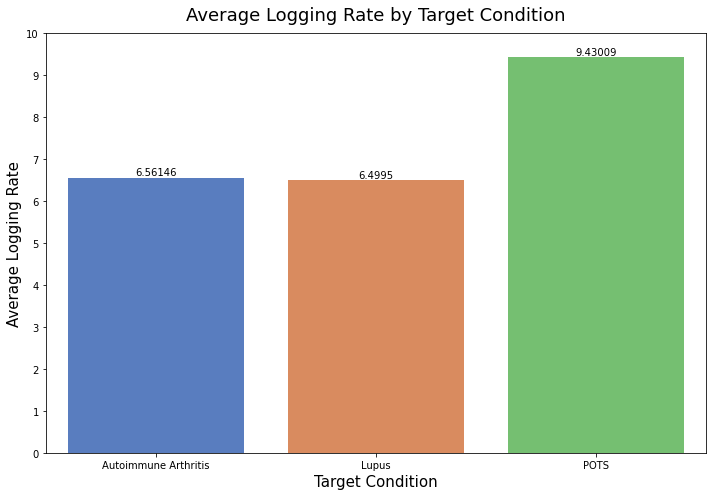

In [132]:
plt.figure(figsize=(10,7))
ax = sns.barplot(data=df_multi_plot, x='Target Condition', y= 'total_log_rate', palette='muted', ci=None)
plt.xlabel('Target Condition', size=15)
plt.ylabel('Average Logging Rate', size=15)
plt.title('Average Logging Rate by Target Condition', size=18, pad=13)
plt.ylim(0,10)
plt.yticks((np.arange(0,11, step=1)))
plt.tight_layout()
for container in ax.containers:
        ax.bar_label(container)
plt.savefig('3-EDA Images and Figures/AvgLogRateMulti.png')
plt.show()

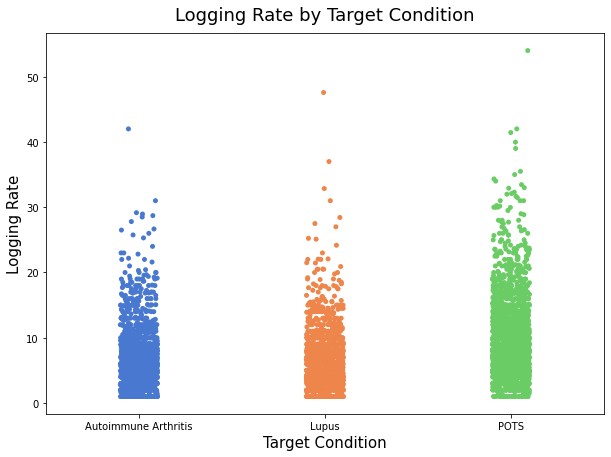

In [63]:
plt.figure(figsize=(10,7))
sns.stripplot(data=df_multi_plot, x='Target Condition', y= 'total_log_rate', palette='muted')
plt.xlabel('Target Condition', size=15)
plt.ylabel('Logging Rate', size=15)
plt.title('Logging Rate by Target Condition', size=18, pad=13)
plt.show()

## f. Conditions Total<a class="anchor" id="second-bullet6"></a>

In [64]:
df_multi_plot.groupby(by='Target Condition').conditions_total.describe()

,count,mean,std,min,25%,50%,75%,max
Target Condition,,,,,,,,
Autoimmune Arthritis,1615.0,1.427245,1.592890,0.0,0.0,1.0,2.0,10.0
Lupus,1275.0,1.299608,1.507061,0.0,0.0,1.0,2.0,10.0
POTS,2217.0,2.389716,1.854510,0.0,1.0,2.0,3.0,11.0


Yeah, conditions total will be predictive for POTS:

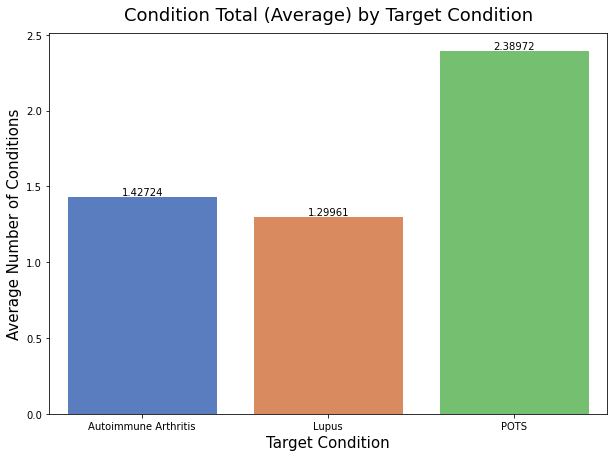

In [65]:
plt.figure(figsize=(10,7))
ax = sns.barplot(data=df_multi_plot, x='Target Condition', y= 'conditions_total', palette='muted', ci=None)
plt.xlabel('Target Condition', size=15)
plt.ylabel('Average Number of Conditions', size=15)
plt.title('Condition Total (Average) by Target Condition', size=18, pad=13)
for container in ax.containers:
        ax.bar_label(container)
plt.show()

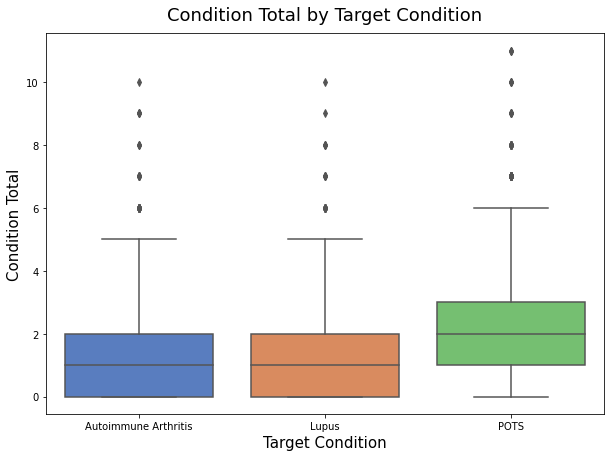

In [66]:
plt.figure(figsize=(10,7))
sns.boxplot(data=df_multi_plot, x='Target Condition', y= 'conditions_total', palette='muted')
plt.xlabel('Target Condition', size=15)
plt.ylabel('Condition Total', size=15)
plt.title('Condition Total by Target Condition', size=18, pad=13)
plt.show()

## g. Symptoms Total<a class="anchor" id="second-bullet7"></a>

In [67]:
df_multi_plot.groupby(by='Target Condition').symptoms_total.describe()

,count,mean,std,min,25%,50%,75%,max
Target Condition,,,,,,,,
Autoimmune Arthritis,1615.0,5.195046,3.737810,0.0,2.0,4.0,7.0,35.0
Lupus,1275.0,5.609412,4.211956,0.0,3.0,5.0,7.0,37.0
POTS,2217.0,7.568336,4.943266,0.0,4.0,6.0,10.0,41.0


Again POTS seems really distinct, lupus and arthritis not so much!

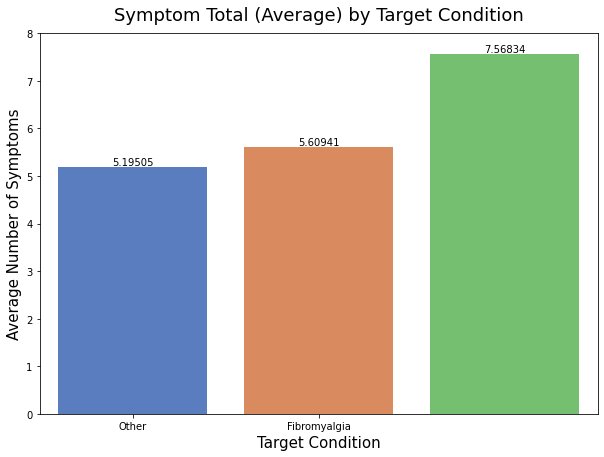

In [68]:

plt.figure(figsize=(10,7))
ax= sns.barplot(data=df_multi_plot, x='Target Condition', y= 'symptoms_total', palette='muted', ci=None)
plt.xticks((0,1), labels=['Other', 'Fibromyalgia'])
plt.xlabel('Target Condition', size=15)
plt.ylabel('Average Number of Symptoms', size=15)
plt.ylim(0,8)
plt.title('Symptom Total (Average) by Target Condition', size=18, pad=13)
for container in ax.containers:
        ax.bar_label(container)
plt.show()

Symptom total important for POTS, they have more symptoms!

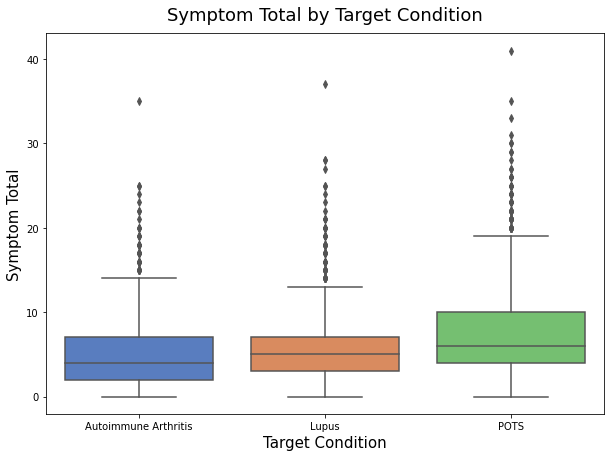

In [69]:
plt.figure(figsize=(10,7))
sns.boxplot(data=df_multi_plot, x='Target Condition', y= 'symptoms_total', palette='muted')
plt.xlabel('Target Condition', size=15)
plt.ylabel('Symptom Total', size=15)
plt.title('Symptom Total by Target Condition', size=18, pad=13)
plt.show()

## i. Symptom and Condition Binaries<a class="anchor" id="second-bullet9"></a>

Here, I am going to visualize each condition / symptom variable separately (binary, total logs, unique days, logging rate), using a for loop. First, I will remove the basic variables:

In [70]:
df_multi_plot_other = df_multi_plot.copy()

df_multi_plot_other .drop(columns=['ids',
 'age',
 'gender',
 'country',
 'total_logs',
 'total_unique_dates_days',
 'total_log_rate',
 'conditions_total',
 'symptoms_total',
 'fibro_comorbidities'], inplace=True)

df_multi_plot_other.columns

Index(['target', 'hypothyroidism', 'hypothyroidism_total_logs',
       'hypothyroidism_activity', 'hypothyroidism_unique_dates_days',
       'hypothyroidism_log_rate', 'insomnia', 'insomnia_total_logs',
       'insomnia_activity', 'insomnia_unique_dates_days',
       ...
       'mouth_ulcers_activity', 'mouth_ulcers_unique_dates_days',
       'mouth_ulcers_log_rate', 'blood_pooling', 'blood_pooling_total_logs',
       'blood_pooling_activity', 'blood_pooling_unique_dates_days',
       'blood_pooling_log_rate', 'Target Condition', 'Total Logging Time'],
      dtype='object', length=448)

Now I am going to make separate lists in order to iterate over them for each category of feature:

In [71]:
# target lists
total_logs_list2 = list()
activity_list2 = list()
days_list2 = list()
log_rate_list2 = list()
binaries2 = list()

# all the columns to choose from
all_cols2 = list(df_multi_plot_other.columns)

# choosing the right features, putting them into lists
for col in all_cols2:
    if 'total_logs' in col:
        total_logs_list2.append(col)
    elif 'activity' in col:
        activity_list2.append(col)
    elif 'unique' in col:
        days_list2.append(col)
    elif 'log_rate' in col:
        log_rate_list2.append(col)

print(len(total_logs_list2))
print(len(activity_list2))
print(len(days_list2))
print(len(log_rate_list2))

# selecting the binary columns and appending them
no_these2 = total_logs_list2 + activity_list2 + days_list2 + log_rate_list2

for col in all_cols2:
    if col not in no_these2:
        binaries2.append(col)

# checking the lengths
print(len(binaries2))

89
89
89
89
92


### i. Condition and Symptom Binaries<a class="anchor" id="second-bullet9i"></a>

Writing the for loop, iterating through to graph each one:

In [72]:
binaries2

['target',
 'hypothyroidism',
 'insomnia',
 'depression',
 'ehlers-danlos_syndrome',
 'gerd',
 'psoriasis',
 'irritable_bowel_syndrome',
 'endometriosis',
 'post-traumatic_stress_disorder',
 'fibromyalgia',
 'chronic_fatigue_syndrome',
 'osteoarthritis',
 'generalized_anxiety_disorder',
 "sjogren's_syndrome",
 'arthritis',
 'anxiety',
 'asthma',
 'polycystic_ovary_syndrome_(pcos)',
 'allergies',
 "raynaud's_disease",
 'gastroparesis',
 'mast_cell_activation_syndrome',
 'myalgic_encephalomyelitis',
 'dysautonomia',
 'headache',
 'fatigue',
 'stomach_pain',
 'chronic_pain',
 'numbness_and_tingling',
 'dizziness_or_vertigo',
 'joint_pain',
 'hand_pain',
 'foot_pain',
 'inflammation',
 'syncope',
 'migraine',
 'vomiting',
 'stomach_cramps',
 'nausea',
 'back_pain',
 'brain_fog',
 'swelling',
 'stiffness',
 'constipation',
 'bloating',
 'lightheadedness',
 'elbow_pain',
 'hip_pain',
 'rash',
 'neck_pain',
 'sacroiliac_joint_pain',
 'shortness_of_breath',
 'weakness',
 'fever',
 'wrist_pain'

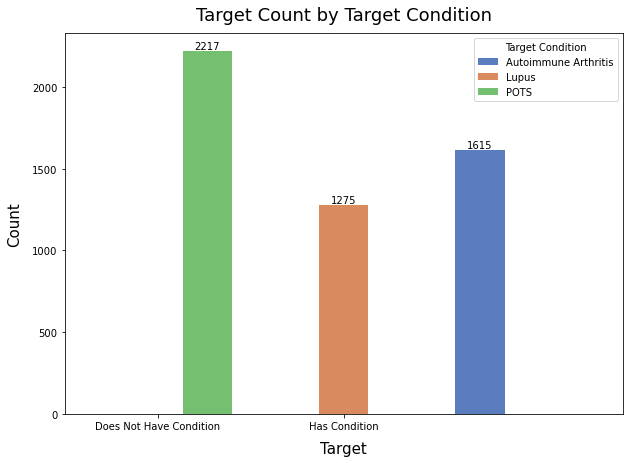

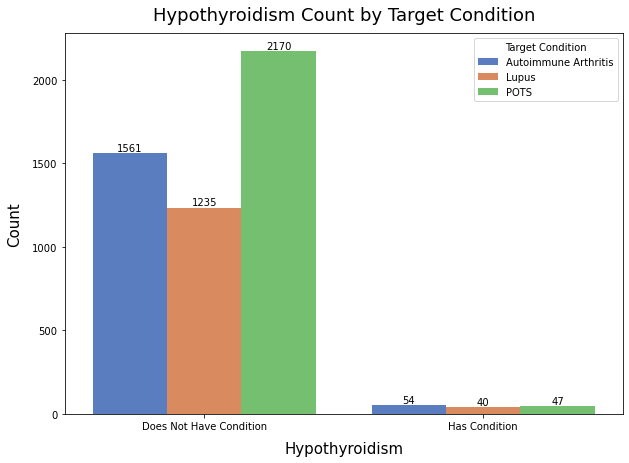

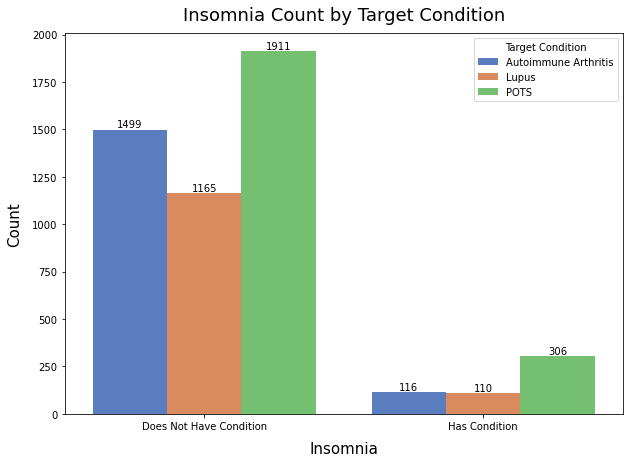

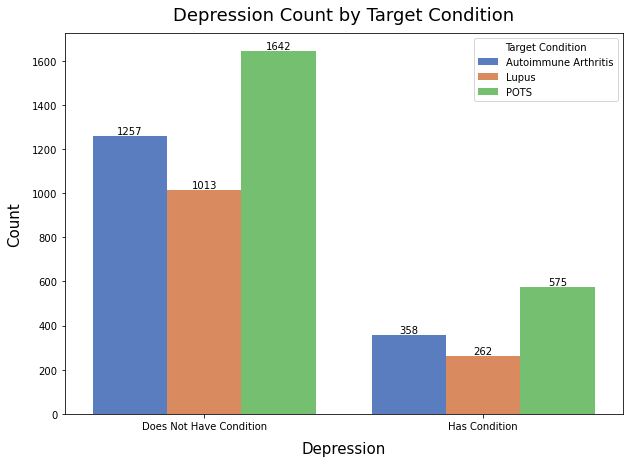

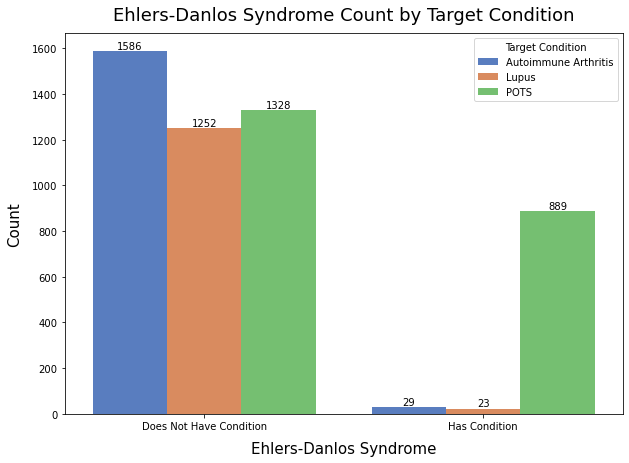

...

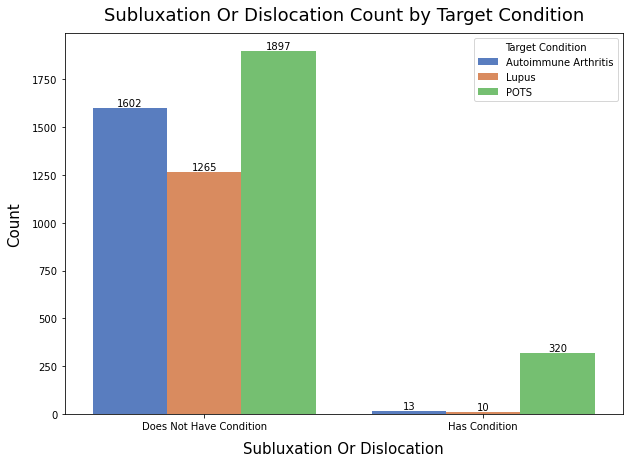

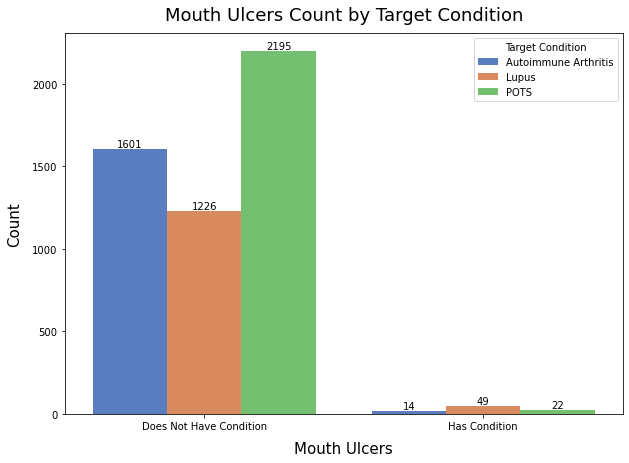

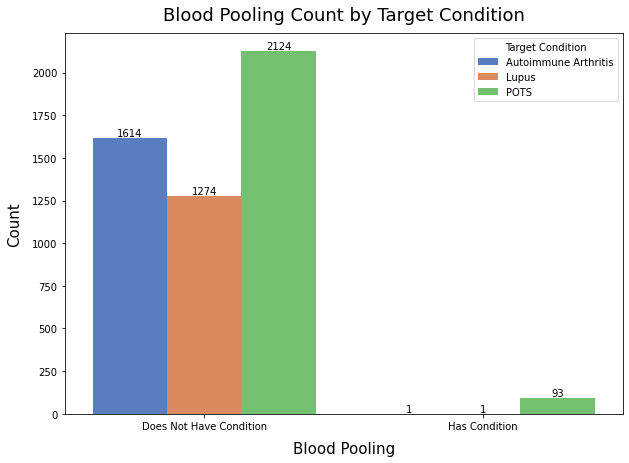

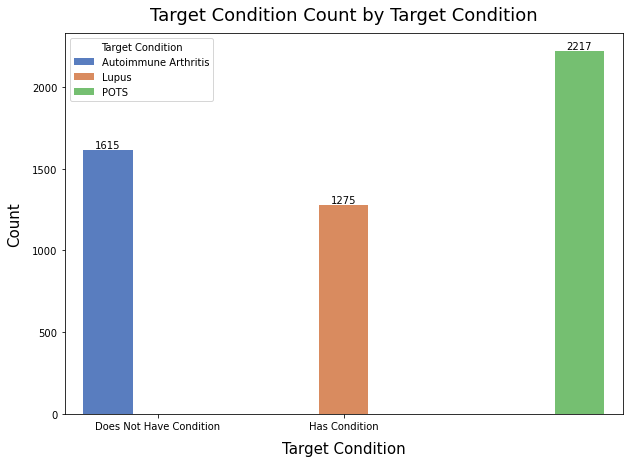

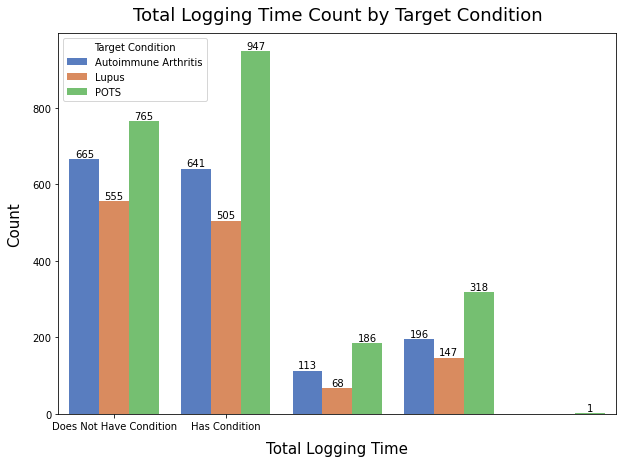

In [73]:
for col in binaries2:

    title = col.replace("_", " ").title()

    plt.figure(figsize=(10,7))
    ax = sns.countplot(data=df_multi_plot_other, x=col, hue='Target Condition', palette='muted')
    plt.ylabel("Count", size=15, labelpad=10)
    plt.xlabel(title, size=15, labelpad=10)
    plt.xticks((0,1), labels=["Does Not Have Condition", 'Has Condition'])
    plt.title(f"{title} Count by Target Condition", size=18, pad=13)
    for container in ax.containers:
        ax.bar_label(container)
    plt.show()

Psoriasis predictive of arthritis. CFS for POTS

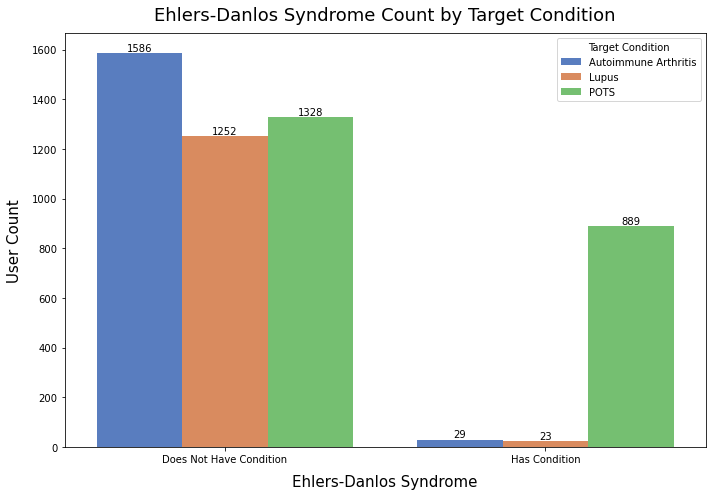

In [133]:
plt.figure(figsize=(10,7))
ax = sns.countplot(data=df_multi_plot_other, x='ehlers-danlos_syndrome', hue='Target Condition', palette='muted')
plt.ylabel("User Count", size=15, labelpad=10)
plt.xlabel('Ehlers-Danlos Syndrome', size=15, labelpad=10)
plt.xticks((0,1), labels=["Does Not Have Condition", 'Has Condition'])
plt.title(f"Ehlers-Danlos Syndrome Count by Target Condition", size=18, pad=13)
plt.tight_layout()
for container in ax.containers:
    ax.bar_label(container)
plt.savefig('3-EDA Images and Figures/EDSCount.png')
plt.show()

### iii. Condition and Symptom Activity (Median Trackable Value)<a class="anchor" id="second-bullet9iii"></a>

In [74]:
activity_list2

['hypothyroidism_activity',
 'insomnia_activity',
 'depression_activity',
 'ehlers-danlos_syndrome_activity',
 'gerd_activity',
 'psoriasis_activity',
 'irritable_bowel_syndrome_activity',
 'endometriosis_activity',
 'post-traumatic_stress_disorder_activity',
 'fibromyalgia_activity',
 'chronic_fatigue_syndrome_activity',
 'osteoarthritis_activity',
 'generalized_anxiety_disorder_activity',
 "sjogren's_syndrome_activity",
 'arthritis_activity',
 'anxiety_activity',
 'asthma_activity',
 'polycystic_ovary_syndrome_(pcos)_activity',
 'allergies_activity',
 "raynaud's_disease_activity",
 'gastroparesis_activity',
 'mast_cell_activation_syndrome_activity',
 'myalgic_encephalomyelitis_activity',
 'dysautonomia_activity',
 'headache_activity',
 'fatigue_activity',
 'stomach_pain_activity',
 'chronic_pain_activity',
 'numbness_and_tingling_activity',
 'dizziness_or_vertigo_activity',
 'joint_pain_activity',
 'hand_pain_activity',
 'foot_pain_activity',
 'inflammation_activity',
 'syncope_activ

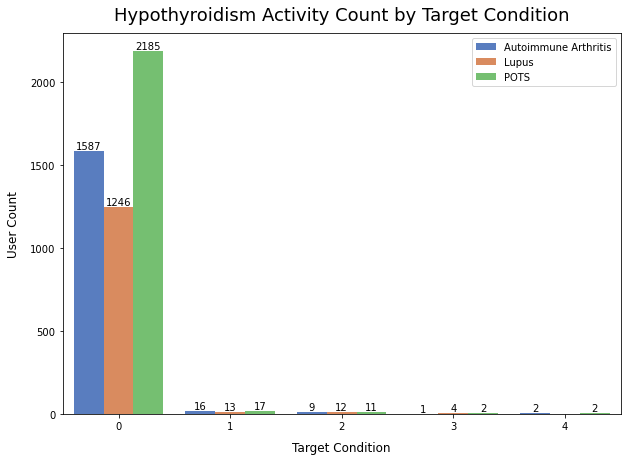

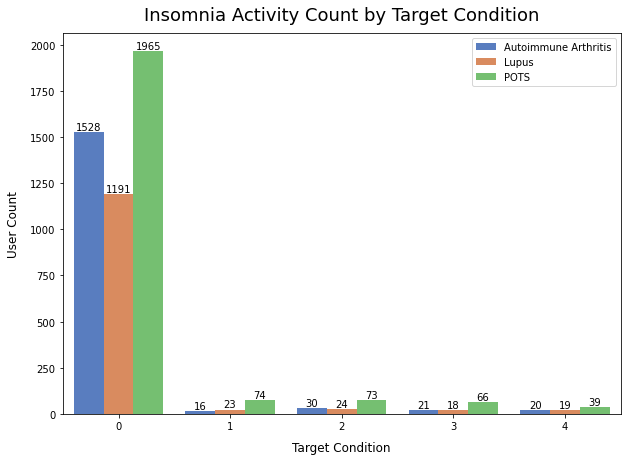

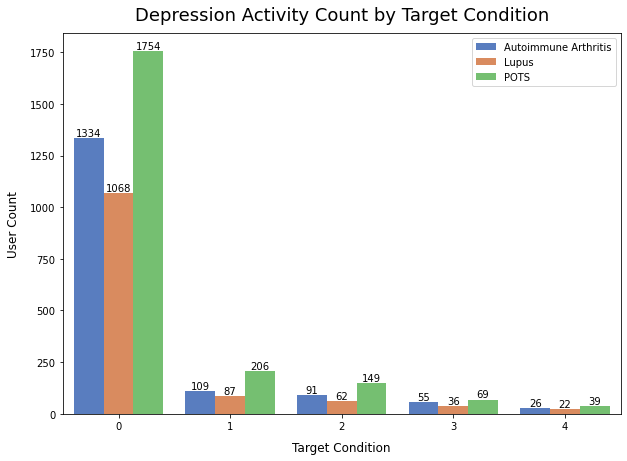

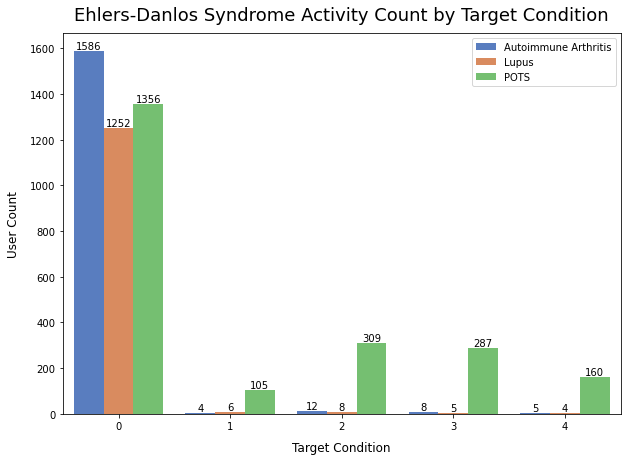

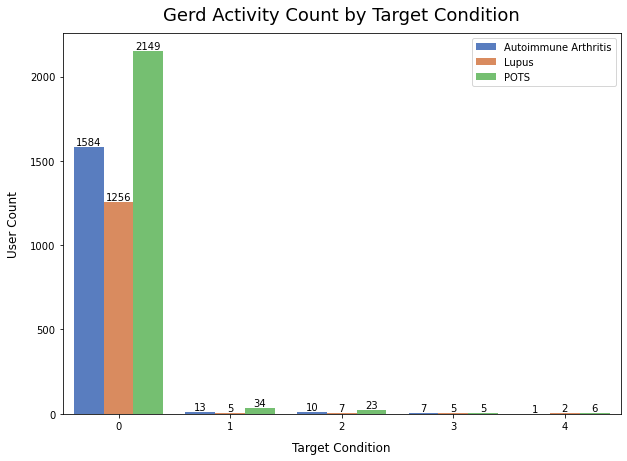

...

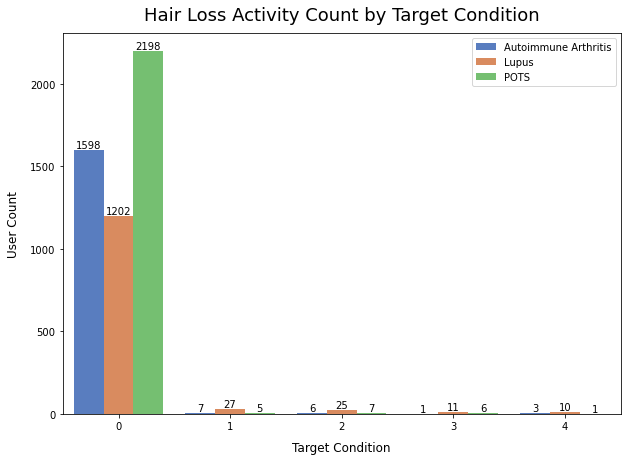

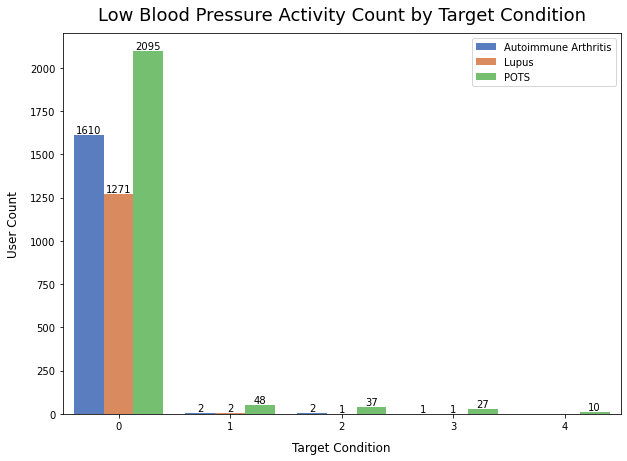

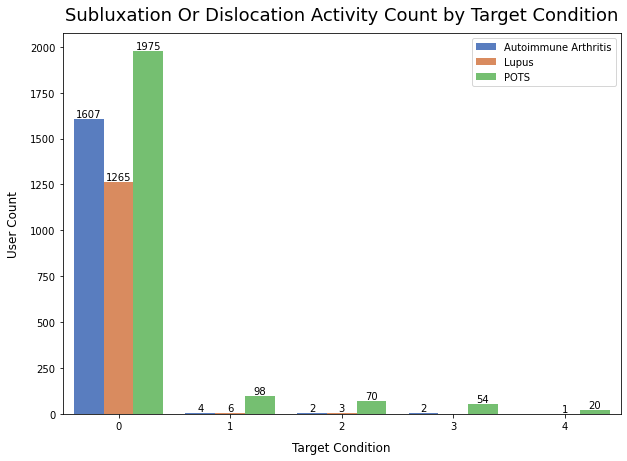

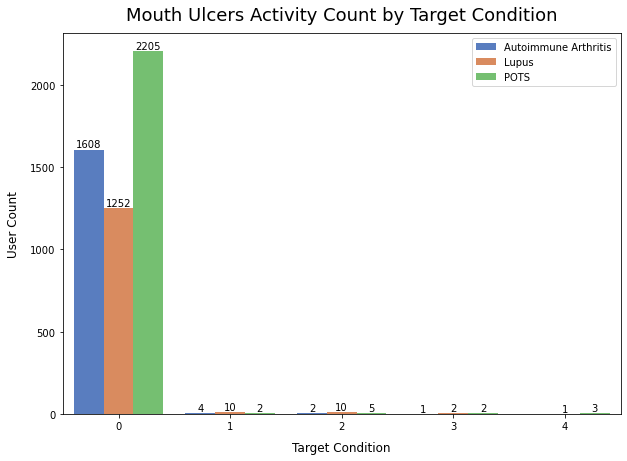

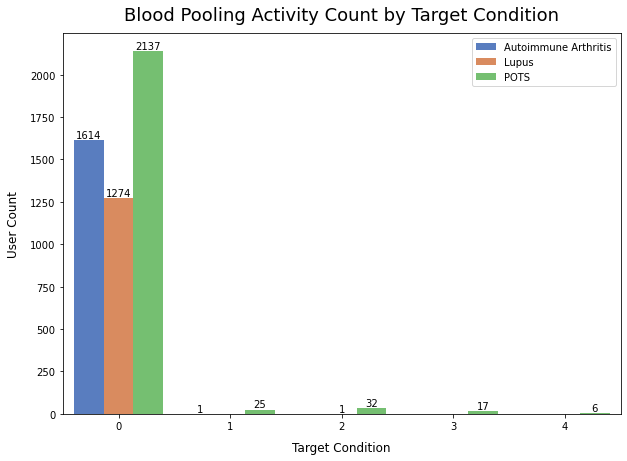

In [75]:
for col in activity_list2:

    title = col.replace("_", " ").title()

    plt.figure(figsize=(10,7))
    ax = sns.countplot(data=df_multi_plot_other, x=col, hue='Target Condition', palette='muted')
    plt.ylabel(f"User Count", size=12, labelpad=10)
    plt.xlabel("Target Condition", size=12, labelpad=10)
    # plt.xticks((0,1,3,4), labels=["Other", 'Fibromyalgia'])
    plt.title(f"{title} Count by Target Condition", size=18, pad=13)
    plt.legend(loc='upper right')
    for container in ax.containers:
        ax.bar_label(container)
    
    plt.show()

Dizziness very much predictive of POTS

Drop the zeros

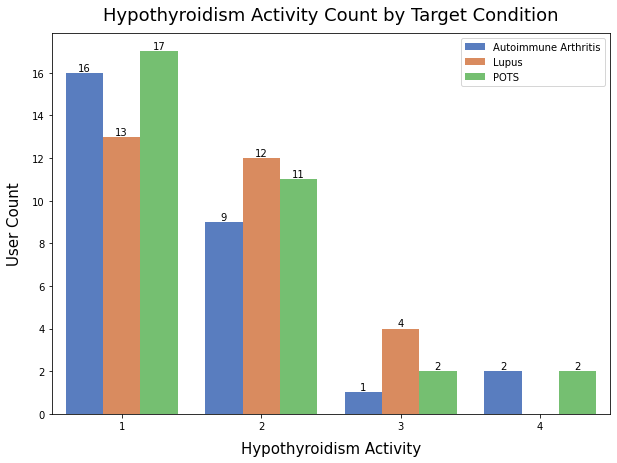

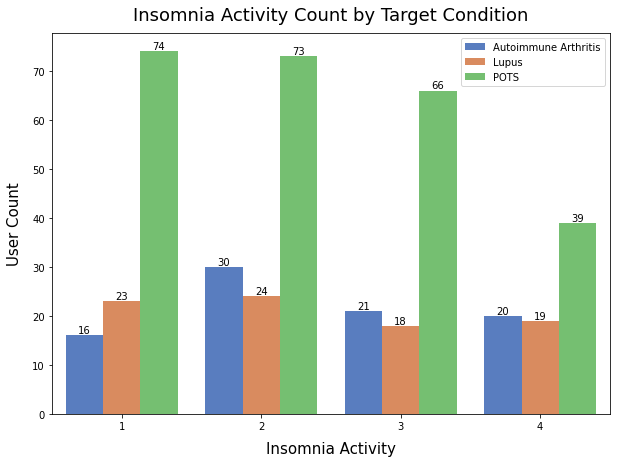

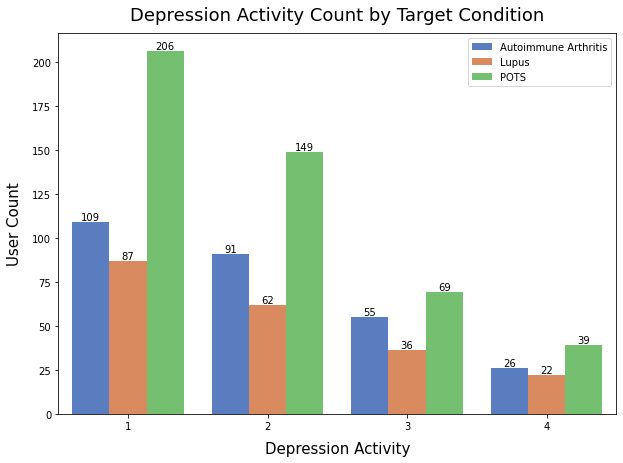

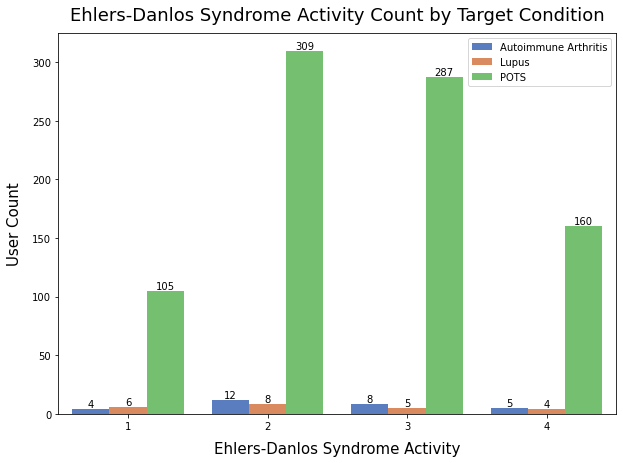

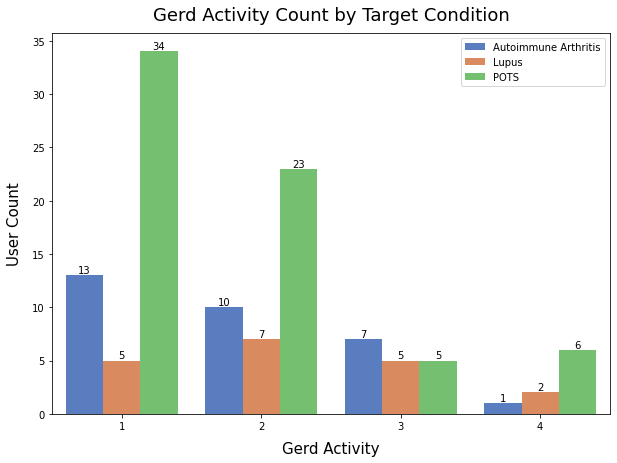

...

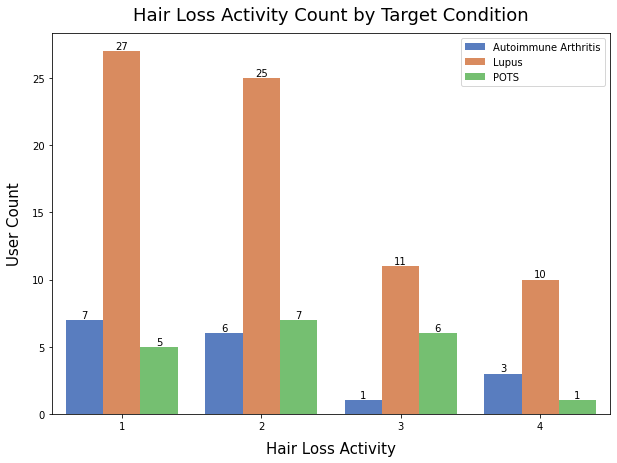

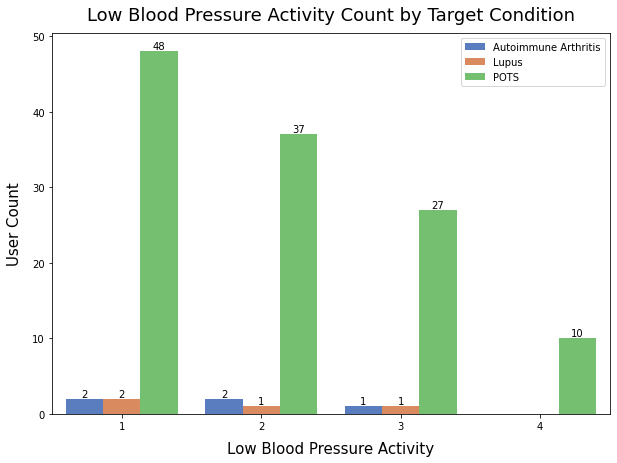

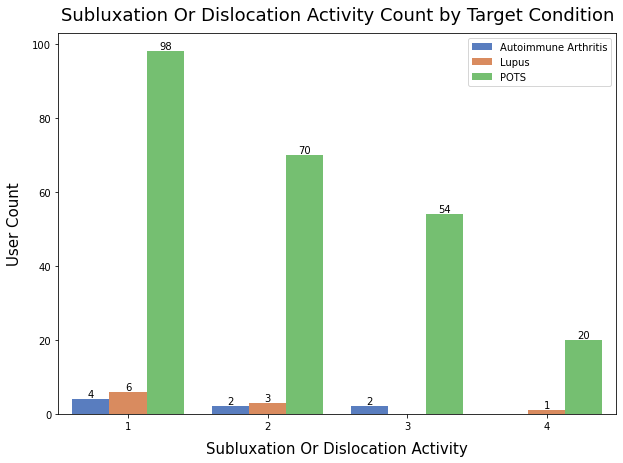

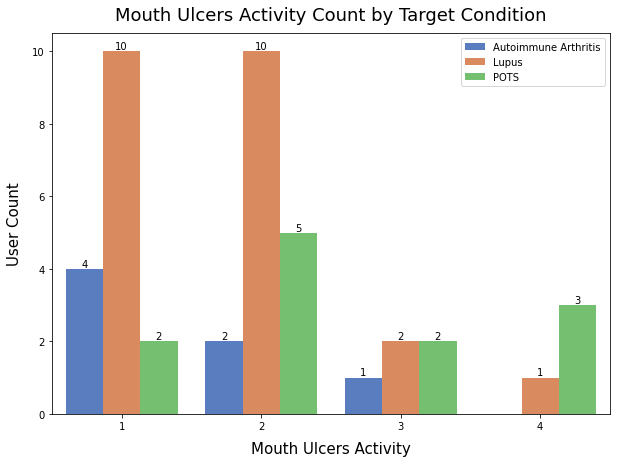

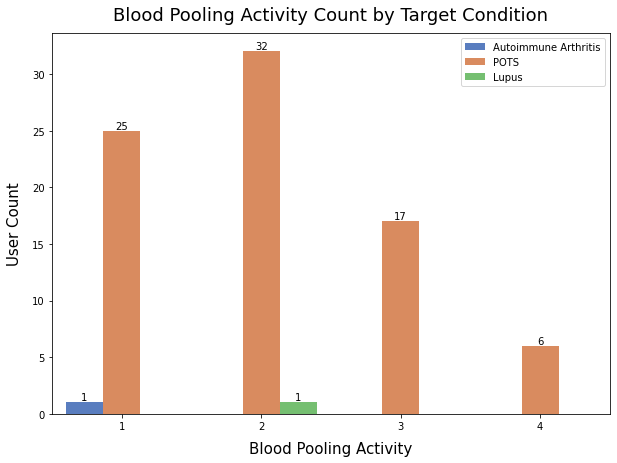

In [76]:
for col in activity_list2:

    #try to drop the zeros
    df_act2 = df_multi_plot_other[df_multi_plot_other[col] != 0]

    title = col.replace("_", " ").title()

    plt.figure(figsize=(10,7))
    ax = sns.countplot(data=df_act2, x=col, hue='Target Condition', palette='muted')
    plt.ylabel("User Count", size=15, labelpad=10)
    plt.xlabel(f"{title}", size=15, labelpad=10)
    plt.title(f"{title} Count by Target Condition", size=18, pad=13)
    plt.legend(loc='upper right')
    for container in ax.containers:
        ax.bar_label(container)
    plt.show()

Many conditions seem predictive of POTS, not so much for lupus and arthritis.

Show the average Activity Without Zeros Included:

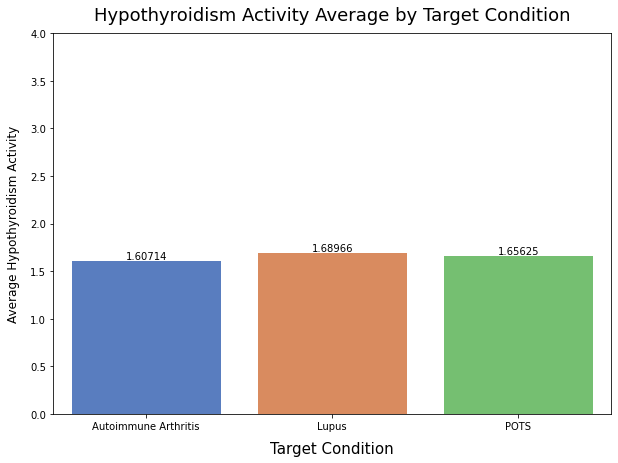

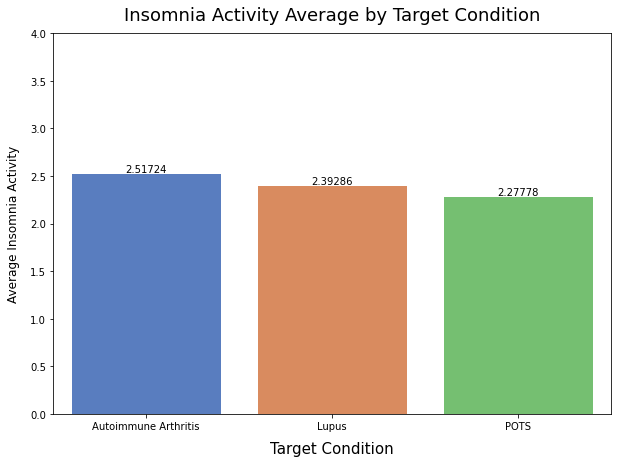

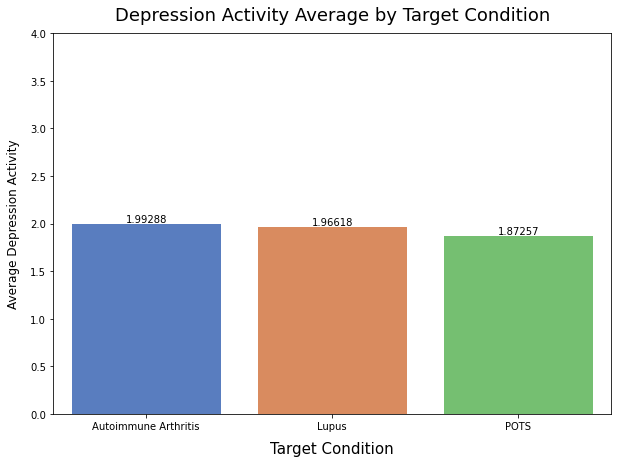

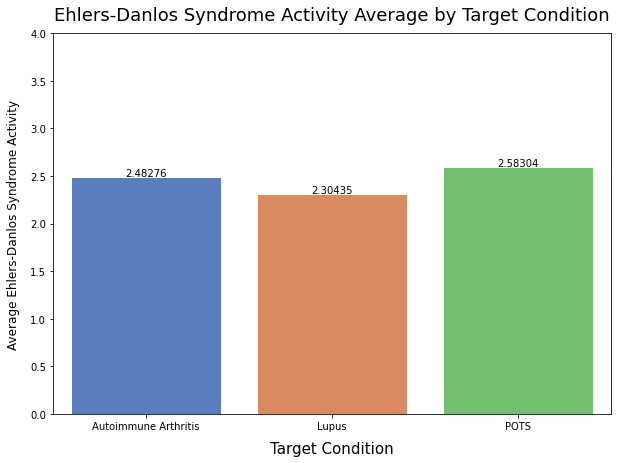

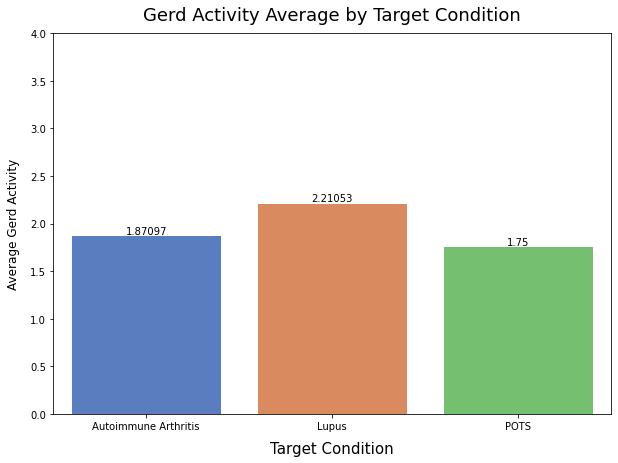

...

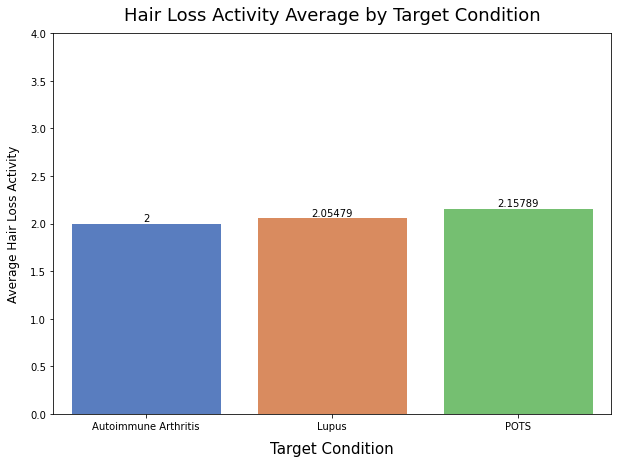

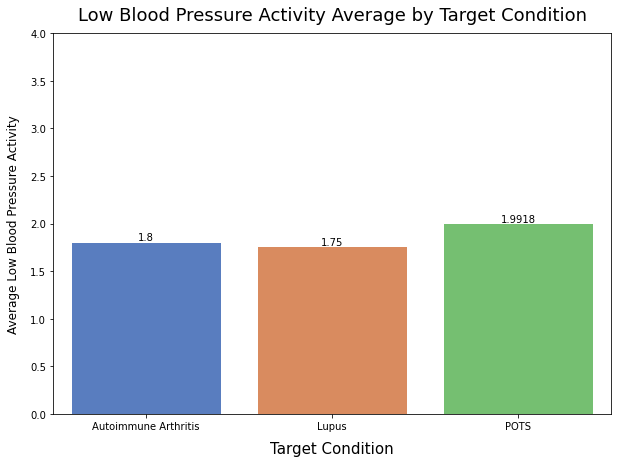

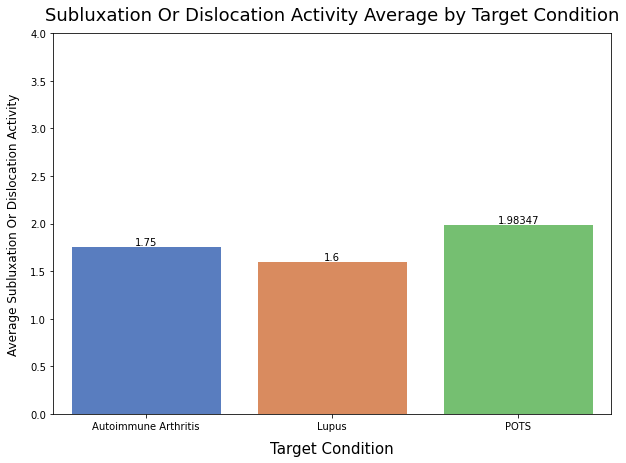

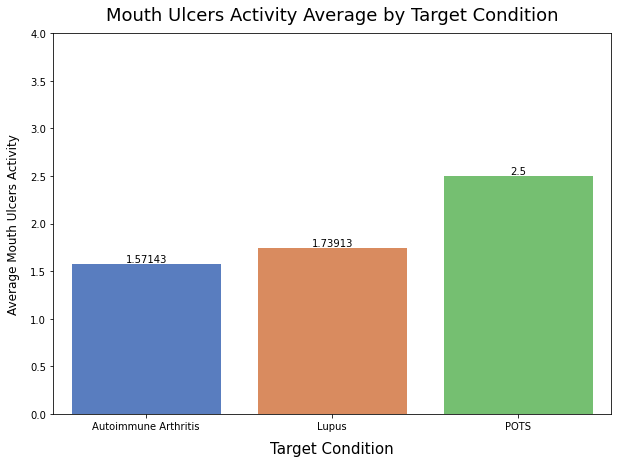

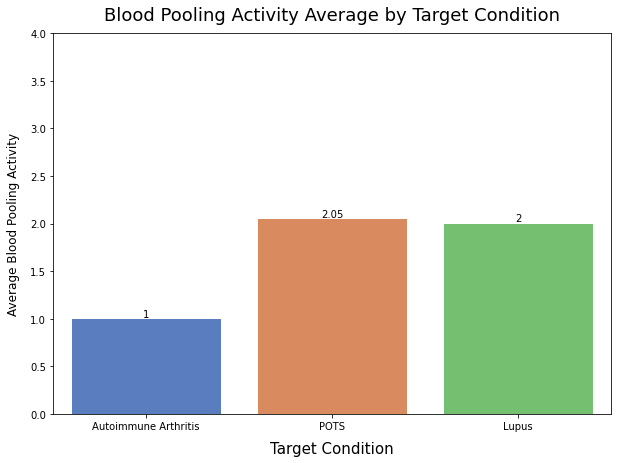

In [77]:
for col in activity_list2:

    #try to drop the zeros
    df_act2 = df_multi_plot_other[df_multi_plot_other[col] != 0]

    title = col.replace("_", " ").title()

    plt.figure(figsize=(10,7))
    ax= sns.barplot(data=df_act2, x='Target Condition', y=col, palette='muted', ci=None)
    plt.ylabel(f"Average {title}", size=12, labelpad=10)
    plt.xlabel(f"Target Condition", size=15, labelpad=10)
    plt.ylim(0,4)
    plt.title(f"{title} Average by Target Condition", size=18, pad=13)
    for container in ax.containers:
        ax.bar_label(container)
    plt.show()

### iv. Unique Logging Days<a class="anchor" id="second-bullet9iv"></a>

**Stripplot**

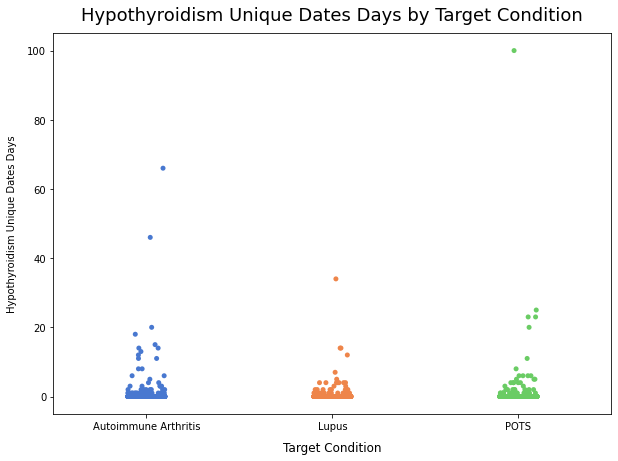

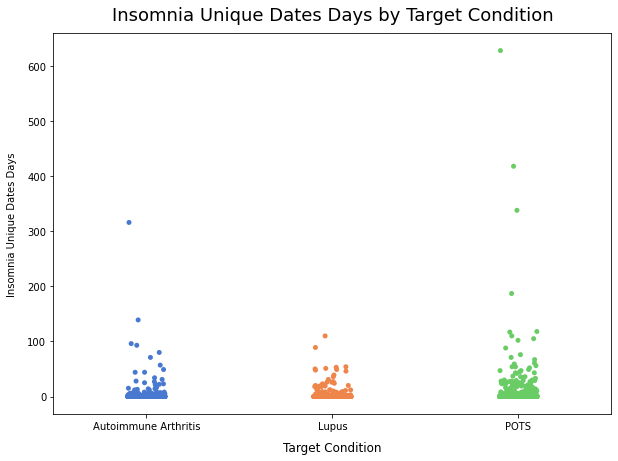

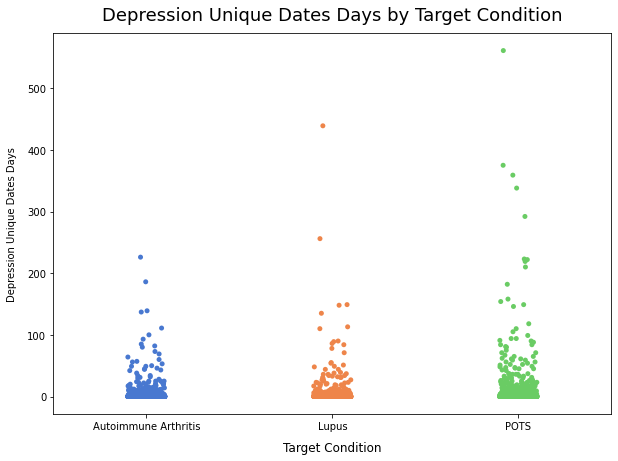

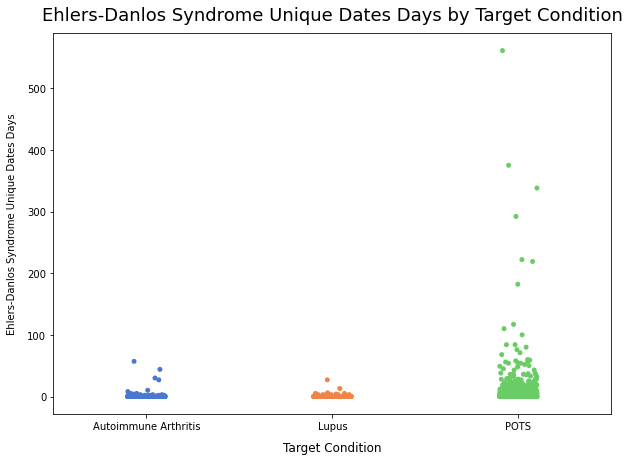

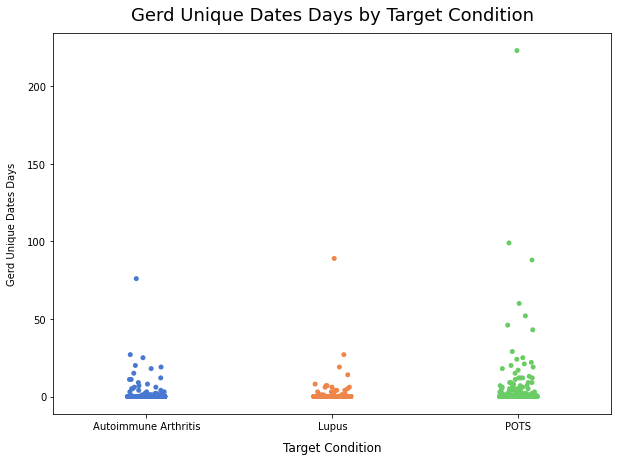

...

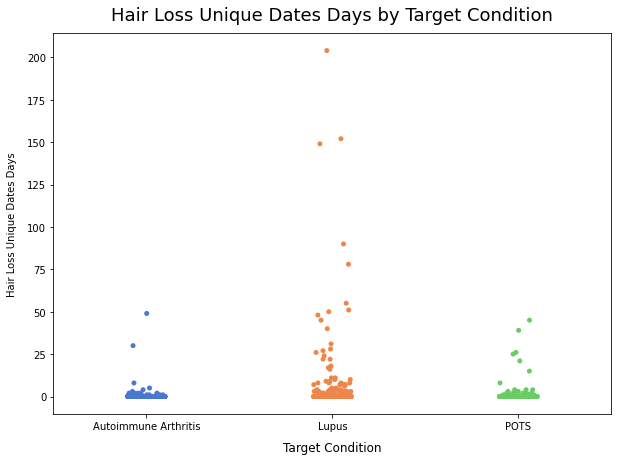

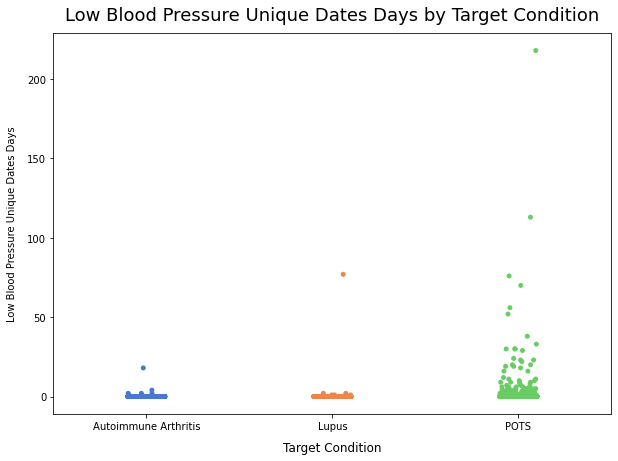

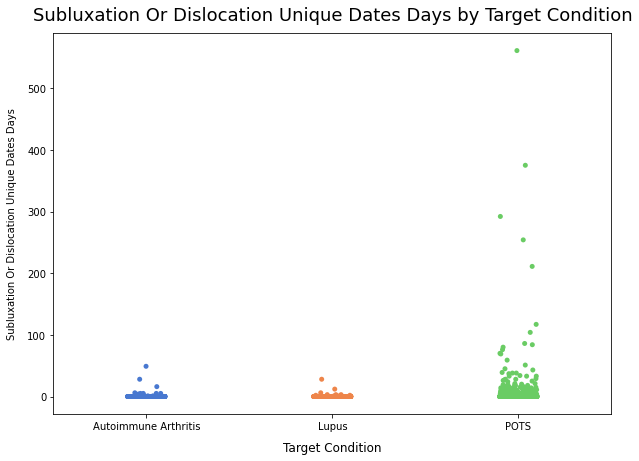

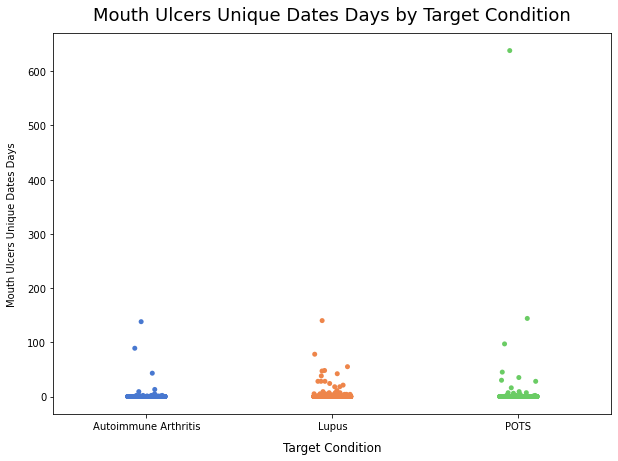

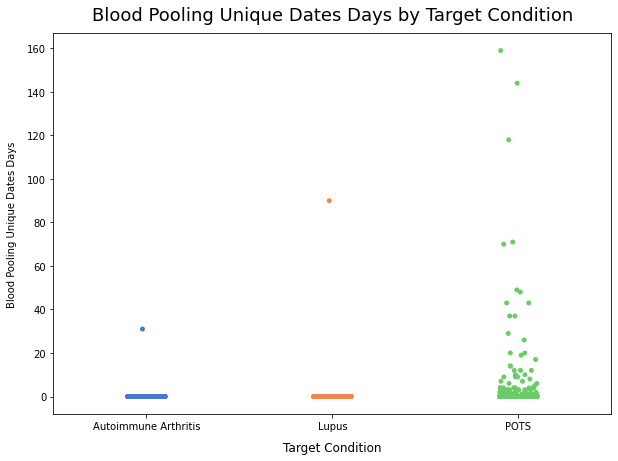

In [78]:
for col in days_list2:

    title = col.replace("_", " ").title()

    plt.figure(figsize=(10,7))
    sns.stripplot(data=df_multi_plot_other, x='Target Condition', y=col, palette='muted')
    plt.ylabel(f"{title}", size=10, labelpad=10)
    plt.xlabel(f"Target Condition", size=12, labelpad=10)
    # plt.xticks((0,1), labels=["Other", "Fibromyalgia"])
    plt.title(f"{title} by Target Condition", size=18, pad=13)
    plt.show()

**Average**

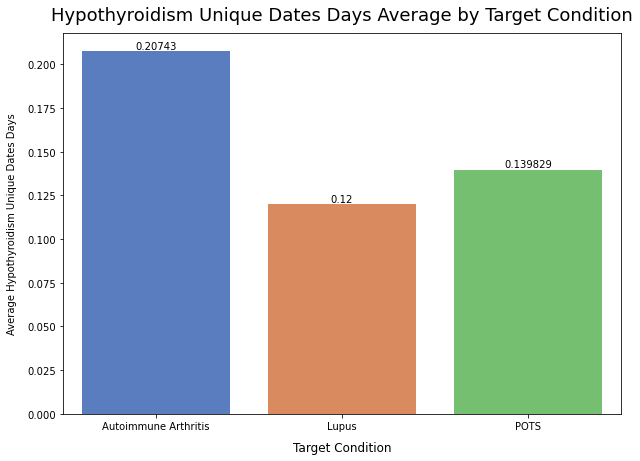

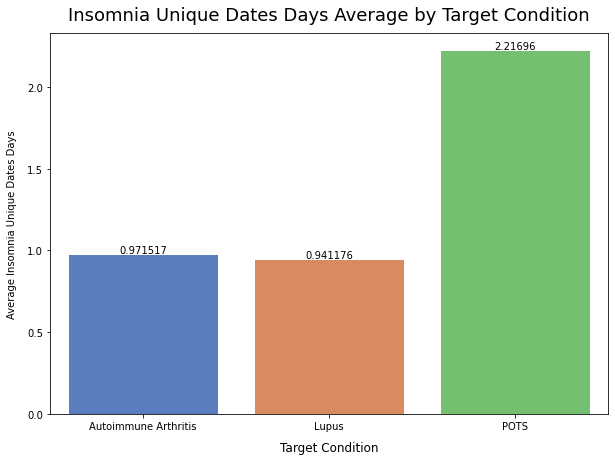

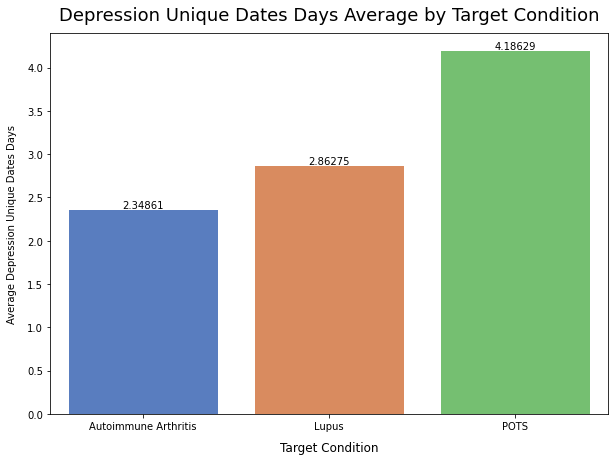

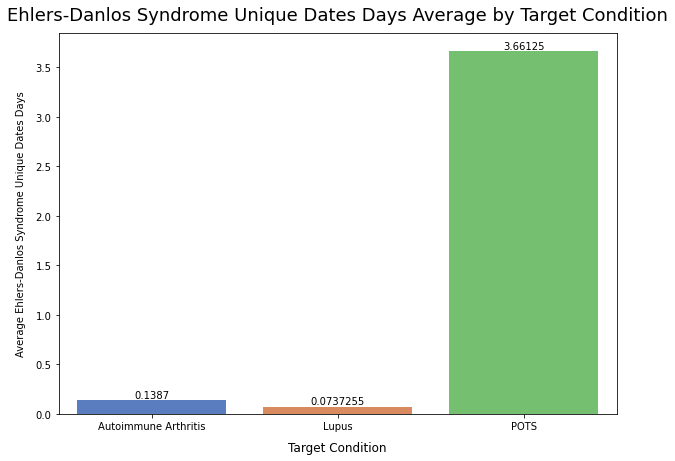

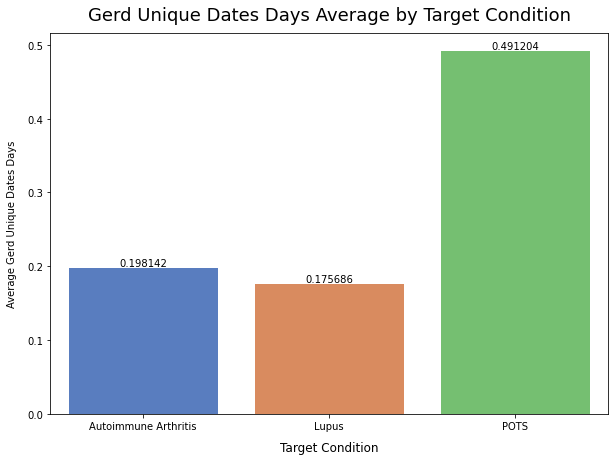

...

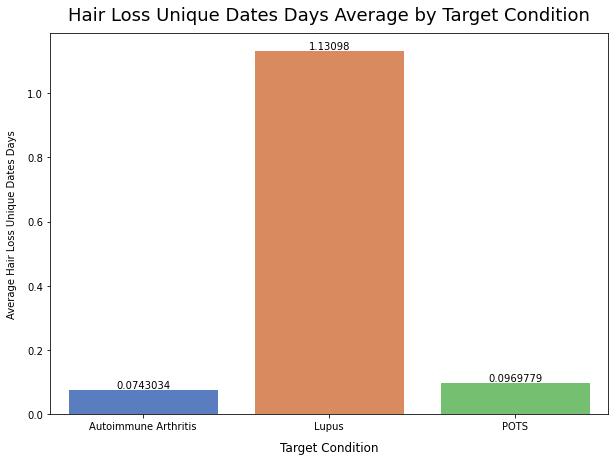

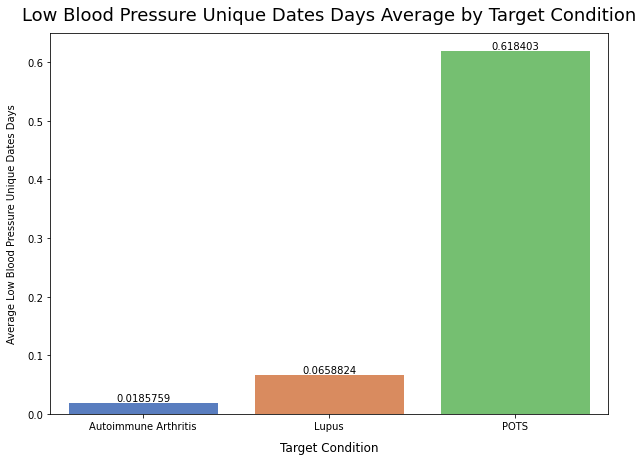

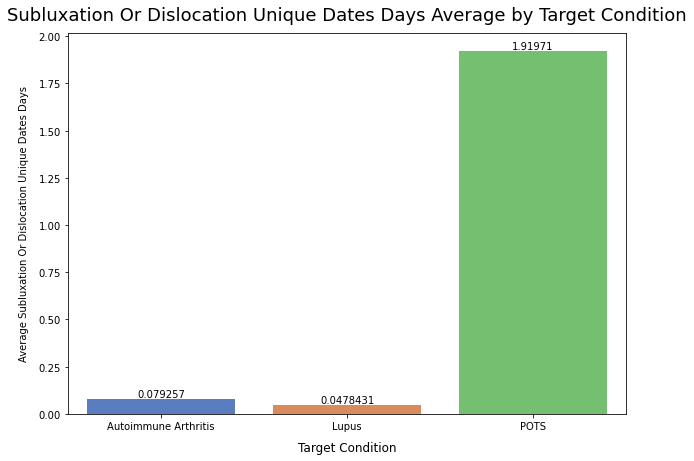

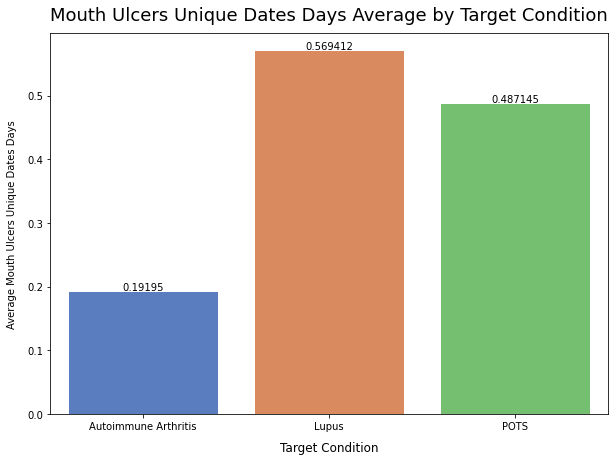

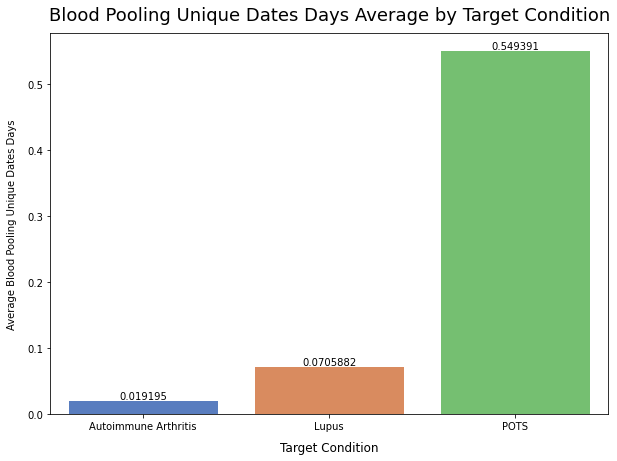

In [79]:
for col in days_list2:

    title = col.replace("_", " ").title()

    plt.figure(figsize=(10,7))
    ax = sns.barplot(data=df_multi_plot_other, x='Target Condition', y=col, palette='muted', ci=None)
    plt.ylabel(f"Average {title}", size=10, labelpad=10)
    plt.xlabel(f"Target Condition", size=12, labelpad=10)
    plt.title(f"{title} Average by Target Condition", size=18, pad=13)
    for container in ax.containers:
        ax.bar_label(container)
    plt.show()

Ehlers Danlos is super predictive of POTS, Psoraisis of Autotimmune Arthritis

### v. Logging Rate<a class="anchor" id="second-bullet9v"></a>

**Stripplot**

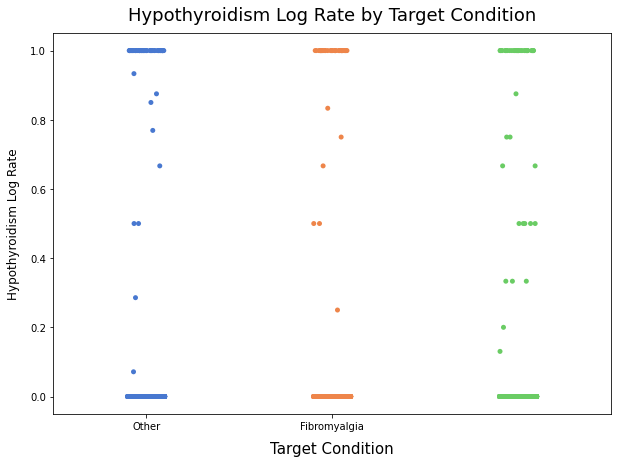

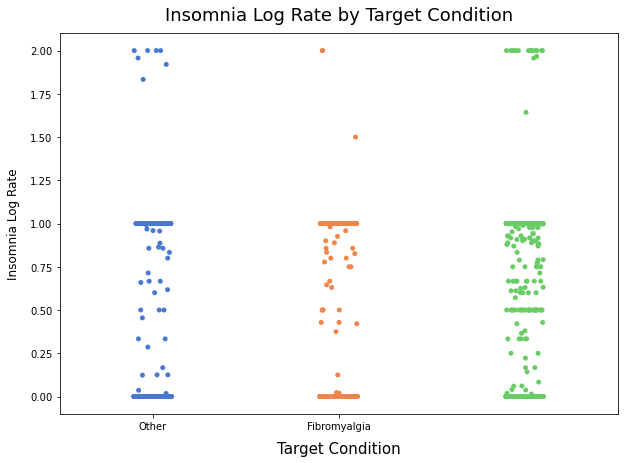

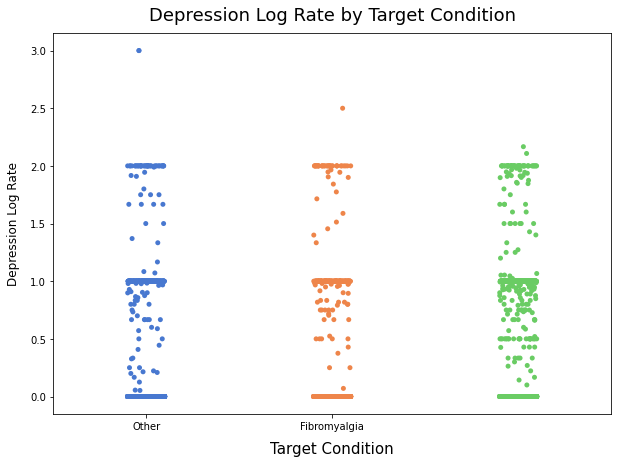

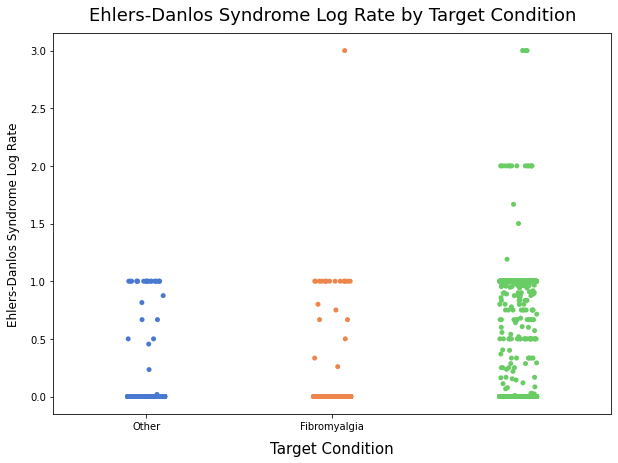

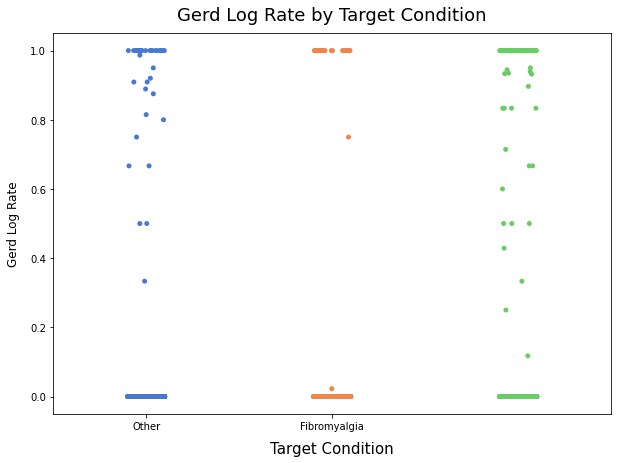

...

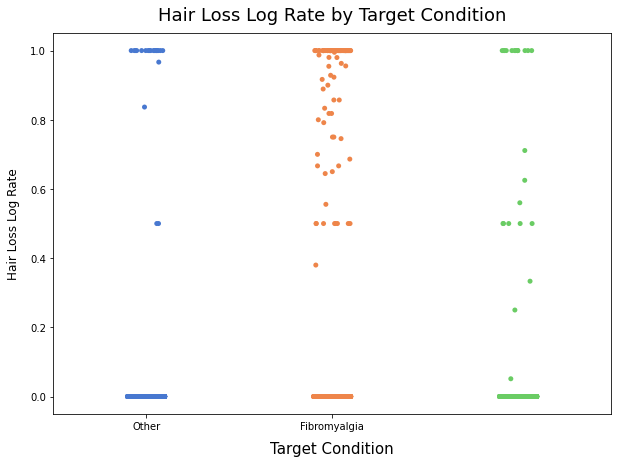

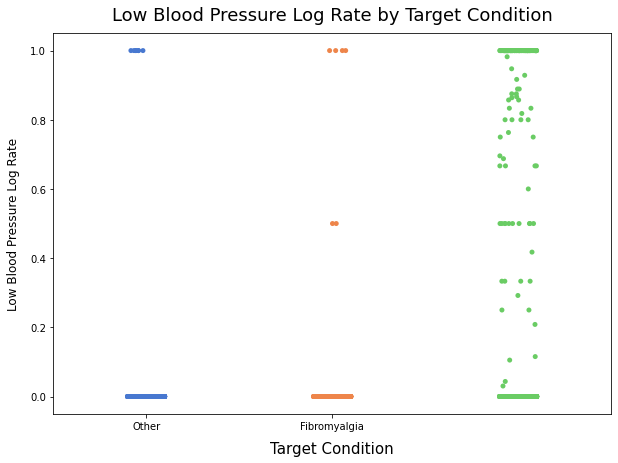

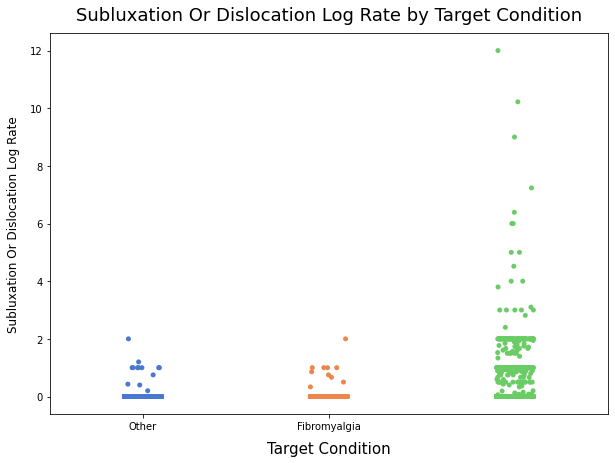

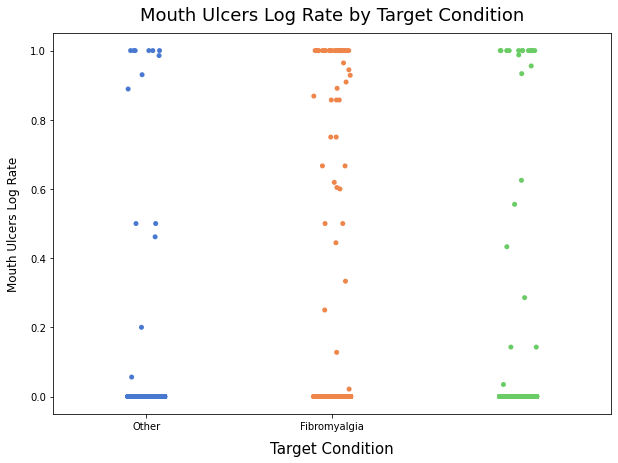

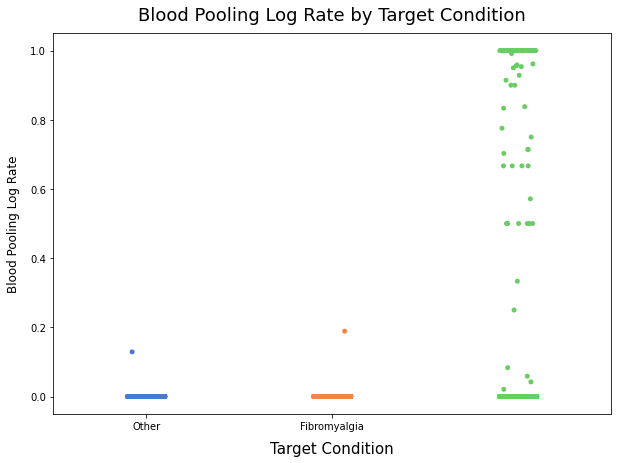

In [80]:
for col in log_rate_list2:

    title = col.replace("_", " ").title()

    plt.figure(figsize=(10,7))
    sns.stripplot(data=df_multi_plot_other, x='Target Condition', y=col, palette='muted')
    plt.ylabel(f"{title}", size=12, labelpad=10)
    plt.xlabel(f"Target Condition", size=15, labelpad=10)
    plt.xticks((0,1), labels=["Other", "Fibromyalgia"])
    plt.title(f"{title} by Target Condition", size=18, pad=13)
    plt.show()

**Average**

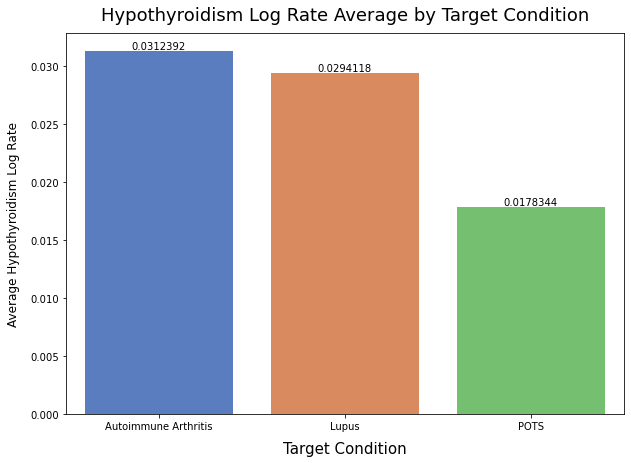

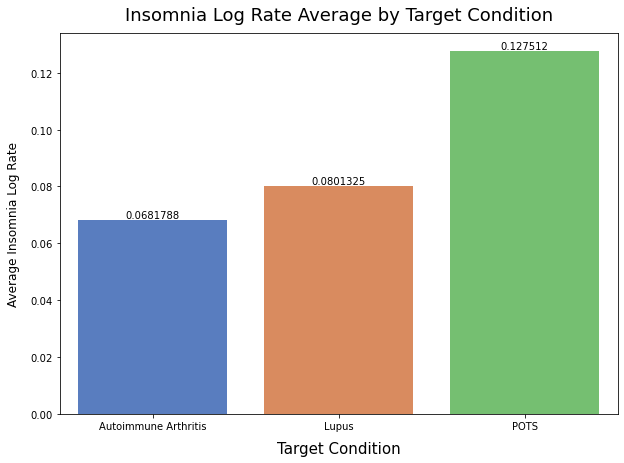

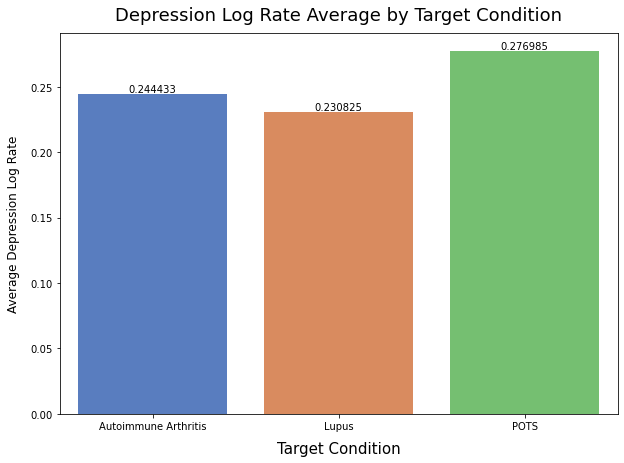

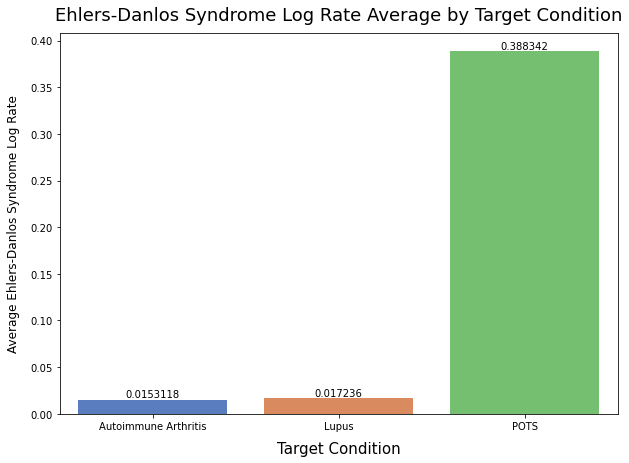

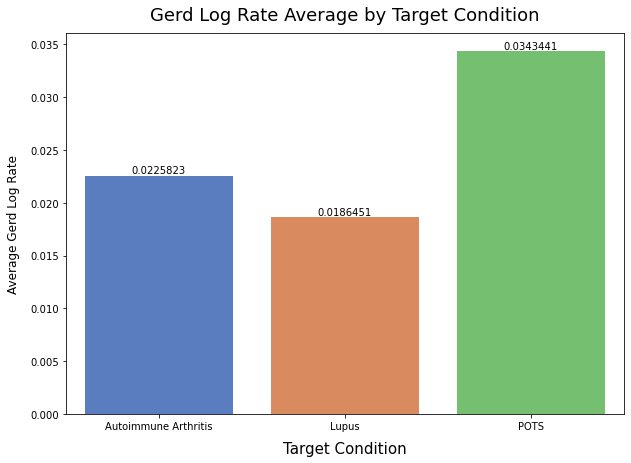

...

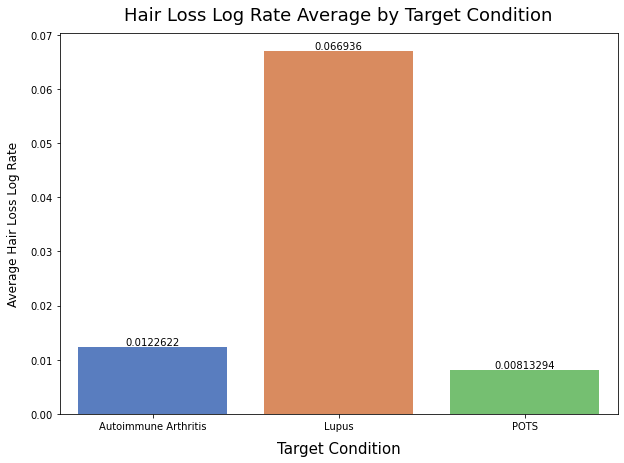

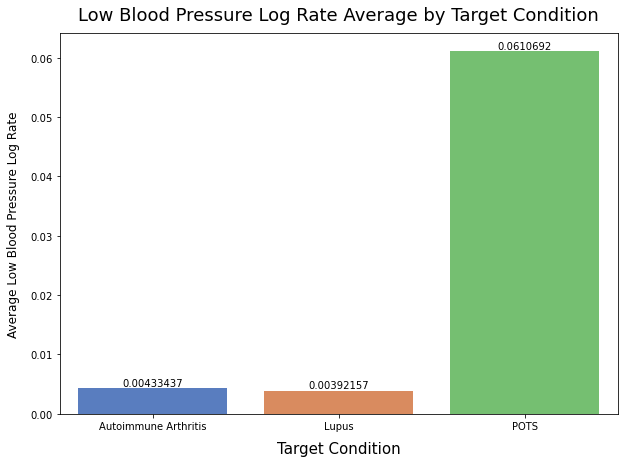

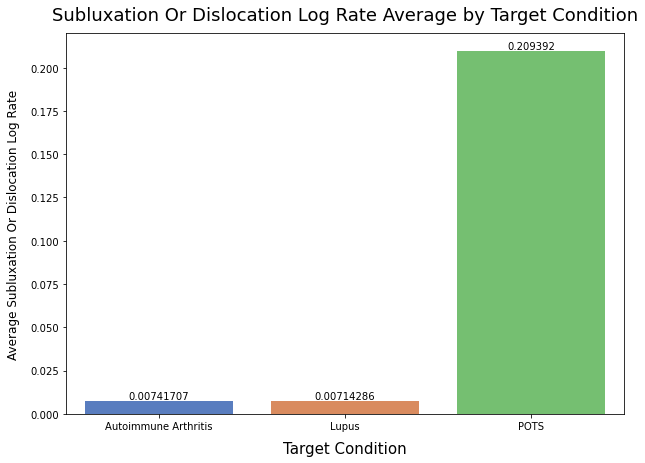

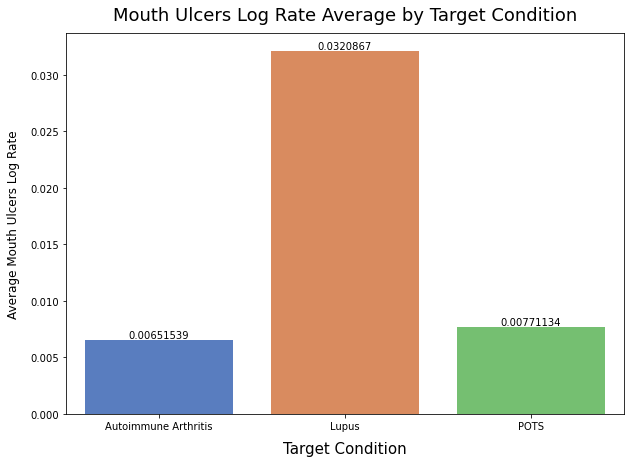

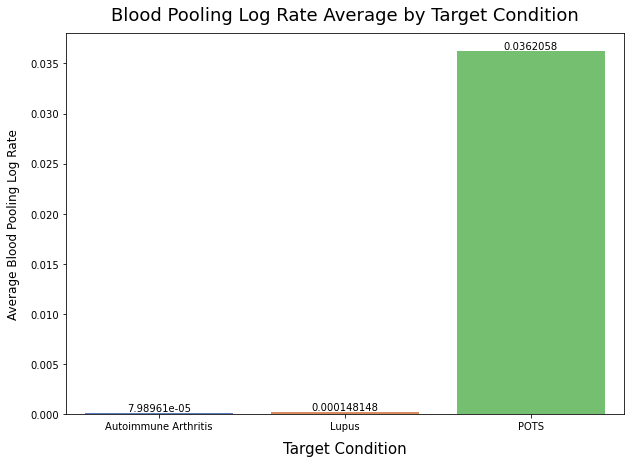

In [81]:
for col in log_rate_list2:

    title = col.replace("_", " ").title()

    plt.figure(figsize=(10,7))
    ax= sns.barplot(data=df_multi_plot_other, x='Target Condition', y=col, palette='muted', ci=None)
    plt.ylabel(f"Average {title}", size=12, labelpad=10)
    plt.xlabel(f"Target Condition", size=15, labelpad=10)
    plt.title(f"{title} Average by Target Condition", size=18, pad=13)
    for container in ax.containers:
        ax.bar_label(container)
    plt.show()

# 4. Summary and Conclusions<a class="anchor" id="third-bullet"></a>

For the binary classification, it appears as if the binary and activity features do a good job of capturing the differences between fibro and nonfibro users. In particular, the variables age, IBS, chronic pain, chronic fatigue syndrome, and muscle pain seem to particularly distinguish fibro users. I therefore predict that these will be predictive of fibromyalgia. Contrastingly, some of the other fibro comorbidities, like anxiety, lupus, and depression don't seem to be particularly predictive of fibromyalgia. I am unsure if this is simply due to their prevalence in the dataset, or if this pool of users is different from the typical fibro patient as discussed by the medical community.

For the multiclassification dataset, it appears as if POTS is fairly distinct--several features are highly predictive of it--like Ehlers Danlos syndrome, and so I expect this feature will be a very important coefficient for POT classification. Similarly, features like psoraisis appear to be highly predictive of Autoimmune arthritis. Aside from this, lupus and arthritis appear to behave similarly accross many features, so I suspect that they will have lower classification metrics than POTS will. Lastly, the binary and activity variable subsets appear to be the most distinct, total logs and unique date dates do not seem to have as much predictive power (it just seems as if there is less data in those features). 